In [2]:
import pdb
import os
import re
import sys
import cv2
import math
import time
import scipy
from scipy import misc
import argparse
import matplotlib
from torch import np
import pylab as plt
from joblib import Parallel, delayed
import util
import torch
import torch as T
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from collections import OrderedDict
from config_reader import config_reader
from scipy.ndimage.filters import gaussian_filter
#parser = argparse.ArgumentParser()
#parser.add_argument('--t7_file', required=True)
#parser.add_argument('--pth_file', required=True)
#args = parser.parse_args()

torch.set_num_threads(torch.get_num_threads())
weight_name = './model/pose_model.pth'

blocks = {}

# find connection in the specified sequence, center 29 is in the position 15
limbSeq = [[2,3], [2,6], [3,4], [4,5], [6,7], [7,8], [2,9], [9,10], \
           [10,11], [2,12], [12,13], [13,14], [2,1], [1,15], [15,17], \
           [1,16], [16,18], [3,17], [6,18]]
           
# the middle joints heatmap correpondence
mapIdx = [[31,32], [39,40], [33,34], [35,36], [41,42], [43,44], [19,20], [21,22], \
          [23,24], [25,26], [27,28], [29,30], [47,48], [49,50], [53,54], [51,52], \
          [55,56], [37,38], [45,46]]
          
# visualize
colors = [[255, 0, 0], [255, 85, 0], [255, 170, 0], [255, 255, 0], [170, 255, 0], [85, 255, 0], [0, 255, 0], \
          [0, 255, 85], [0, 255, 170], [0, 255, 255], [0, 170, 255], [0, 85, 255], [0, 0, 255], [85, 0, 255], \
          [170, 0, 255], [255, 0, 255], [255, 0, 170], [255, 0, 85]]
          
             
block0  = [{'conv1_1':[3,64,3,1,1]},{'conv1_2':[64,64,3,1,1]},{'pool1_stage1':[2,2,0]},{'conv2_1':[64,128,3,1,1]},{'conv2_2':[128,128,3,1,1]},{'pool2_stage1':[2,2,0]},{'conv3_1':[128,256,3,1,1]},{'conv3_2':[256,256,3,1,1]},{'conv3_3':[256,256,3,1,1]},{'conv3_4':[256,256,3,1,1]},{'pool3_stage1':[2,2,0]},{'conv4_1':[256,512,3,1,1]},{'conv4_2':[512,512,3,1,1]},{'conv4_3_CPM':[512,256,3,1,1]},{'conv4_4_CPM':[256,128,3,1,1]}]

blocks['block1_1']  = [{'conv5_1_CPM_L1':[128,128,3,1,1]},{'conv5_2_CPM_L1':[128,128,3,1,1]},{'conv5_3_CPM_L1':[128,128,3,1,1]},{'conv5_4_CPM_L1':[128,512,1,1,0]},{'conv5_5_CPM_L1':[512,38,1,1,0]}]

blocks['block1_2']  = [{'conv5_1_CPM_L2':[128,128,3,1,1]},{'conv5_2_CPM_L2':[128,128,3,1,1]},{'conv5_3_CPM_L2':[128,128,3,1,1]},{'conv5_4_CPM_L2':[128,512,1,1,0]},{'conv5_5_CPM_L2':[512,19,1,1,0]}]

for i in range(2,7):
    blocks['block%d_1'%i]  = [{'Mconv1_stage%d_L1'%i:[185,128,7,1,3]},{'Mconv2_stage%d_L1'%i:[128,128,7,1,3]},{'Mconv3_stage%d_L1'%i:[128,128,7,1,3]},{'Mconv4_stage%d_L1'%i:[128,128,7,1,3]},
{'Mconv5_stage%d_L1'%i:[128,128,7,1,3]},{'Mconv6_stage%d_L1'%i:[128,128,1,1,0]},{'Mconv7_stage%d_L1'%i:[128,38,1,1,0]}]
    blocks['block%d_2'%i]  = [{'Mconv1_stage%d_L2'%i:[185,128,7,1,3]},{'Mconv2_stage%d_L2'%i:[128,128,7,1,3]},{'Mconv3_stage%d_L2'%i:[128,128,7,1,3]},{'Mconv4_stage%d_L2'%i:[128,128,7,1,3]},
{'Mconv5_stage%d_L2'%i:[128,128,7,1,3]},{'Mconv6_stage%d_L2'%i:[128,128,1,1,0]},{'Mconv7_stage%d_L2'%i:[128,19,1,1,0]}]

def make_layers(cfg_dict):
    layers = []
    for i in range(len(cfg_dict)-1):
        one_ = cfg_dict[i]
        for k,v in one_.iteritems():      
            if 'pool' in k:
                layers += [nn.MaxPool2d(kernel_size=v[0], stride=v[1], padding=v[2] )]
            else:
                conv2d = nn.Conv2d(in_channels=v[0], out_channels=v[1], kernel_size=v[2], stride = v[3], padding=v[4])
                layers += [conv2d, nn.ReLU(inplace=True)]
    one_ = cfg_dict[-1].keys()
    k = one_[0]
    v = cfg_dict[-1][k]
    conv2d = nn.Conv2d(in_channels=v[0], out_channels=v[1], kernel_size=v[2], stride = v[3], padding=v[4])
    layers += [conv2d]
    return nn.Sequential(*layers)
    
layers = []
for i in range(len(block0)):
    one_ = block0[i]
    for k,v in one_.iteritems():      
        if 'pool' in k:
            layers += [nn.MaxPool2d(kernel_size=v[0], stride=v[1], padding=v[2] )]
        else:
            conv2d = nn.Conv2d(in_channels=v[0], out_channels=v[1], kernel_size=v[2], stride = v[3], padding=v[4])
            layers += [conv2d, nn.ReLU(inplace=True)]  
       
models = {} 

models['block0']=nn.Sequential(*layers)        

for k,v in blocks.iteritems():
    models[k] = make_layers(v)
                
class pose_model(nn.Module):
    def __init__(self,model_dict,transform_input=False):
        super(pose_model, self).__init__()
        self.model0   = model_dict['block0']
        self.model1_1 = model_dict['block1_1']        
        self.model2_1 = model_dict['block2_1']  
        self.model3_1 = model_dict['block3_1']  
        self.model4_1 = model_dict['block4_1']  
        self.model5_1 = model_dict['block5_1']  
        self.model6_1 = model_dict['block6_1']  
        
        self.model1_2 = model_dict['block1_2']        
        self.model2_2 = model_dict['block2_2']  
        self.model3_2 = model_dict['block3_2']  
        self.model4_2 = model_dict['block4_2']  
        self.model5_2 = model_dict['block5_2']  
        self.model6_2 = model_dict['block6_2']
        
    def forward(self, x):    
        out1 = self.model0(x)
        
        out1_1 = self.model1_1(out1)
        out1_2 = self.model1_2(out1)
        out2  = torch.cat([out1_1,out1_2,out1],1)
        
        out2_1 = self.model2_1(out2)
        out2_2 = self.model2_2(out2)
        out3   = torch.cat([out2_1,out2_2,out1],1)
        
        out3_1 = self.model3_1(out3)
        out3_2 = self.model3_2(out3)
        out4   = torch.cat([out3_1,out3_2,out1],1)

        out4_1 = self.model4_1(out4)
        out4_2 = self.model4_2(out4)
        out5   = torch.cat([out4_1,out4_2,out1],1)  
        
        out5_1 = self.model5_1(out5)
        out5_2 = self.model5_2(out5)
        out6   = torch.cat([out5_1,out5_2,out1],1)         
              
        out6_1 = self.model6_1(out6)
        out6_2 = self.model6_2(out6)
        
        return out6_1,out6_2        




In [3]:
model = pose_model(models)     
model.load_state_dict(torch.load(weight_name))
model.cuda()
model.float()
model.eval()

pose_model (
  (model0): Sequential (
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU (inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU (inplace)
    (4): MaxPool2d (size=(2, 2), stride=(2, 2), dilation=(1, 1))
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU (inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU (inplace)
    (9): MaxPool2d (size=(2, 2), stride=(2, 2), dilation=(1, 1))
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU (inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU (inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU (inplace)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (17): ReLU (inplace)
    (18): MaxPool2d (s

In [4]:

param_, model_ = config_reader()

#torch.nn.functional.pad(img pad, mode='constant', value=model_['padValue'])

def getMaskandHeat(ImgPath):
    test_image = ImgPath
    #test_image = 'a.jpg'
    oriImg = cv2.imread(test_image) # B,G,R order
    imageToTest = Variable(T.transpose(T.transpose(T.unsqueeze(torch.from_numpy(oriImg).float(),0),2,3),1,2),volatile=True).cuda()

    multiplier = [x * model_['boxsize'] / oriImg.shape[0] for x in param_['scale_search']]
    
    heatmap_avg = torch.zeros((len(multiplier),19,oriImg.shape[0], oriImg.shape[1])).cuda()
    paf_avg = torch.zeros((len(multiplier),38,oriImg.shape[0], oriImg.shape[1])).cuda()
    #print heatmap_avg.size()




    for m in range(len(multiplier)):
        scale = multiplier[m]
        h = int(oriImg.shape[0]*scale)
        w = int(oriImg.shape[1]*scale)
        pad_h = 0 if (h%model_['stride']==0) else model_['stride'] - (h % model_['stride']) 
        pad_w = 0 if (w%model_['stride']==0) else model_['stride'] - (w % model_['stride'])
        new_h = h+pad_h
        new_w = w+pad_w

        imageToTest = cv2.resize(oriImg, (0,0), fx=scale, fy=scale, interpolation=cv2.INTER_CUBIC)
        imageToTest_padded, pad = util.padRightDownCorner(imageToTest, model_['stride'], model_['padValue'])
        imageToTest_padded = np.transpose(np.float32(imageToTest_padded[:,:,:,np.newaxis]), (3,2,0,1))/256 - 0.5

        feed = Variable(T.from_numpy(imageToTest_padded)).cuda()      
        output1,output2 = model(feed)
        #print output1.size()
        #print output2.size()
        heatmap = nn.UpsamplingBilinear2d((oriImg.shape[0], oriImg.shape[1])).cuda()(output2)

        paf = nn.UpsamplingBilinear2d((oriImg.shape[0], oriImg.shape[1])).cuda()(output1)       

        heatmap_avg[m] = heatmap[0].data
        paf_avg[m] = paf[0].data  

    heatmap_avg = T.transpose(T.transpose(T.squeeze(T.mean(heatmap_avg, 0)),0,1),1,2).cuda() 
    paf_avg     = T.transpose(T.transpose(T.squeeze(T.mean(paf_avg, 0)),0,1),1,2).cuda() 
    heatmap_avg=heatmap_avg.cpu().numpy()
    paf_avg    = paf_avg.cpu().numpy()

    all_peaks = []
    peak_counter = 0

    #maps = 
    for part in range(18):
        map_ori = heatmap_avg[:,:,part]
        map = gaussian_filter(map_ori, sigma=3)

        map_left = np.zeros(map.shape)
        map_left[1:,:] = map[:-1,:]
        map_right = np.zeros(map.shape)
        map_right[:-1,:] = map[1:,:]
        map_up = np.zeros(map.shape)
        map_up[:,1:] = map[:,:-1]
        map_down = np.zeros(map.shape)
        map_down[:,:-1] = map[:,1:]

        peaks_binary = np.logical_and.reduce((map>=map_left, map>=map_right, map>=map_up, map>=map_down, map > param_['thre1']))
    #    peaks_binary = T.eq(
    #    peaks = zip(T.nonzero(peaks_binary)[0],T.nonzero(peaks_binary)[0])

        peaks = zip(np.nonzero(peaks_binary)[1], np.nonzero(peaks_binary)[0]) # note reverse

        peaks_with_score = [x + (map_ori[x[1],x[0]],) for x in peaks]
        id = range(peak_counter, peak_counter + len(peaks))
        peaks_with_score_and_id = [peaks_with_score[i] + (id[i],) for i in range(len(id))]
        #pdb.set_trace()
        all_peaks.append(peaks_with_score_and_id)
        peak_counter += len(peaks)

    connection_all = []
    special_k = []
    mid_num = 10

    for k in range(len(mapIdx)):
        score_mid = paf_avg[:,:,[x-19 for x in mapIdx[k]]]
        candA = all_peaks[limbSeq[k][0]-1]
        candB = all_peaks[limbSeq[k][1]-1]
        nA = len(candA)
        nB = len(candB)
        indexA, indexB = limbSeq[k]
        if(nA != 0 and nB != 0):
            connection_candidate = []
            for i in range(nA):
                for j in range(nB):
                    vec = np.subtract(candB[j][:2], candA[i][:2])
                    norm = math.sqrt(vec[0]*vec[0] + vec[1]*vec[1]) +1e-5
                    vec = np.divide(vec, norm)

                    startend = zip(np.linspace(candA[i][0], candB[j][0], num=mid_num), \
                                   np.linspace(candA[i][1], candB[j][1], num=mid_num))

                    vec_x = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 0] \
                                      for I in range(len(startend))])
                    vec_y = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 1] \
                                      for I in range(len(startend))])

                    score_midpts = np.multiply(vec_x, vec[0]) + np.multiply(vec_y, vec[1])
                    score_with_dist_prior = sum(score_midpts)/len(score_midpts) + min(0.5*oriImg.shape[0]/norm-1, 0)
                    criterion1 = len(np.nonzero(score_midpts > param_['thre2'])[0]) > 0.8 * len(score_midpts)
                    criterion2 = score_with_dist_prior > 0
                    if criterion1 and criterion2:
                        connection_candidate.append([i, j, score_with_dist_prior, score_with_dist_prior+candA[i][2]+candB[j][2]])

            connection_candidate = sorted(connection_candidate, key=lambda x: x[2], reverse=True)
            connection = np.zeros((0,5))
            for c in range(len(connection_candidate)):
                i,j,s = connection_candidate[c][0:3]
                if(i not in connection[:,3] and j not in connection[:,4]):
                    connection = np.vstack([connection, [candA[i][3], candB[j][3], s, i, j]])
                    if(len(connection) >= min(nA, nB)):
                        break

            connection_all.append(connection)
        else:
            special_k.append(k)
            connection_all.append([])

    # last number in each row is the total parts number of that person
    # the second last number in each row is the score of the overall configuration
    subset = -1 * np.ones((0, 20))
    candidate = np.array([item for sublist in all_peaks for item in sublist])

    for k in range(len(mapIdx)):
        if k not in special_k:
            partAs = connection_all[k][:,0]
            partBs = connection_all[k][:,1]
            indexA, indexB = np.array(limbSeq[k]) - 1

            for i in range(len(connection_all[k])): #= 1:size(temp,1)
                found = 0
                subset_idx = [-1, -1]
                for j in range(len(subset)): #1:size(subset,1):
                    if subset[j][indexA] == partAs[i] or subset[j][indexB] == partBs[i]:
                        subset_idx[found] = j
                        found += 1

                if found == 1:
                    j = subset_idx[0]
                    if(subset[j][indexB] != partBs[i]):
                        subset[j][indexB] = partBs[i]
                        subset[j][-1] += 1
                        subset[j][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]
                elif found == 2: # if found 2 and disjoint, merge them
                    j1, j2 = subset_idx
                    #print "found = 2"
                    membership = ((subset[j1]>=0).astype(int) + (subset[j2]>=0).astype(int))[:-2]
                    if len(np.nonzero(membership == 2)[0]) == 0: #merge
                        subset[j1][:-2] += (subset[j2][:-2] + 1)
                        subset[j1][-2:] += subset[j2][-2:]
                        subset[j1][-2] += connection_all[k][i][2]
                        subset = np.delete(subset, j2, 0)
                    else: # as like found == 1
                        subset[j1][indexB] = partBs[i]
                        subset[j1][-1] += 1
                        subset[j1][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]

                # if find no partA in the subset, create a new subset
                elif not found and k < 17:
                    row = -1 * np.ones(20)
                    row[indexA] = partAs[i]
                    row[indexB] = partBs[i]
                    row[-1] = 2
                    row[-2] = sum(candidate[connection_all[k][i,:2].astype(int), 2]) + connection_all[k][i][2]
                    subset = np.vstack([subset, row])

    # delete some rows of subset which has few parts occur
    deleteIdx = [];
    for i in range(len(subset)):
        if subset[i][-1] < 4 or subset[i][-2]/subset[i][-1] < 0.4:
            deleteIdx.append(i)
    subset = np.delete(subset, deleteIdx, axis=0)
    
    return all_peaks,heatmap_avg,subset,candidate




import matplotlib.pyplot as plt
from numpy import unravel_index


Img = './sample_image/lena_his.jpg'
all_peaks,heatMap,subset,candidate = getMaskandHeat(Img)#heatmap=(128,64,19)
print(all_peaks)
for i in range(18):
    map = gaussian_filter(heatMap[:,:,i], sigma=3)
    print(unravel_index(map.argmax(), map.shape))
#heatmap last one is concat all front

for i in range(19):
    plt.imshow(heatMap[:,:,i])
    plt.show()
    

#plt.imshow(heatMap[:,:,0])

0001


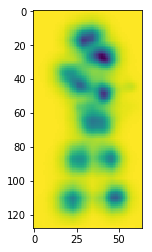

0002


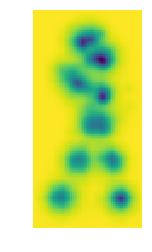

0003


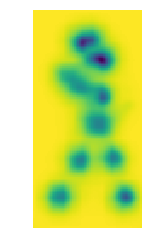

0004


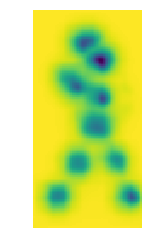

0005


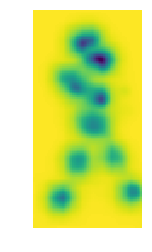

0006


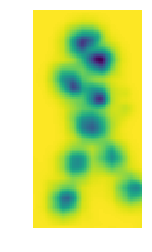

0007


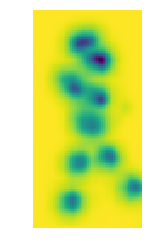

0008


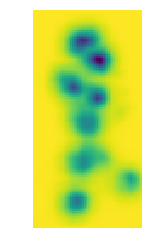

0009


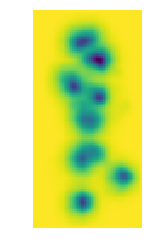

0010


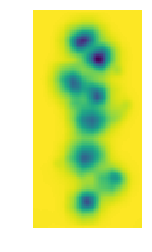

0011


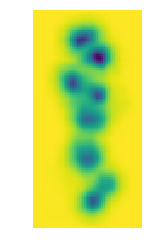

0012


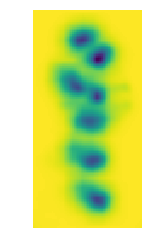

0013


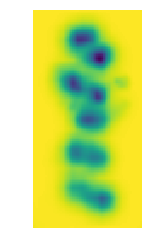

0014


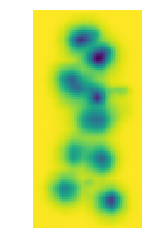

0015


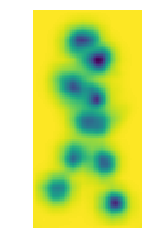

0016


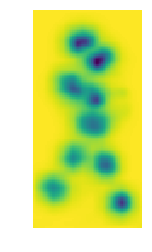

0017


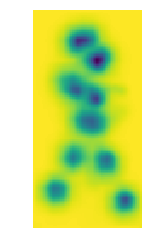

0018


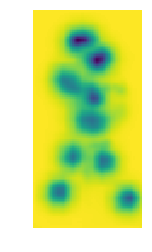

0019


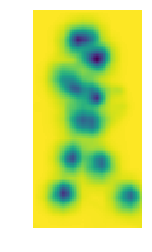

0020


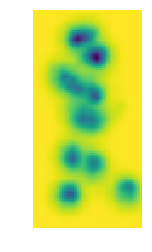

0021


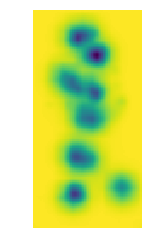

0022


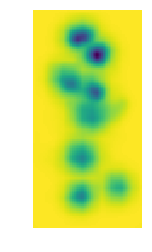

0023


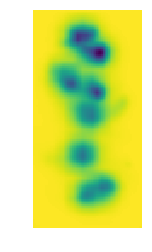

0024


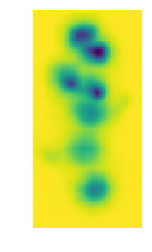

0025


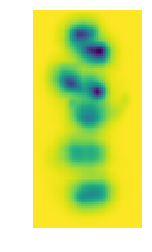

0026


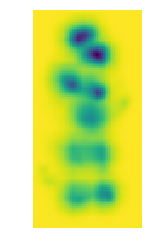

0027


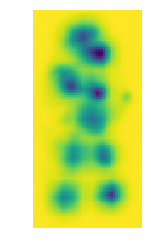

0028


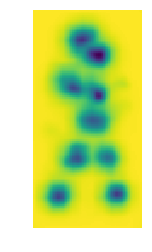

0029


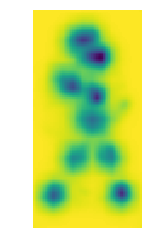

0030


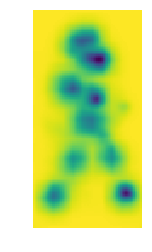

0031


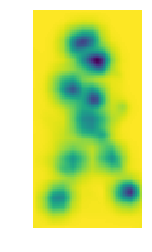

0032


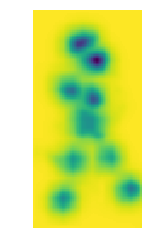

0033


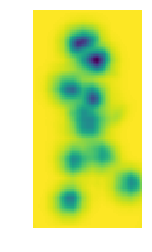

0034


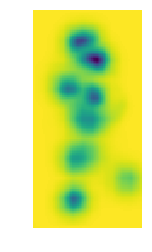

0035


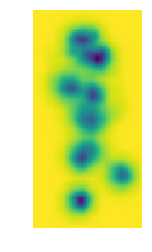

0036


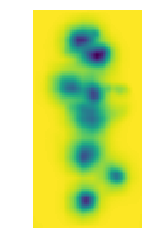

0037


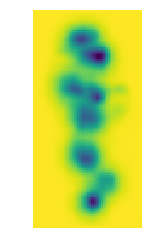

0038


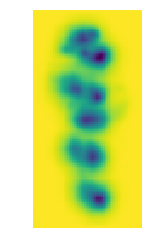

0039


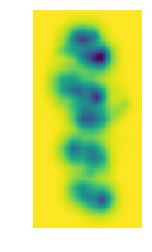

0040


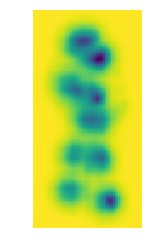

0041


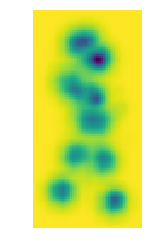

0042


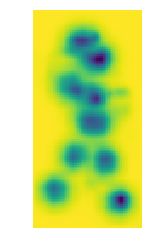

0043


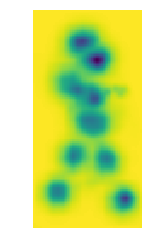

0044


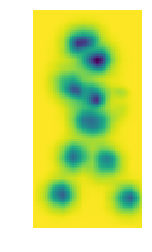

0045


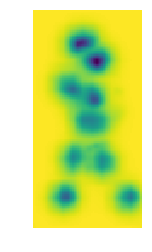

0046


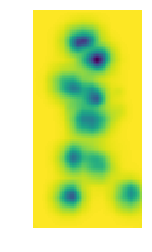

0047


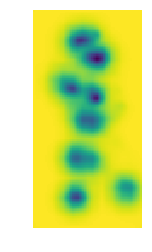

0048


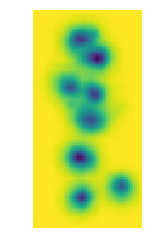

0049


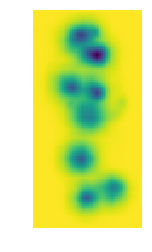

0050


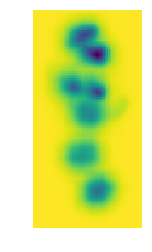

0051


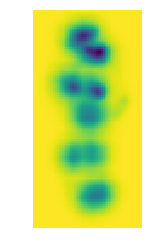

0052


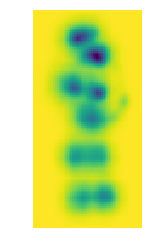

0053


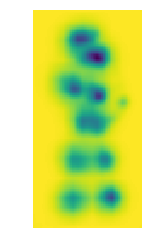

0054


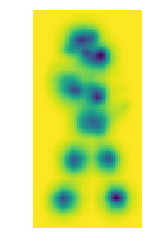

0055


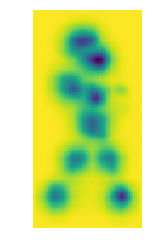

0056


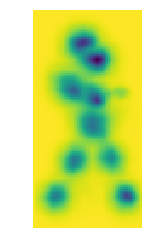

0057


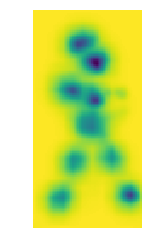

0058


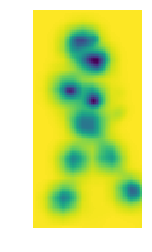

0059


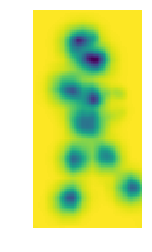

0060


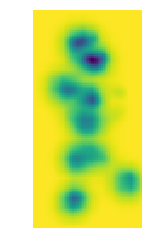

0061


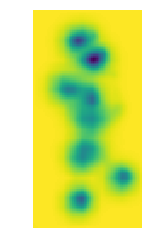

0062


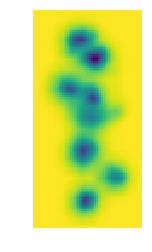

0063


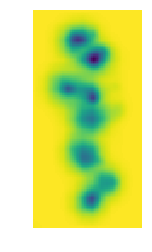

0064


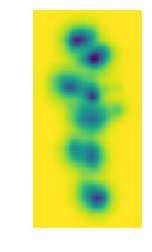

0065


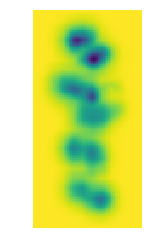

0066


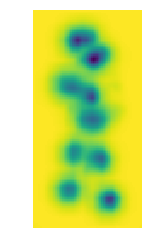

0067


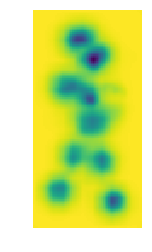

0068


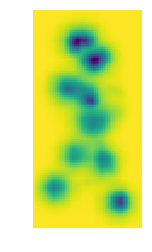

0069


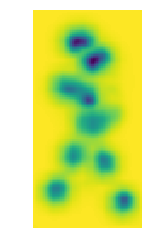

0070


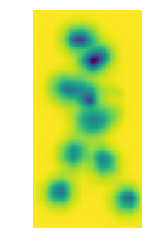

0071


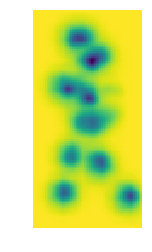

0072


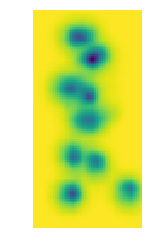

0073


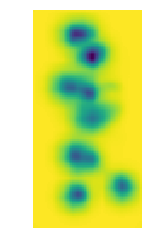

0074


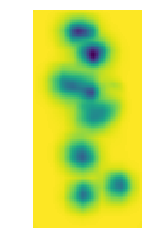

0075


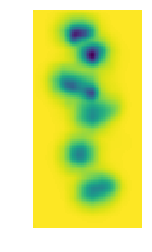

0076


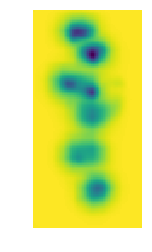

0077


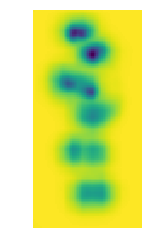

0078


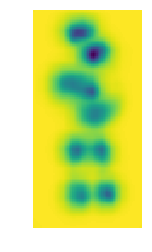

0079


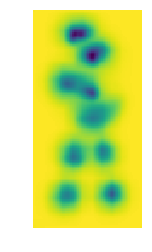

0080


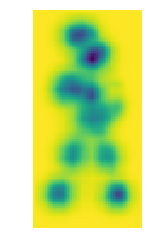

0081


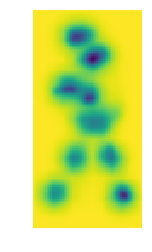

0082


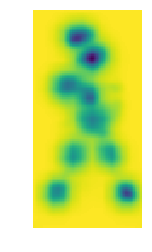

0083


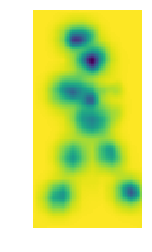

0084


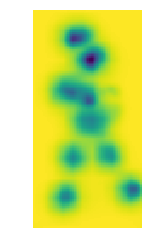

0085


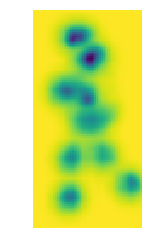

0086


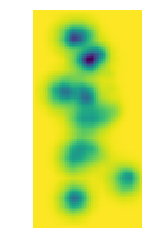

0087


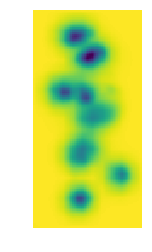

0088


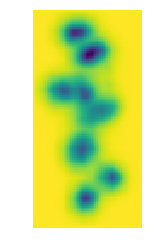

0089


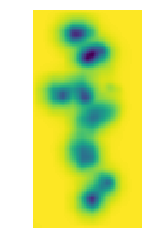

0090


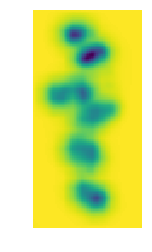

0091


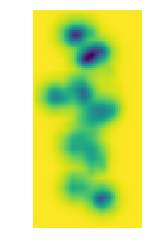

0092


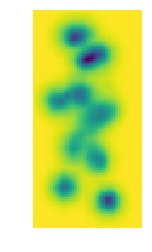

0093


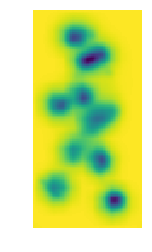

0094


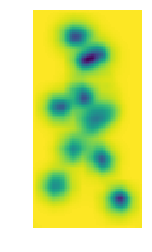

0095


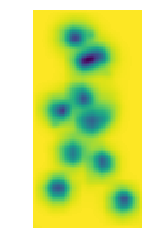

0096


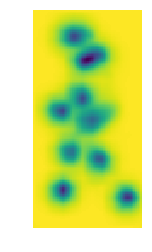

0097


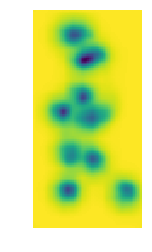

0098


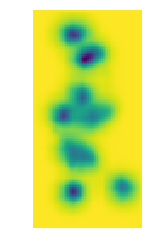

0099


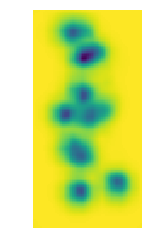

0100


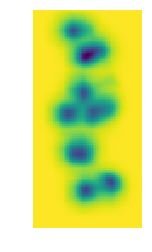

0101


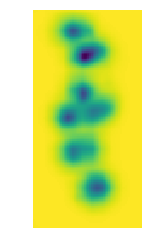

0102


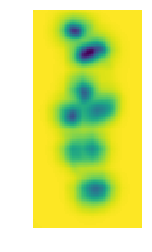

0103


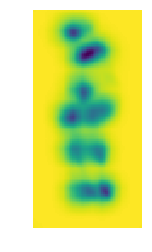

0104


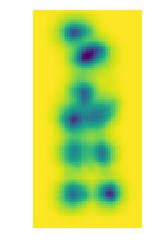

0105


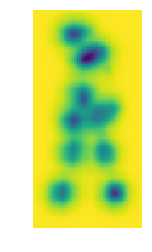

0106


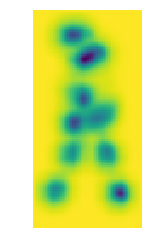

0107


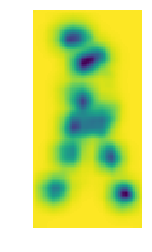

0108


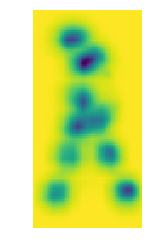

0109


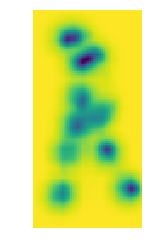

0110


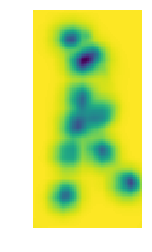

0111


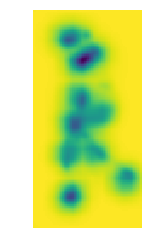

0112


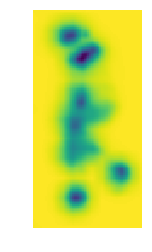

0113


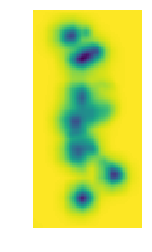

0114


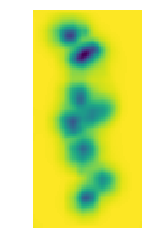

0115


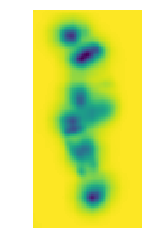

0116


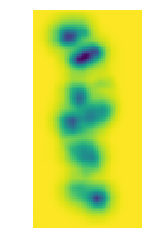

0117


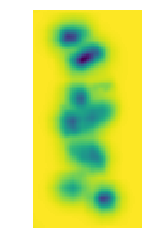

0118


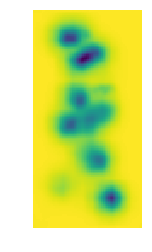

0119


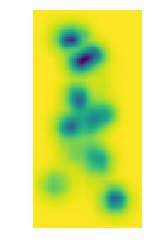

0120


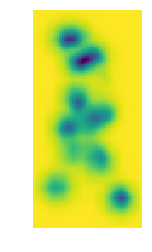

0121


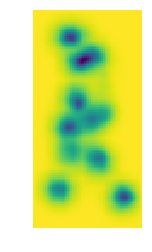

0122


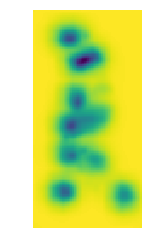

0123


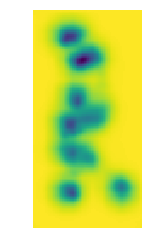

0124


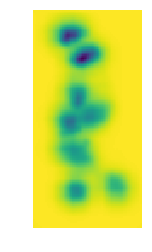

0125


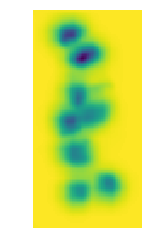

0126


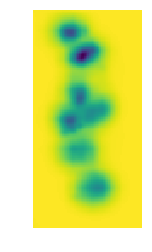

0127


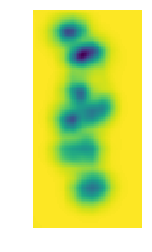

0128


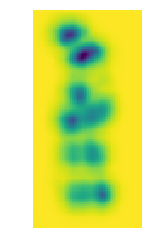

0129


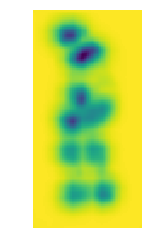

0130


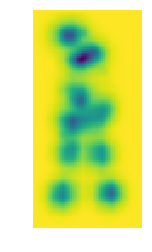

0131


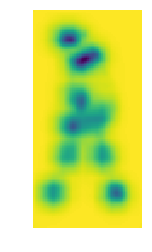

0132


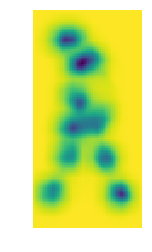

0133


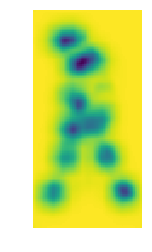

0134


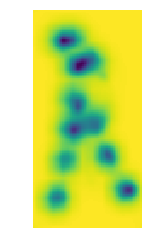

0135


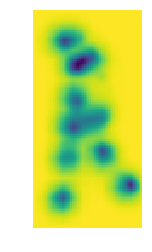

0136


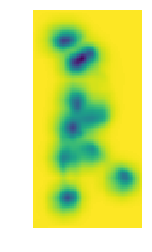

0137


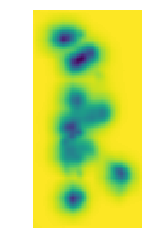

0138


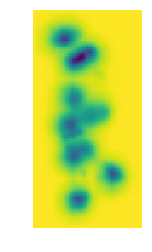

0139


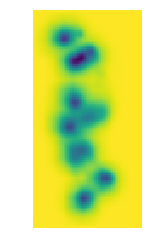

0140


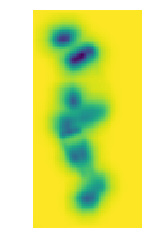

0141


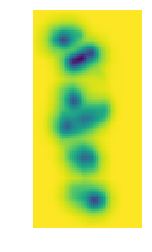

0142


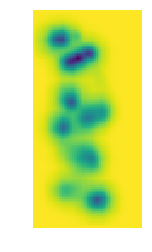

0143


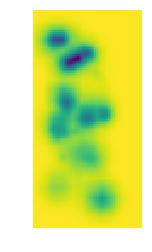

0144


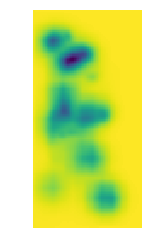

0145


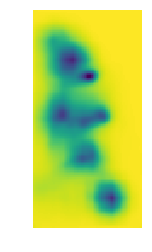

0146


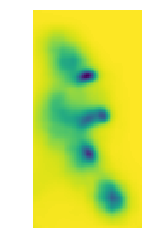

0147


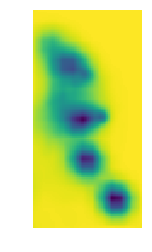

0001


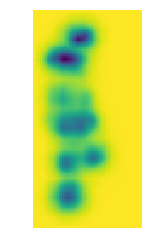

0002


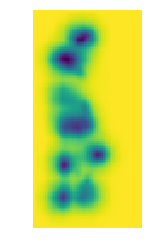

0003


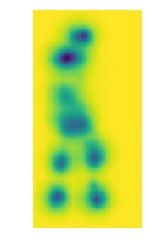

0004


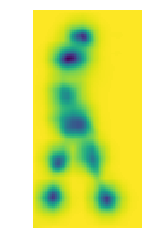

0005


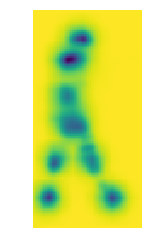

0006


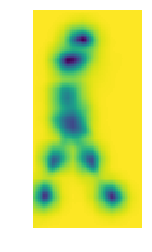

0007


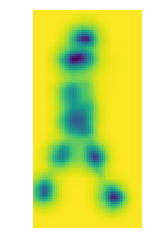

0008


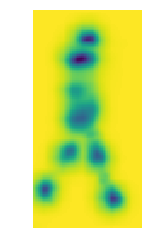

0009


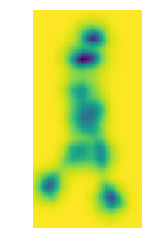

0010


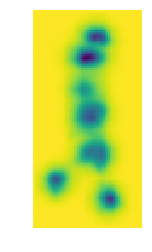

0011


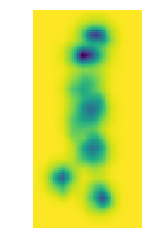

0012


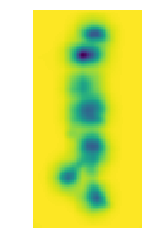

0013


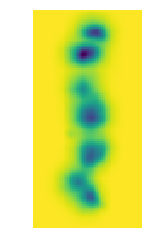

0014


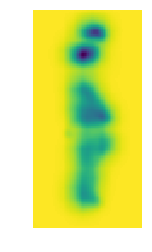

0015


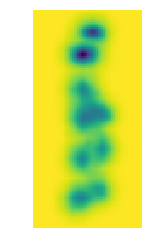

0016


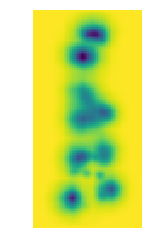

0017


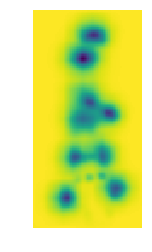

0018


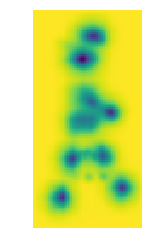

0019


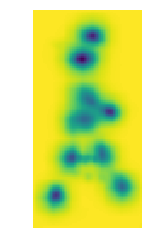

0020


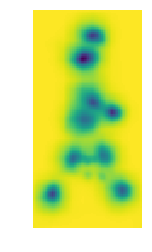

0021


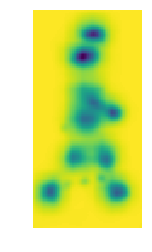

0022


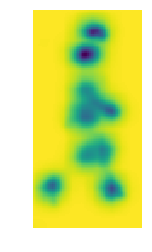

0023


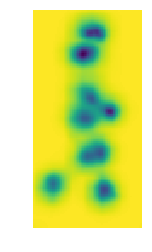

0024


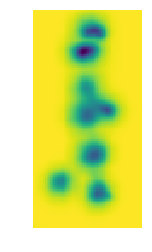

0025


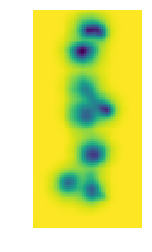

0026


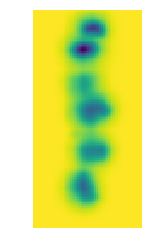

0027


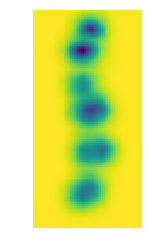

0028


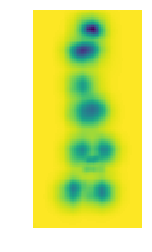

0029


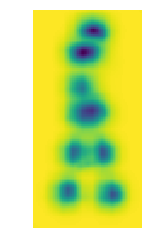

0030


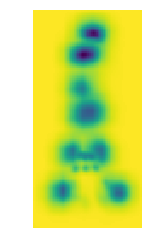

0031


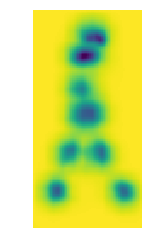

0032


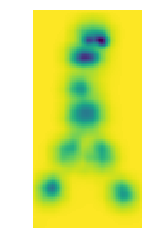

0033


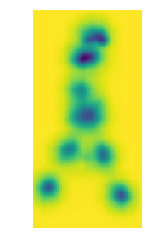

0034


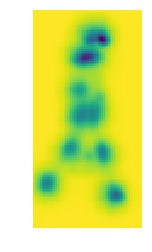

0035


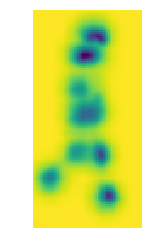

0036


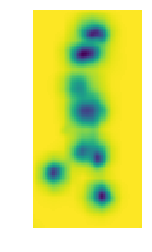

0037


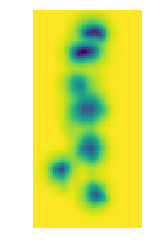

0038


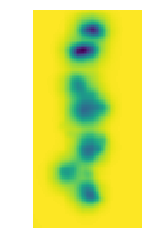

0039


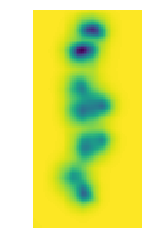

0040


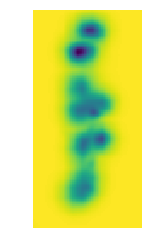

0041


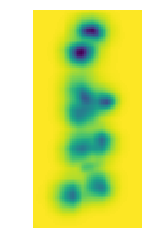

0042


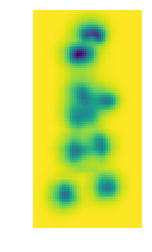

0043


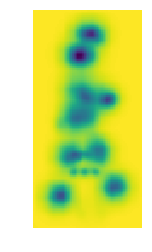

0044


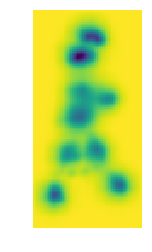

0045


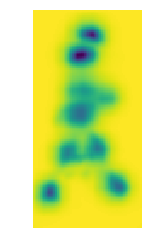

0046


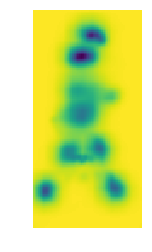

0047


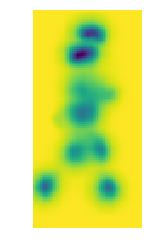

0048


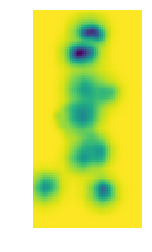

0049


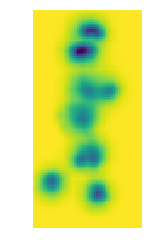

0050


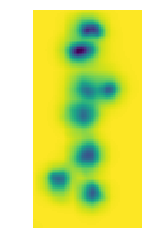

0051


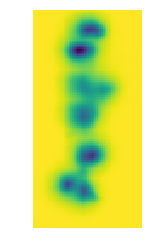

0052


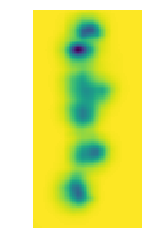

0053


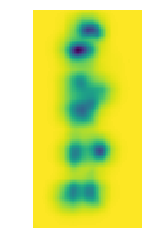

0054


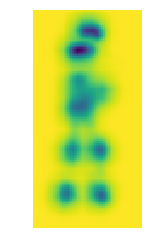

0055


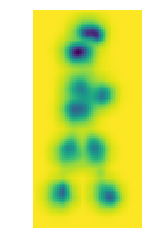

0056


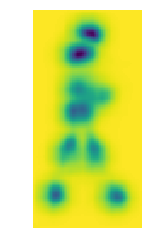

0057


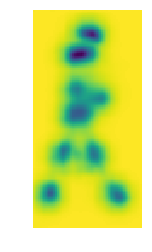

0058


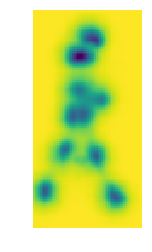

0059


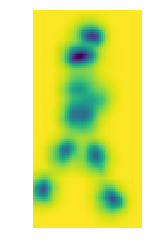

0060


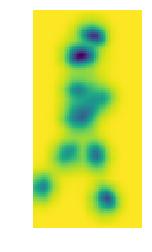

0061


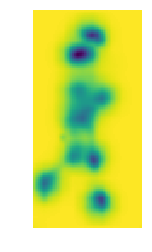

0062


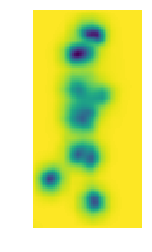

0063


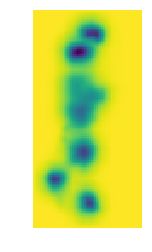

0064


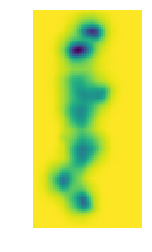

0065


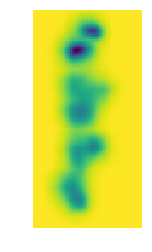

0066


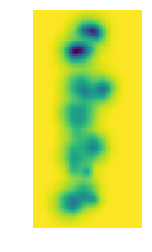

0067


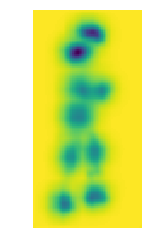

0068


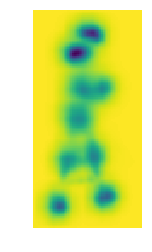

0069


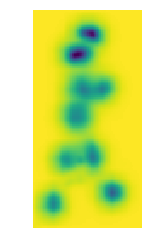

0070


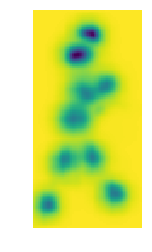

0071


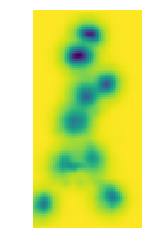

0072


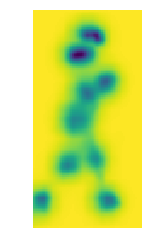

0073


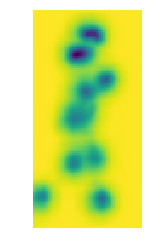

0074


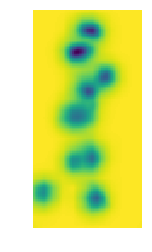

0075


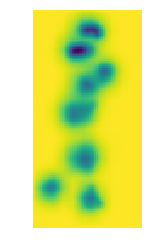

0076


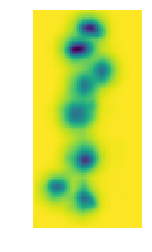

0077


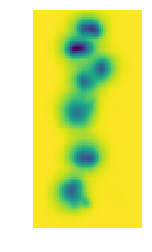

0078


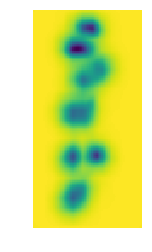

0079


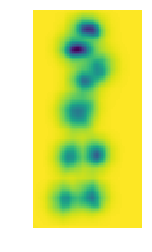

0080


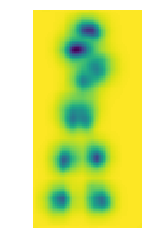

0081


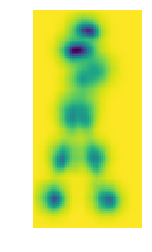

0082


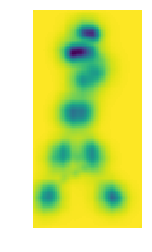

0083


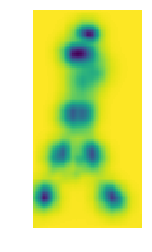

0084


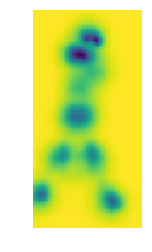

0085


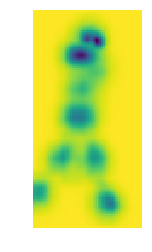

0086


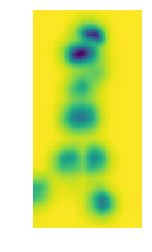

0087


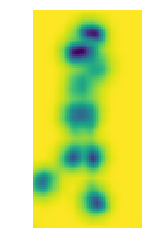

0088


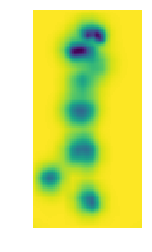

0089


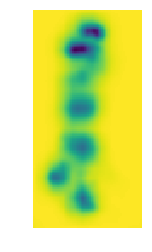

0090


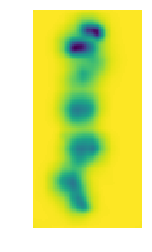

0091


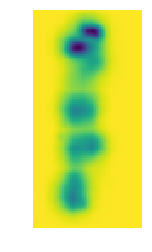

0092


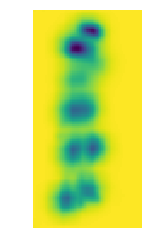

0093


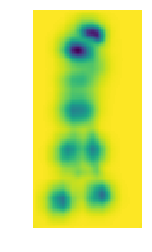

0094


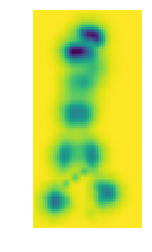

0095


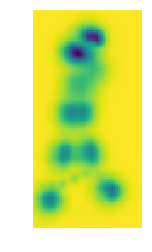

0096


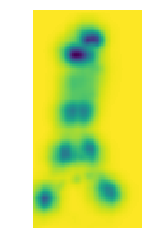

0097


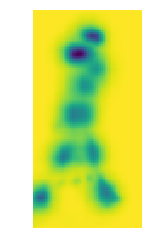

0098


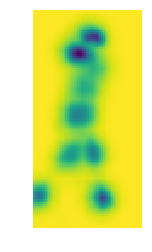

0099


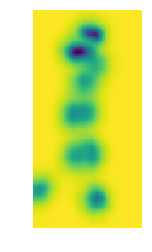

0100


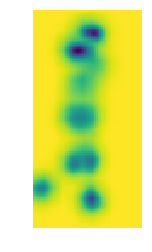

0101


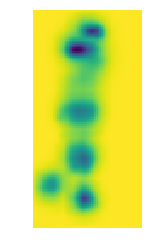

0102


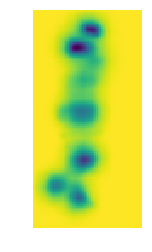

0103


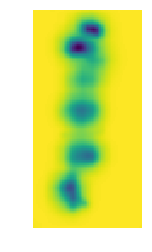

0104


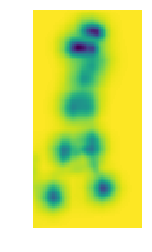

0105


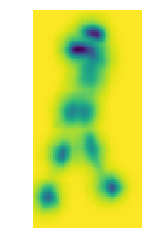

0106


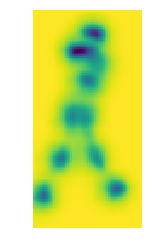

0107


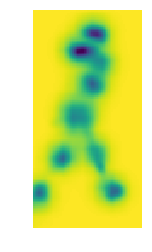

0108


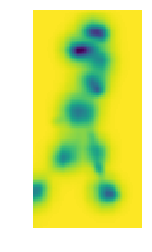

0109


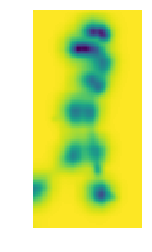

0110


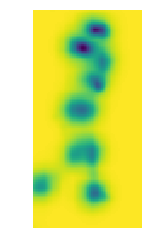

0111


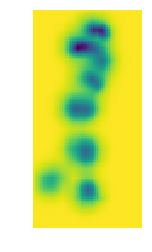

0112


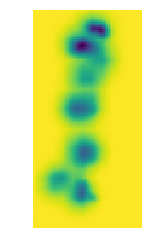

0113


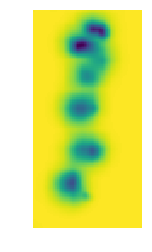

0114


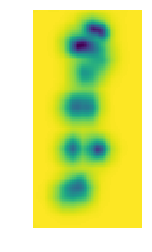

0115


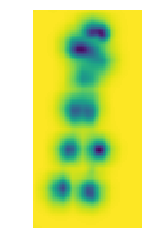

0116


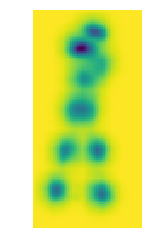

0117


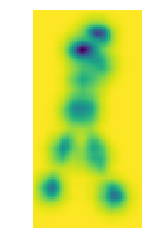

0118


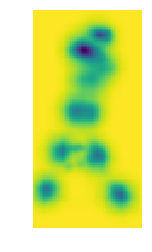

0119


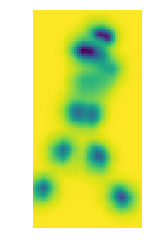

0120


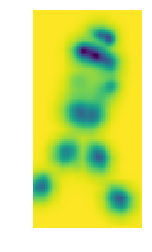

0121


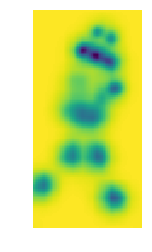

0122


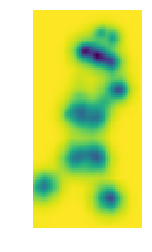

0001


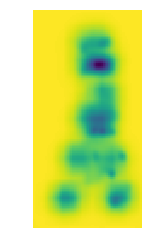

0002


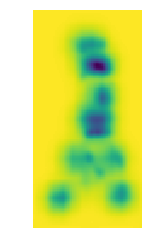

0003


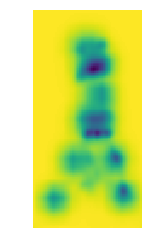

0004


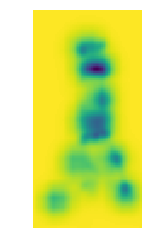

0005


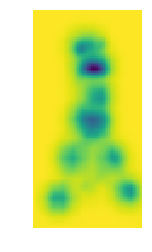

0006


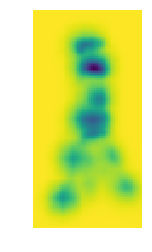

0007


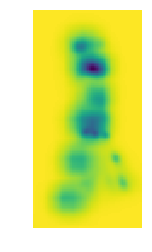

0008


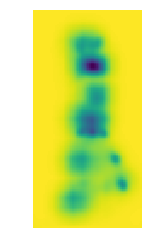

0009


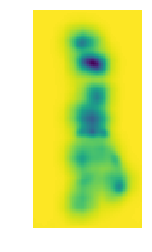

0010


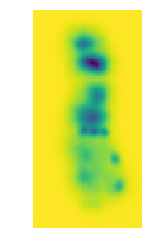

0011


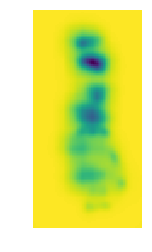

0012


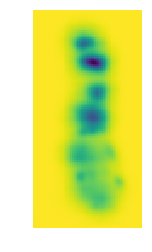

0013


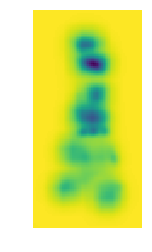

0014


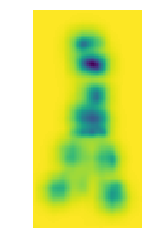

0015


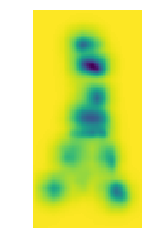

0016


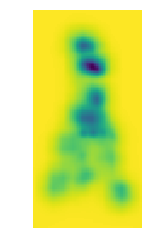

0017


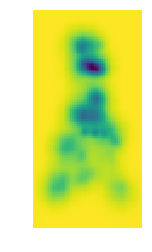

0018


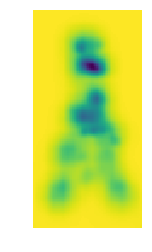

0019


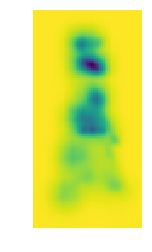

0020


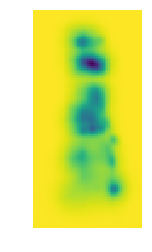

0021


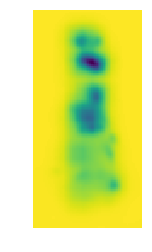

0022


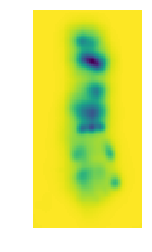

0023


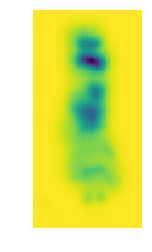

0024


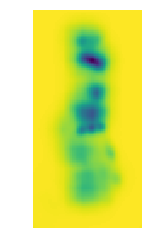

0025


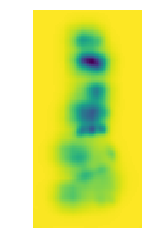

0026


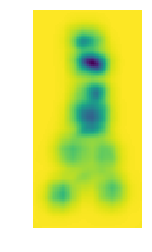

0027


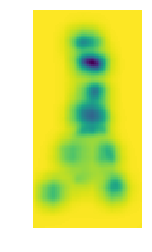

0028


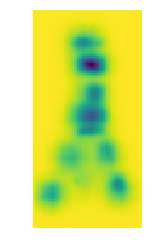

0029


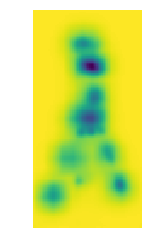

0030


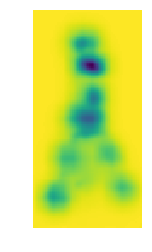

0031


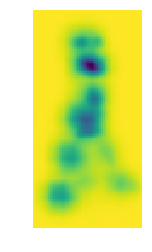

0032


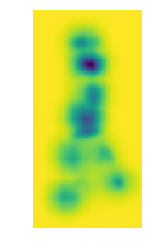

0033


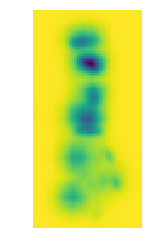

0034


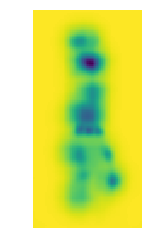

0035


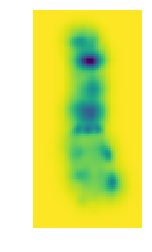

0036


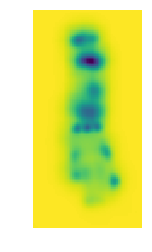

0037


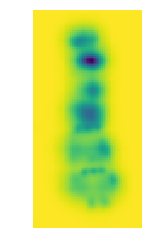

0038


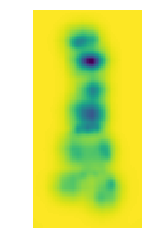

0039


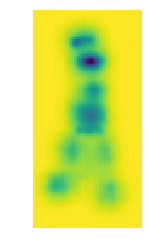

0040


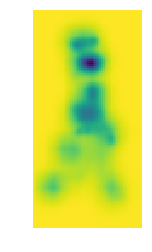

0041


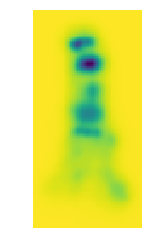

0042


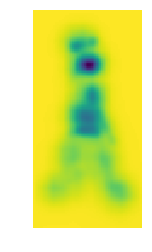

0043


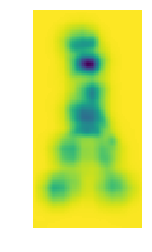

0044


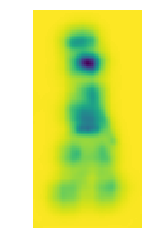

0045


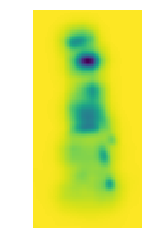

0046


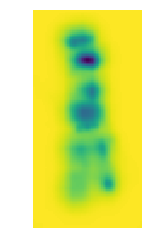

0047


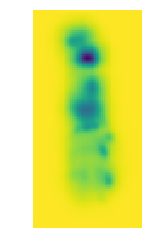

0048


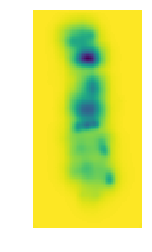

0049


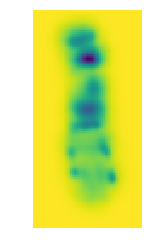

0050


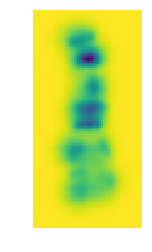

0051


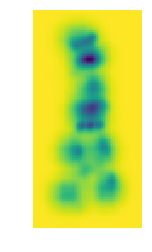

0052


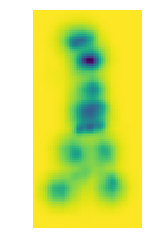

0053


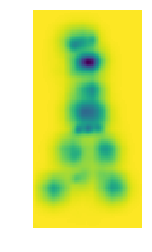

0054


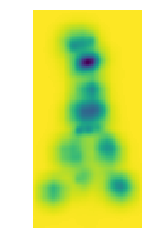

0055


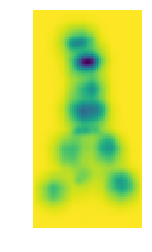

0056


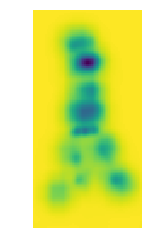

0057


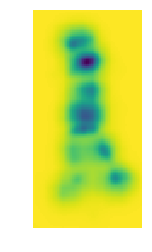

0058


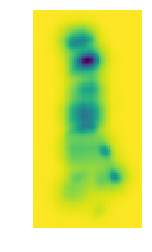

0059


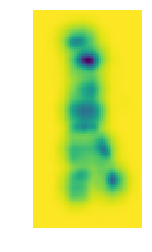

0060


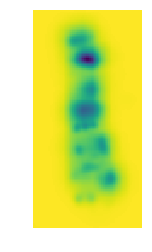

0061


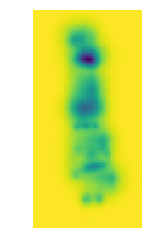

0062


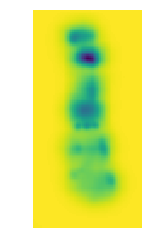

0063


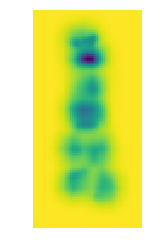

0064


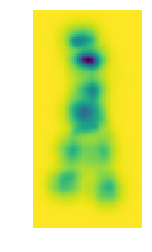

0065


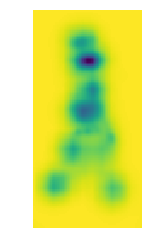

0066


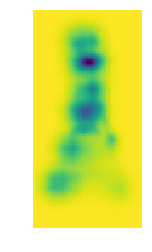

0067


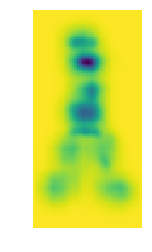

0068


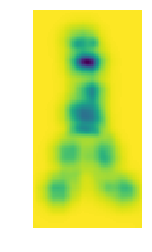

0069


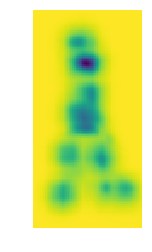

0070


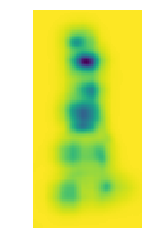

0071


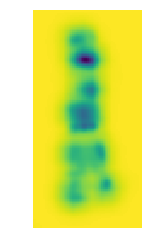

0072


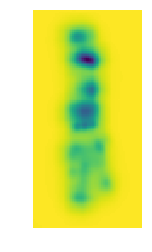

0073


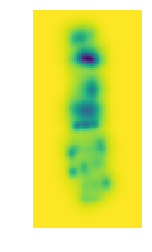

0074


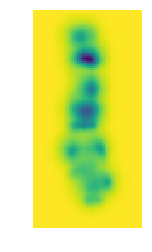

0075


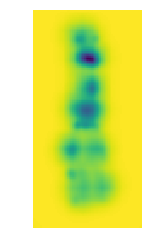

0076


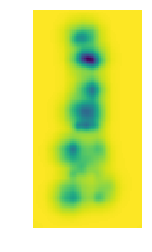

0077


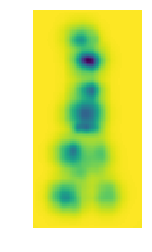

0078


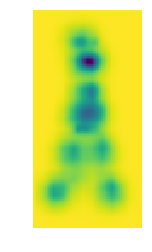

0079


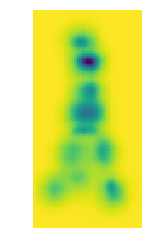

0080


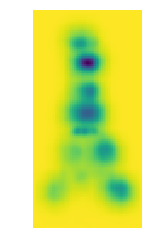

0081


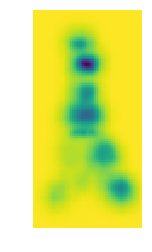

0082


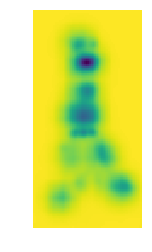

0083


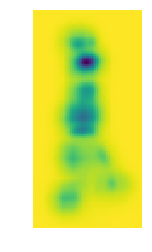

0084


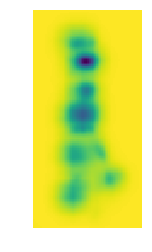

0085


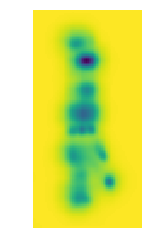

0086


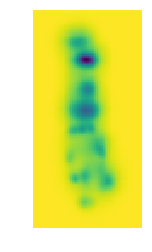

0087


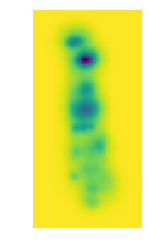

0088


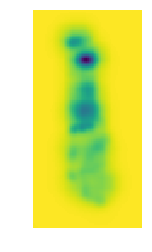

0089


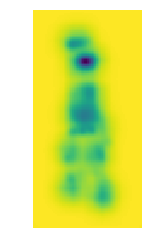

0090


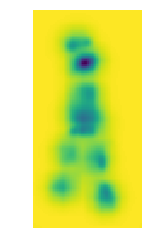

0091


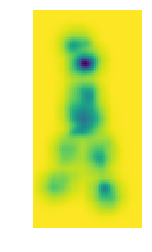

0092


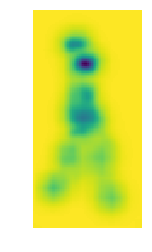

0093


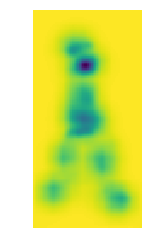

0094


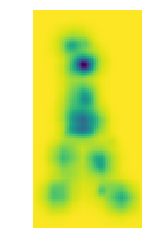

0095


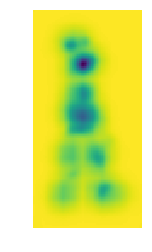

0096


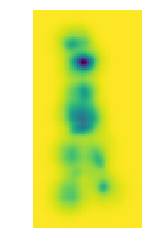

0097


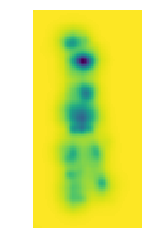

0098


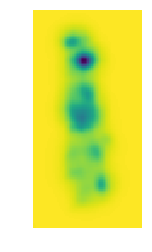

0099


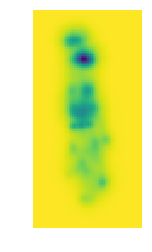

0100


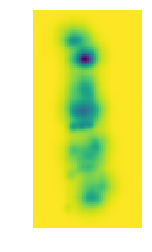

0101


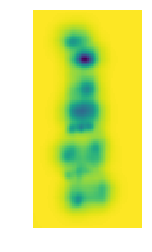

0102


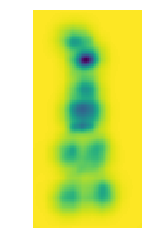

0103


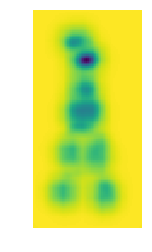

0104


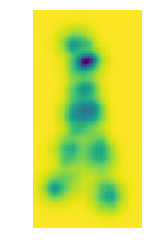

0105


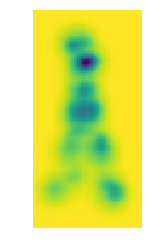

0106


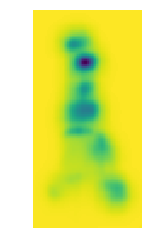

0107


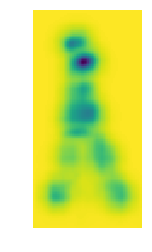

0108


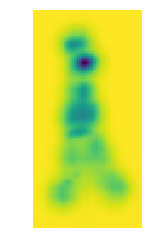

0109


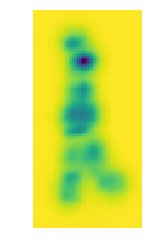

0110


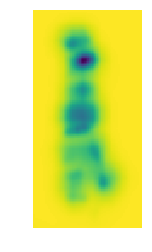

0111


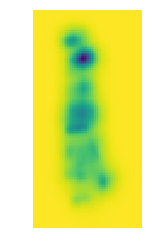

0112


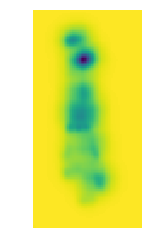

0113


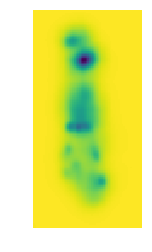

0114


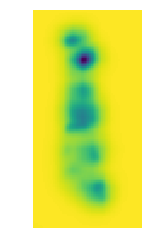

0115


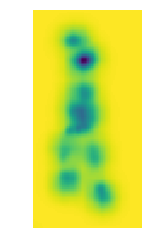

0116


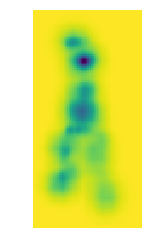

0117


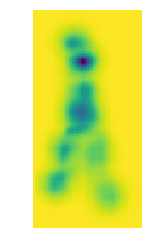

0118


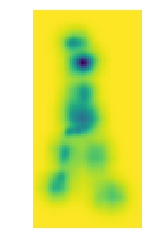

0119


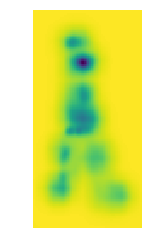

0120


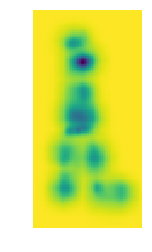

0121


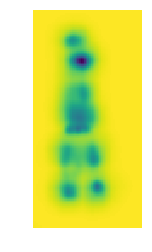

0122


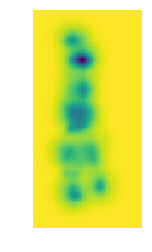

0123


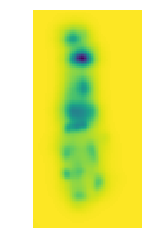

0124


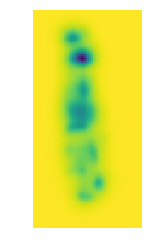

0125


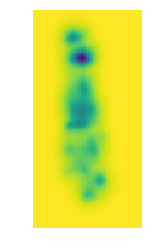

0126


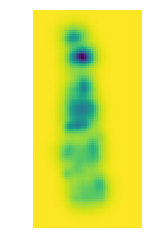

0127


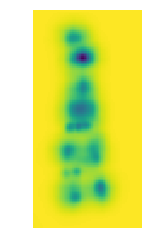

0128


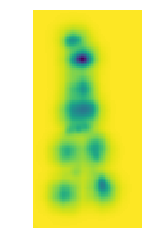

0129


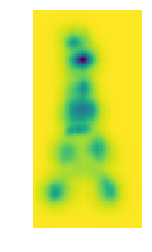

0130


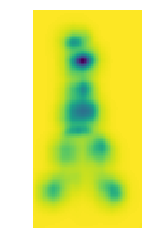

0131


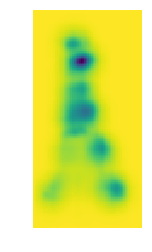

0132


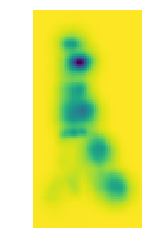

0133


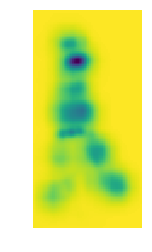

0134


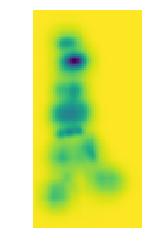

0135


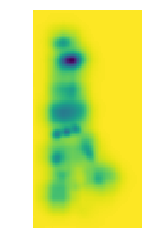

0136


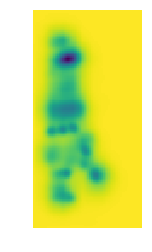

0137


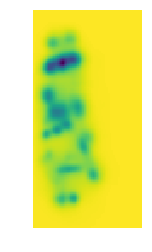

0138


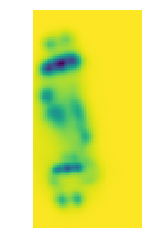

0139


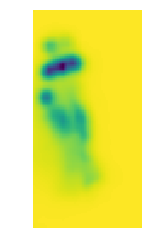

0140


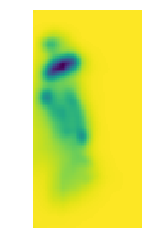

0141


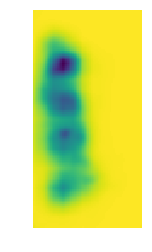

0001


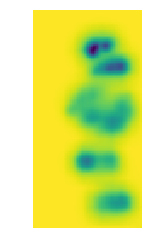

0002


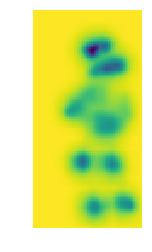

0003


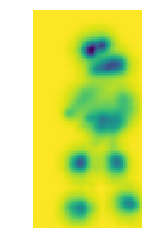

0004


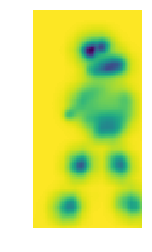

0005


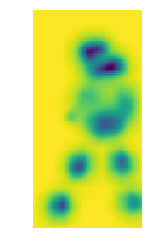

0006


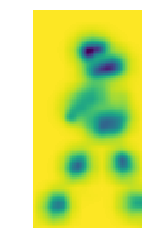

0007


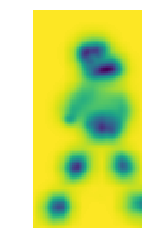

0008


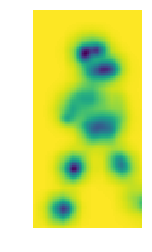

0009


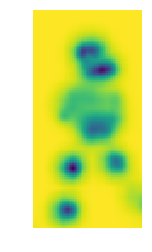

0010


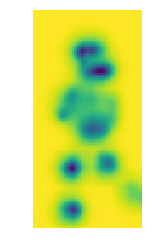

0011


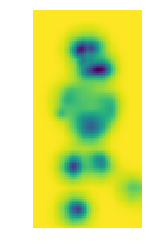

0012


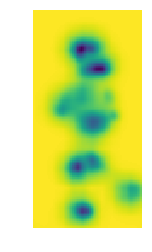

0013


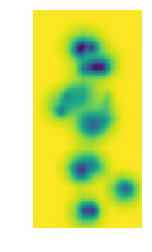

0014


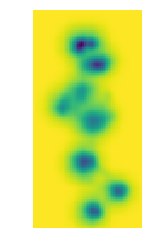

0015


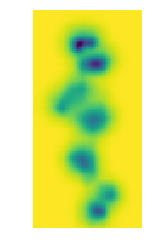

0016


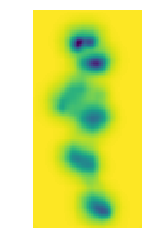

0017


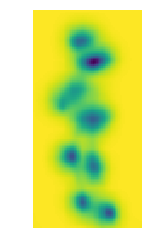

0018


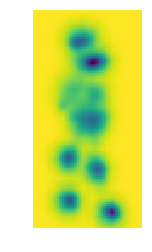

0019


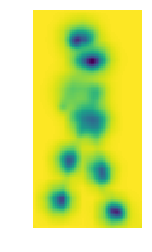

0020


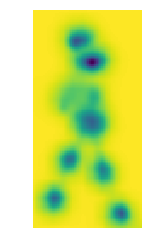

0021


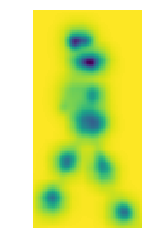

0022


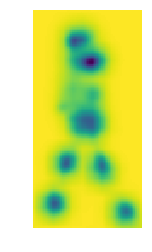

0023


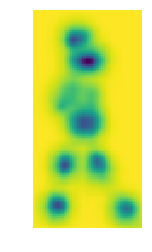

0024


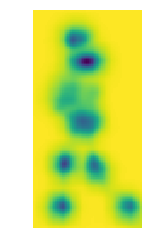

0025


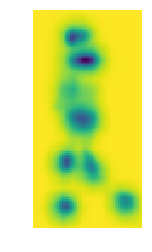

0026


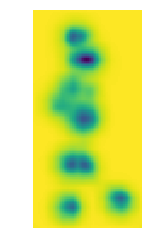

0027


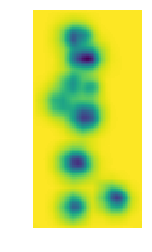

0028


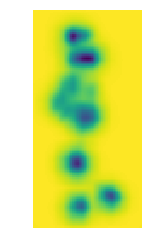

0029


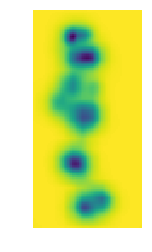

0030


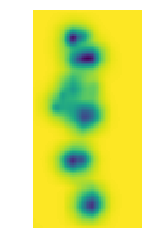

0031


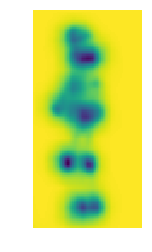

0032


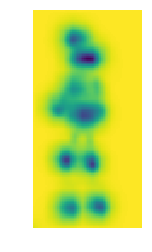

0033


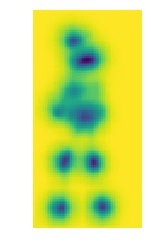

0034


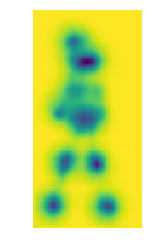

0035


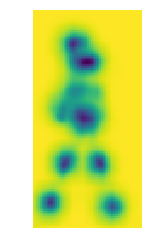

0036


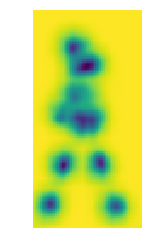

0037


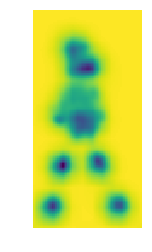

0038


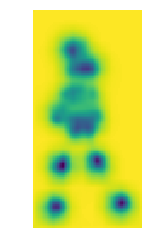

0039


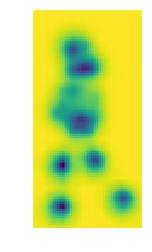

0040


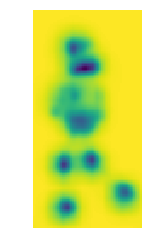

0041


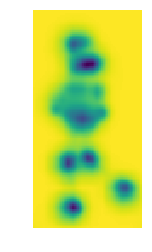

0042


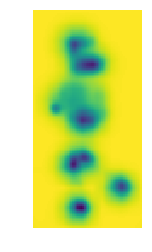

0043


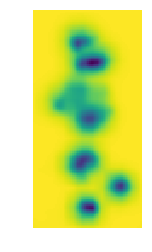

0044


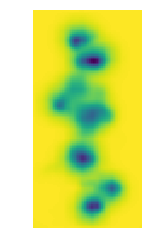

0045


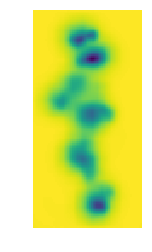

0046


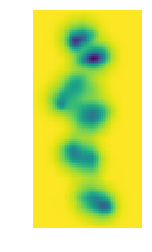

0047


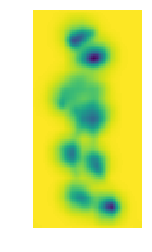

0048


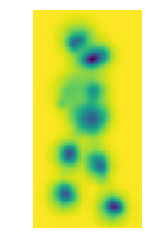

0049


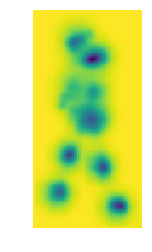

0050


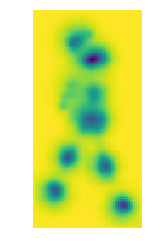

0051


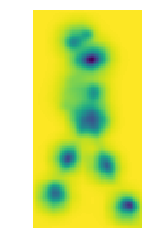

0052


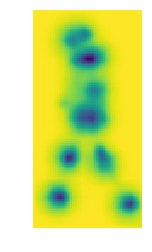

0053


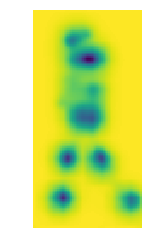

0054


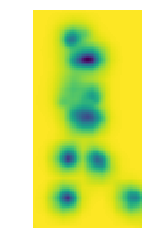

0055


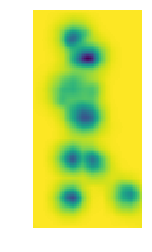

0056


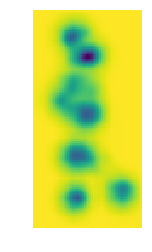

0057


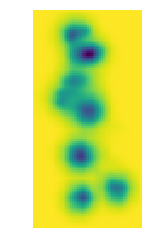

0058


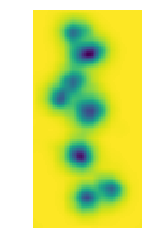

0059


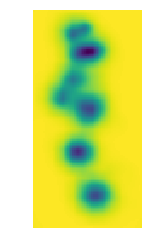

0060


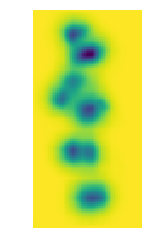

0061


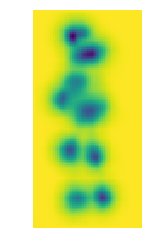

0062


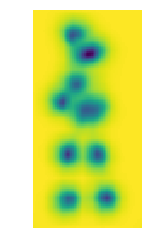

0063


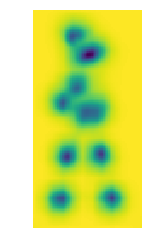

0064


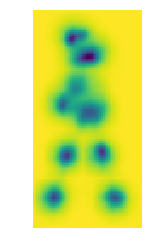

0065


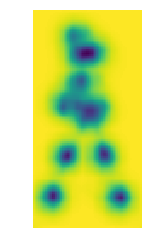

0066


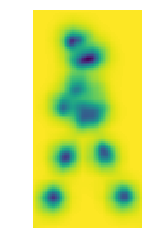

0067


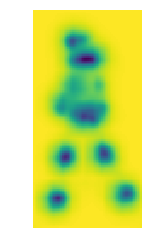

0068


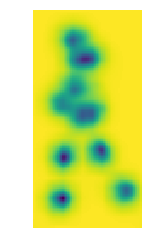

0069


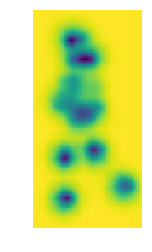

0070


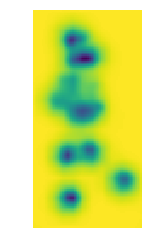

0071


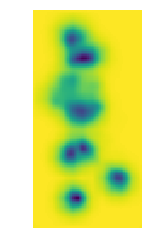

0072


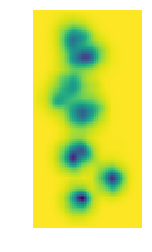

0073


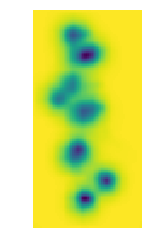

0074


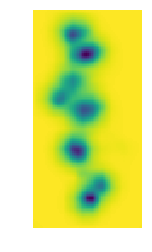

0075


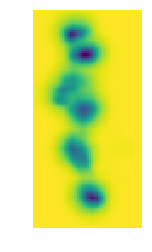

0076


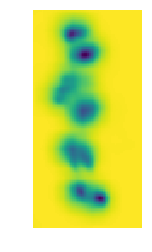

0077


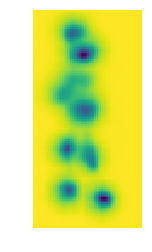

0078


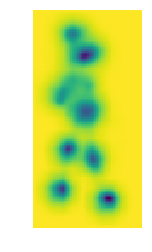

0079


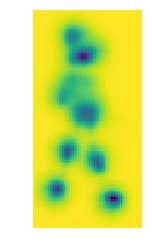

0080


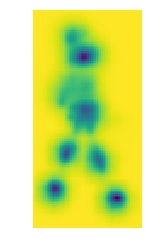

0081


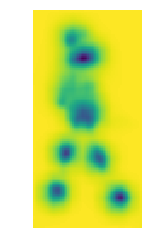

0082


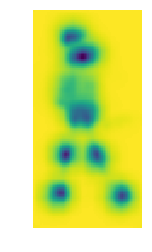

0083


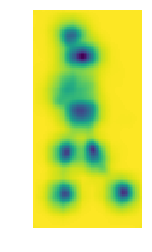

0084


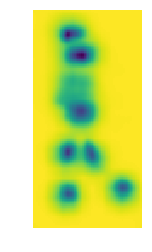

0085


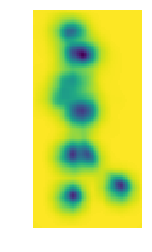

0086


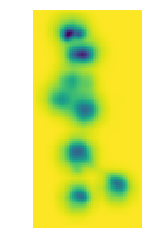

0087


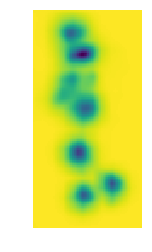

0088


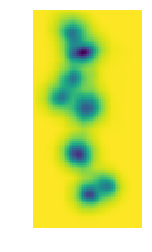

0089


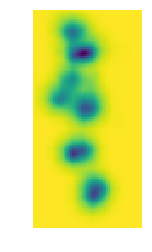

0090


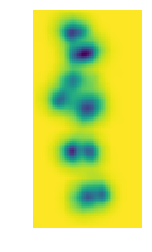

0091


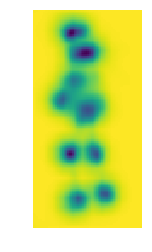

0092


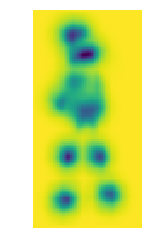

0093


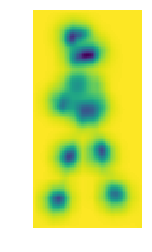

0094


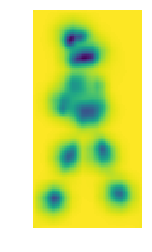

0095


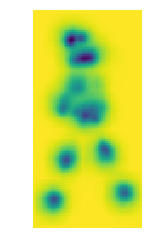

0096


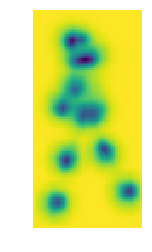

0097


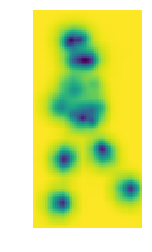

0098


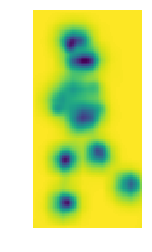

0099


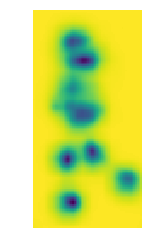

0100


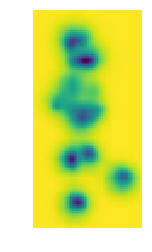

0101


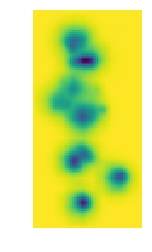

0102


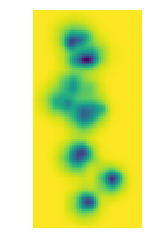

0103


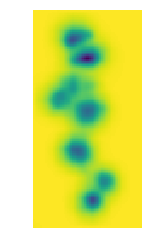

0104


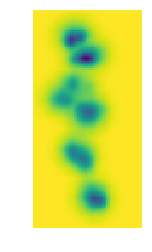

0105


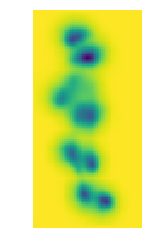

0106


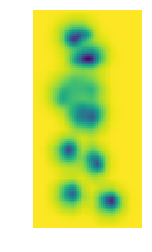

0107


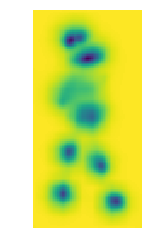

0108


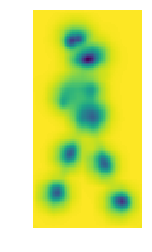

0109


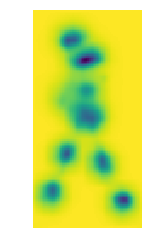

0110


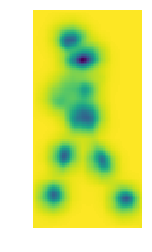

0111


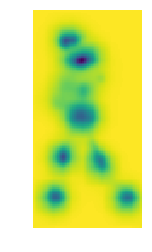

0112


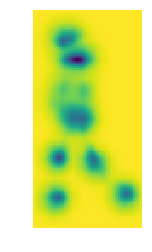

0113


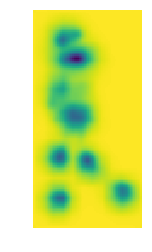

0114


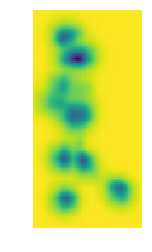

0115


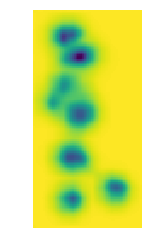

0116


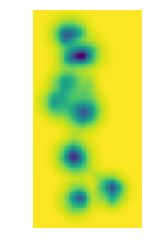

0117


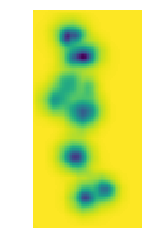

0118


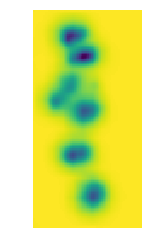

0119


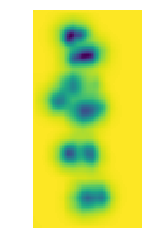

0120


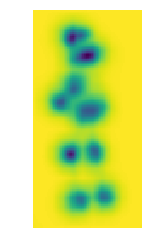

0121


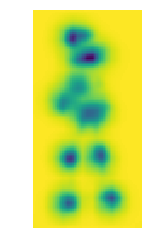

0122


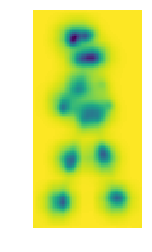

0123


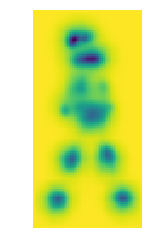

0124


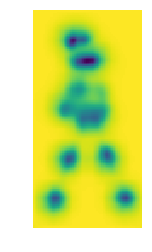

0125


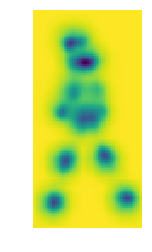

0126


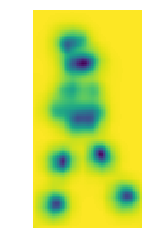

0127


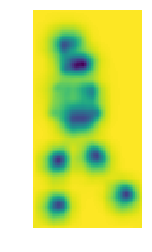

0128


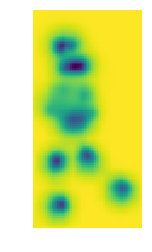

0129


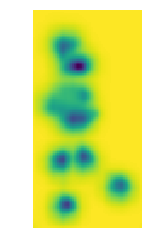

0130


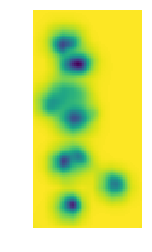

0131


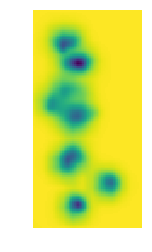

0132


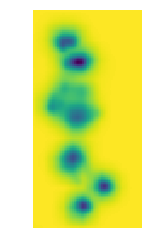

0133


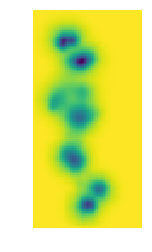

0134


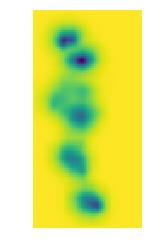

0135


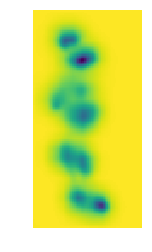

0136


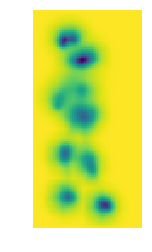

0137


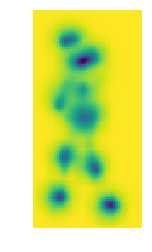

0138


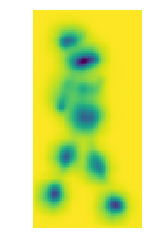

0139


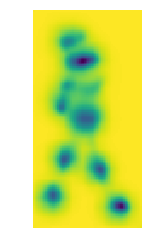

0140


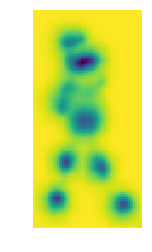

0141


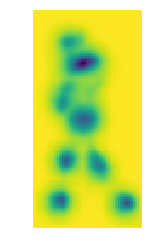

0142


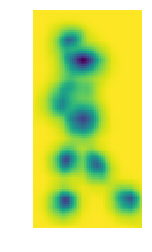

0143


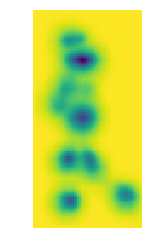

0144


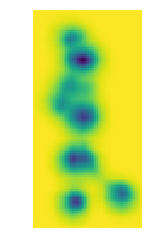

0145


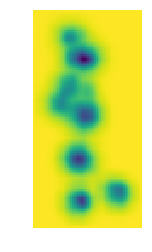

0146


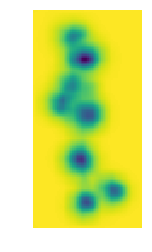

0147


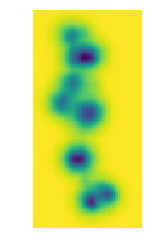

0148


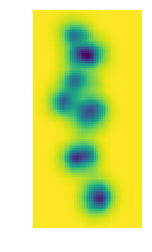

0149


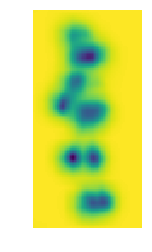

0150


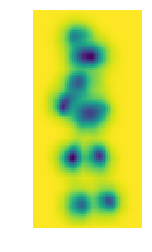

0151


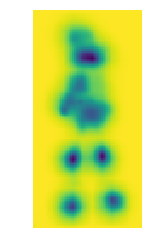

0152


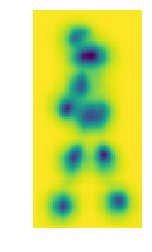

0153


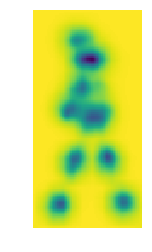

0154


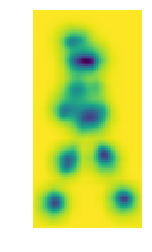

0155


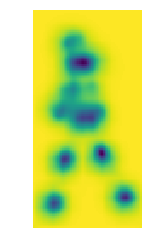

0156


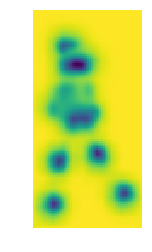

0157


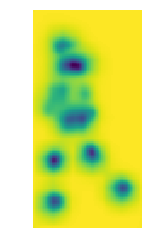

0158


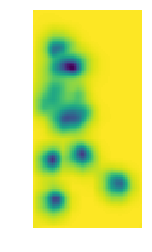

0159


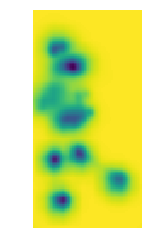

0160


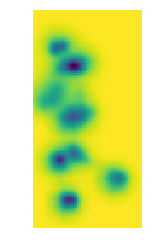

0161


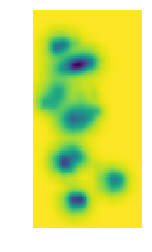

0162


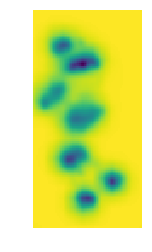

0163


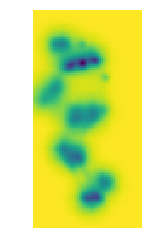

0164


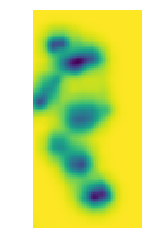

0165


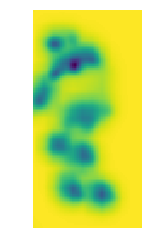

0166


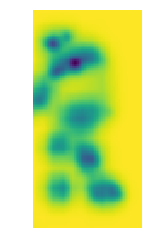

0167


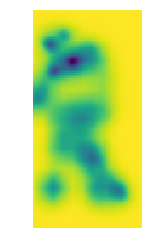

0168


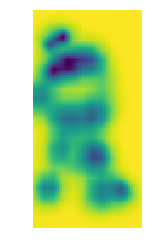

0001


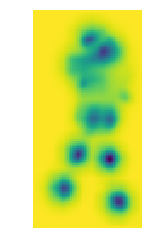

0002


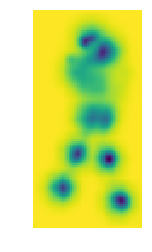

0003


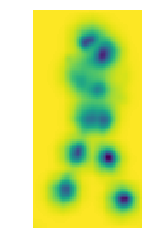

0004


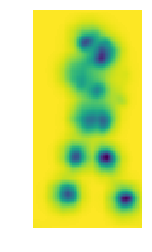

0005


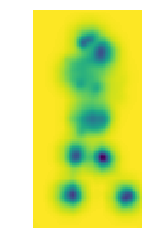

0006


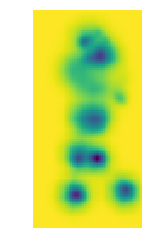

0007


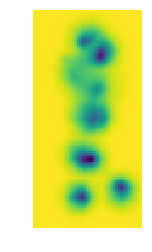

0008


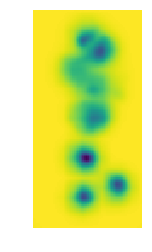

0009


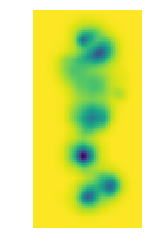

0010


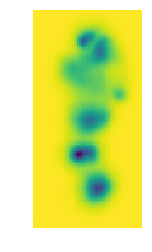

0011


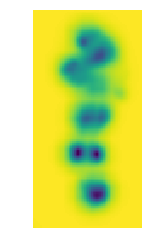

0012


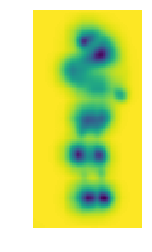

0013


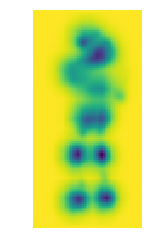

0014


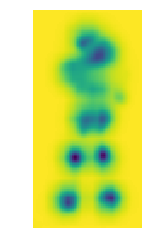

0015


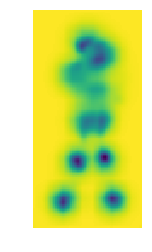

0016


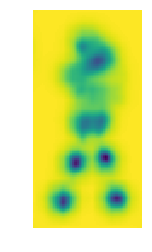

0017


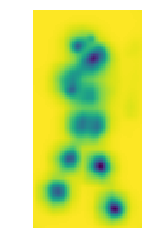

0018


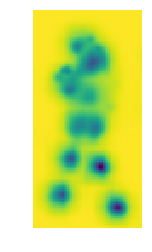

0019


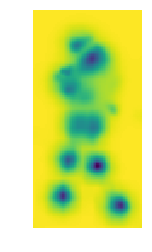

0020


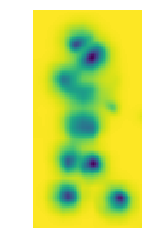

0021


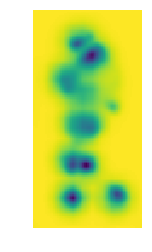

0022


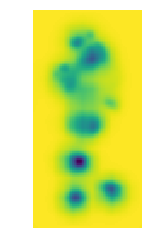

0023


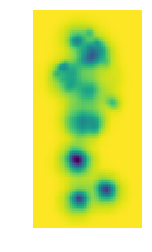

0024


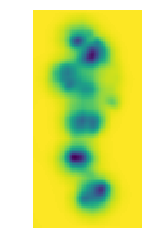

0025


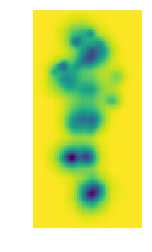

0026


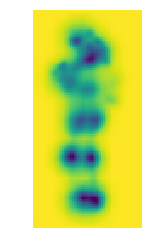

0027


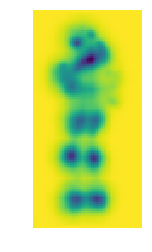

0028


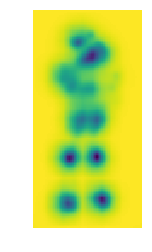

0029


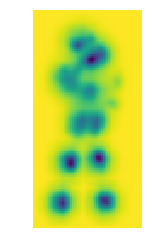

0030


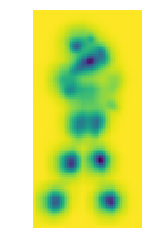

0031


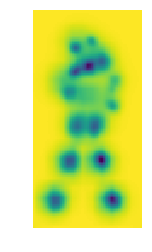

0032


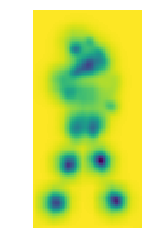

0033


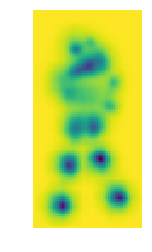

0034


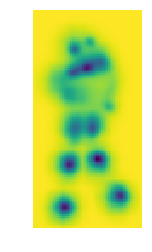

0035


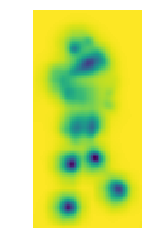

0036


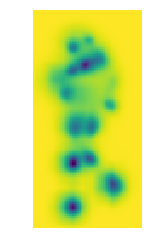

0037


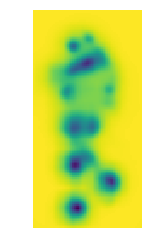

0038


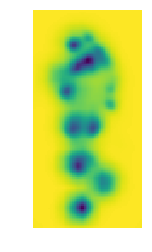

0039


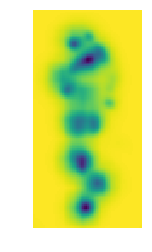

0040


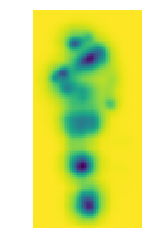

0041


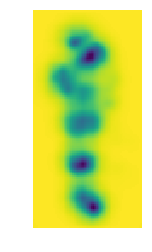

0042


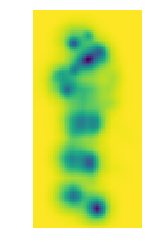

0043


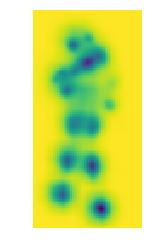

0044


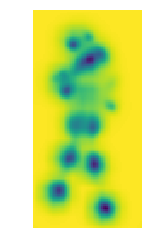

0045


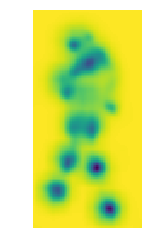

0046


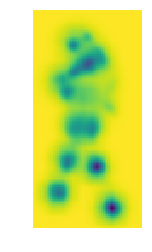

0047


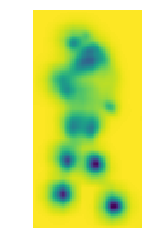

0048


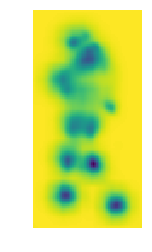

0049


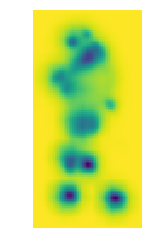

0050


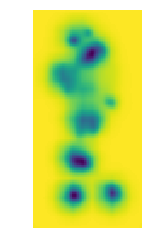

0051


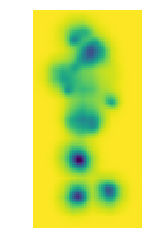

0052


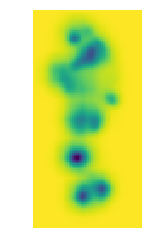

0053


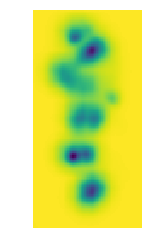

0054


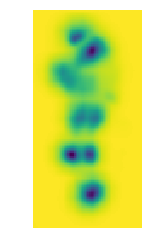

0055


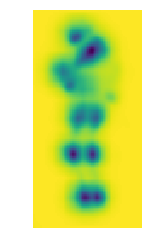

0056


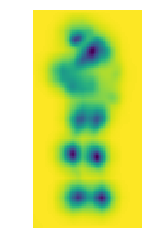

0057


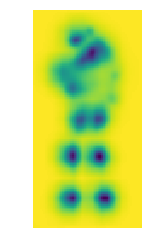

0058


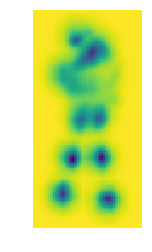

0059


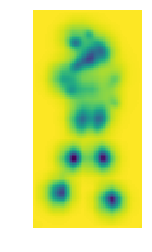

0060


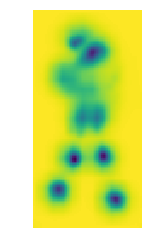

0061


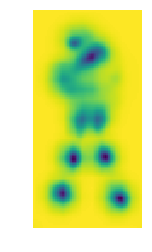

0062


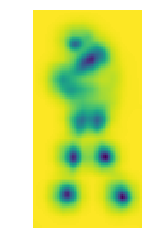

0063


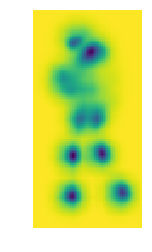

0064


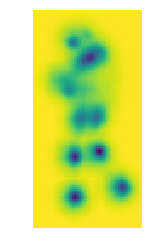

0065


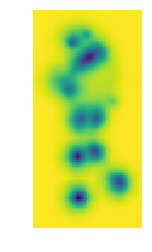

0066


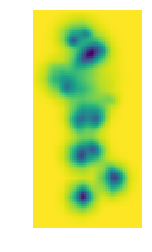

0067


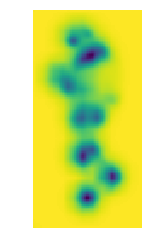

0068


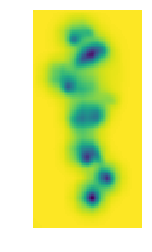

0069


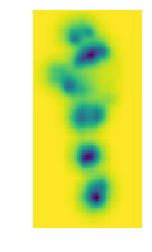

0070


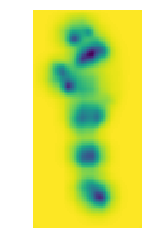

0071


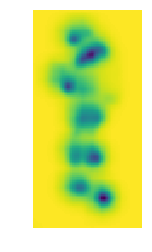

0072


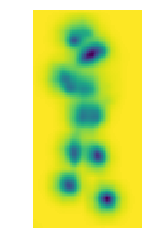

0073


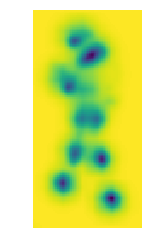

0074


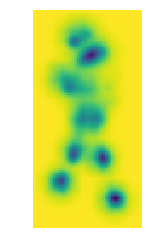

0075


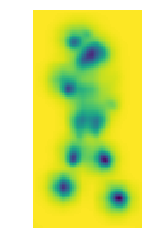

0076


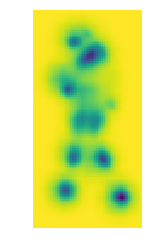

0077


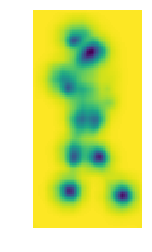

0078


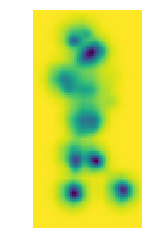

0079


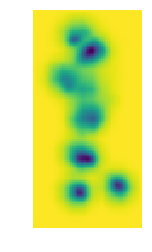

0080


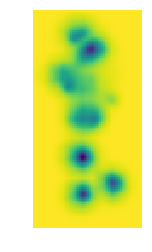

0081


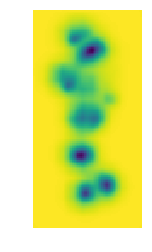

0082


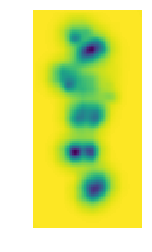

0083


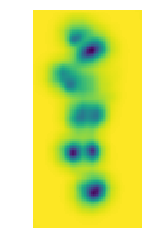

0084


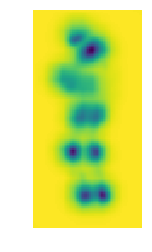

0085


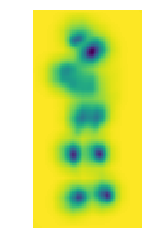

0086


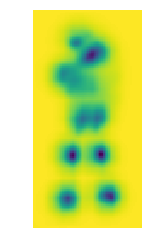

0087


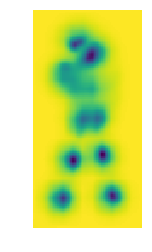

0088


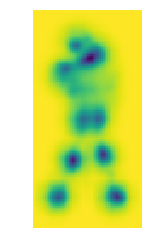

0089


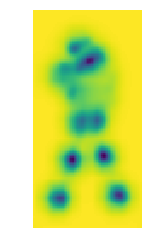

0090


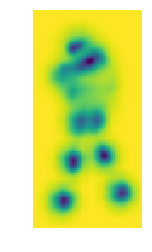

0091


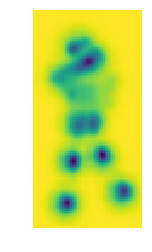

0092


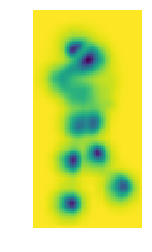

0093


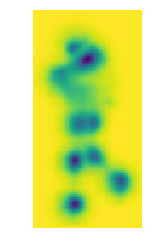

0094


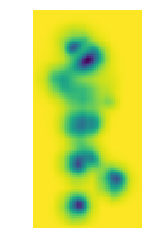

0095


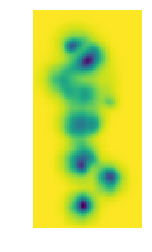

0096


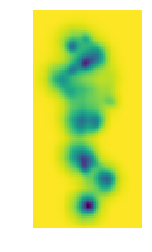

0097


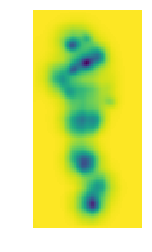

0098


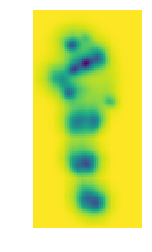

0099


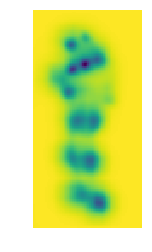

0100


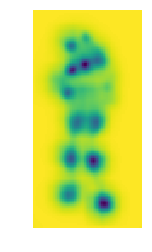

0101


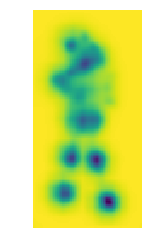

0102


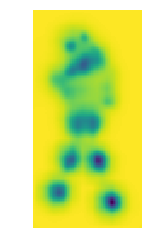

0103


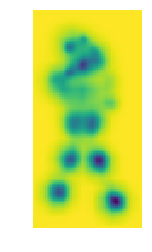

0104


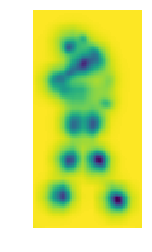

0105


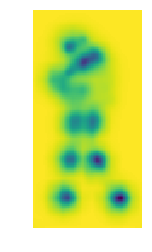

0106


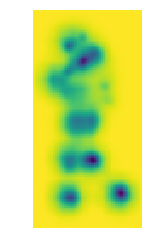

0107


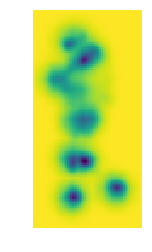

0108


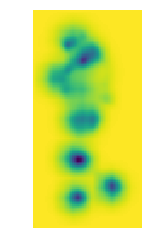

0109


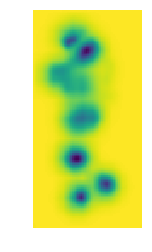

0110


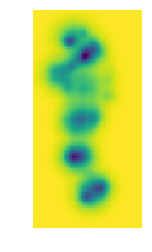

0111


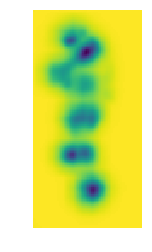

0112


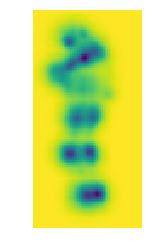

0113


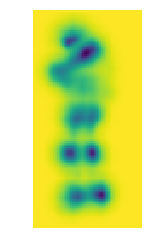

0114


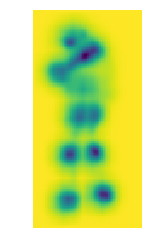

0115


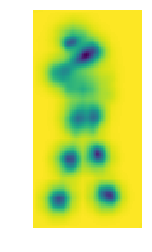

0116


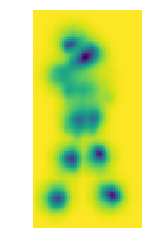

0117


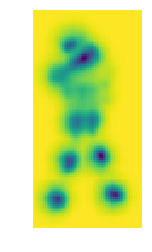

0118


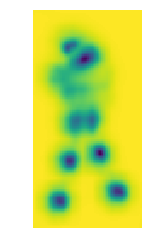

0119


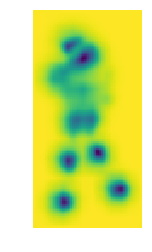

0120


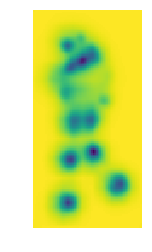

0121


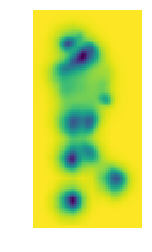

0122


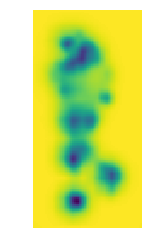

0123


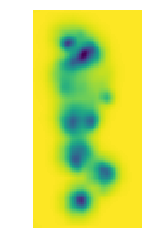

0124


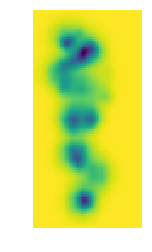

0125


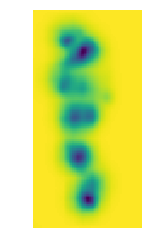

0126


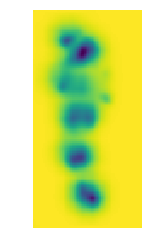

0127


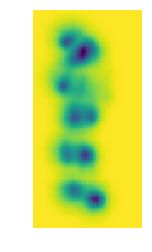

0128


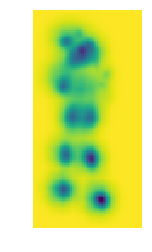

0129


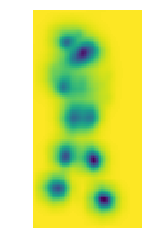

0130


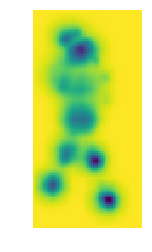

0131


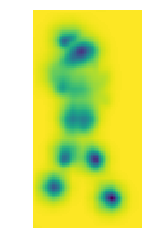

0132


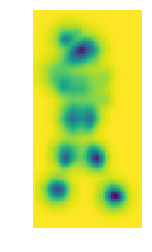

0133


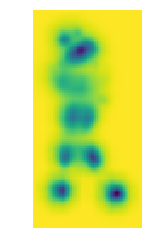

0134


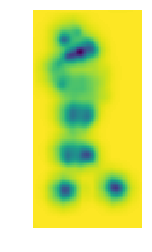

0135


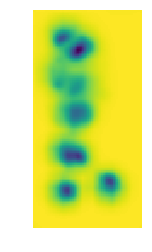

0136


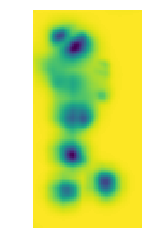

0137


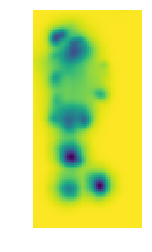

0138


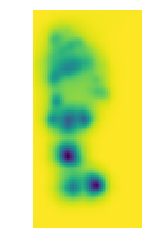

0139


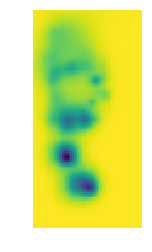

0140


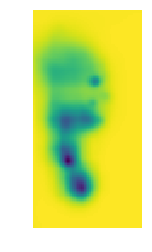

0001


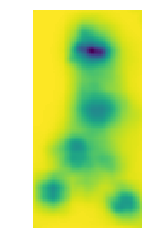

0002


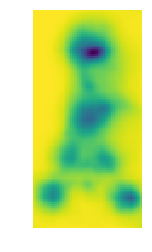

0003


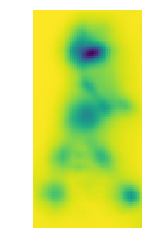

0004


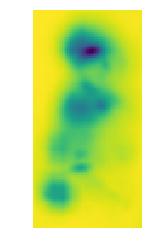

0005


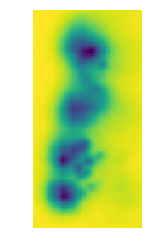

0006


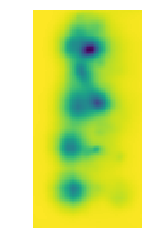

0007


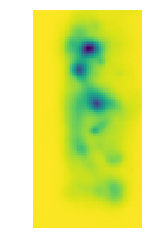

0008


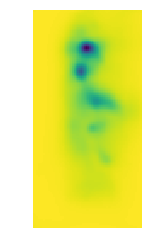

0009


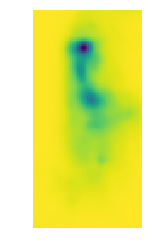

0010


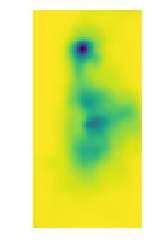

0001


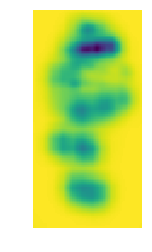

0002


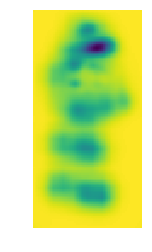

0003


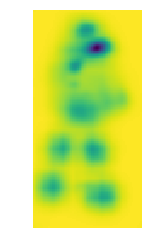

0004


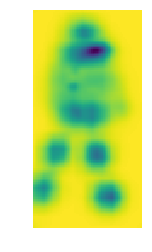

0005


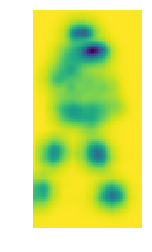

0006


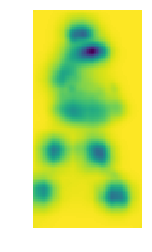

0007


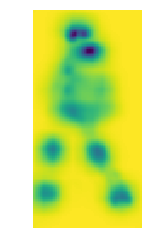

0008


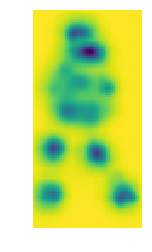

0009


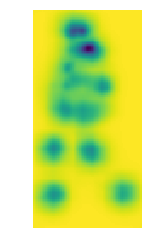

0010


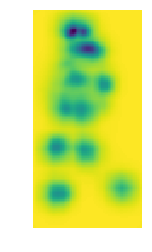

0011


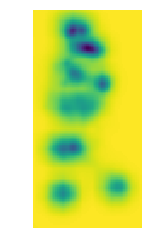

0012


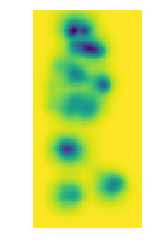

0013


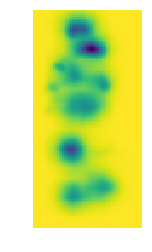

0014


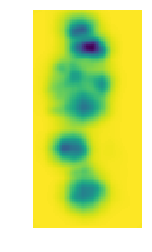

0015


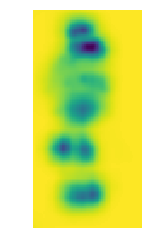

0016


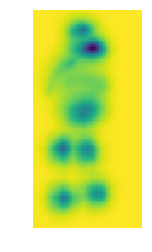

0017


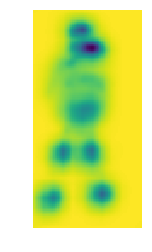

0018


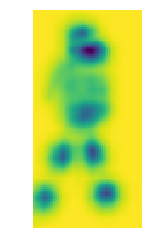

0019


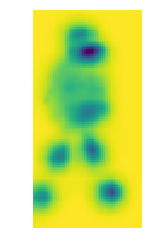

0020


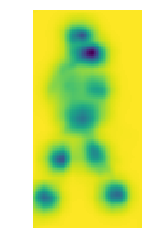

0021


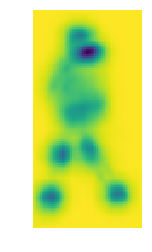

0022


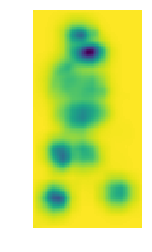

0023


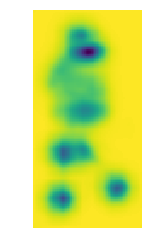

0024


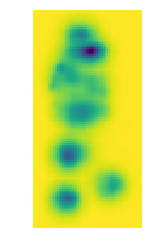

0025


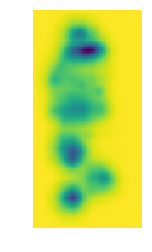

0026


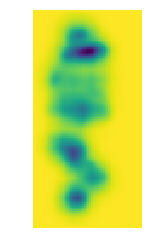

0027


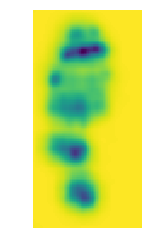

0028


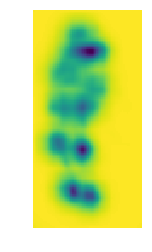

0029


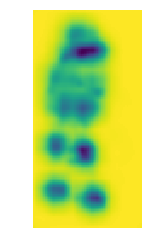

0030


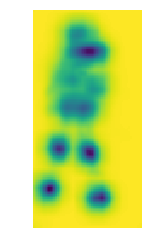

0031


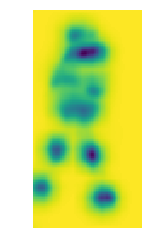

0032


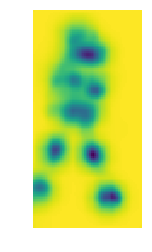

0033


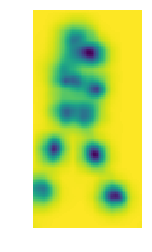

0034


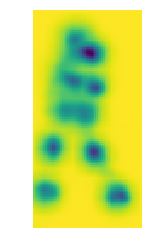

0035


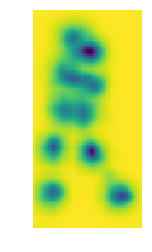

0036


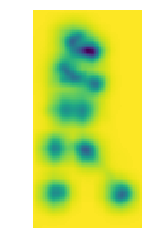

0037


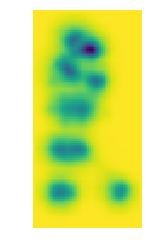

0038


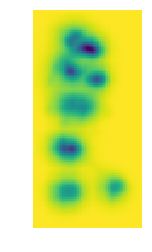

0039


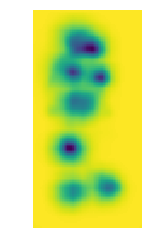

0040


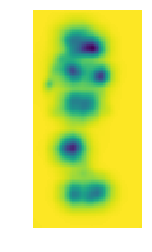

0041


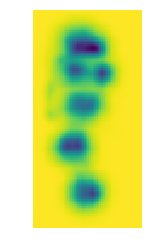

0042


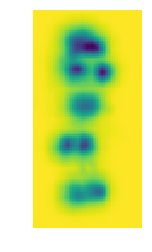

0043


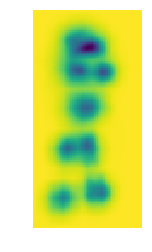

0044


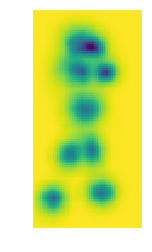

0045


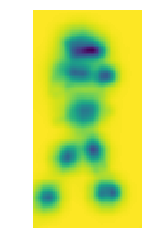

0046


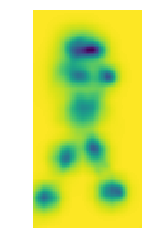

0047


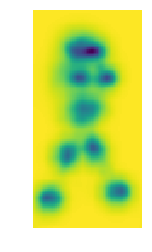

0048


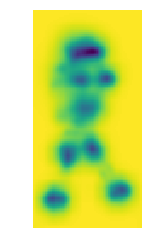

0049


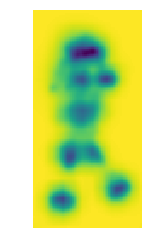

0050


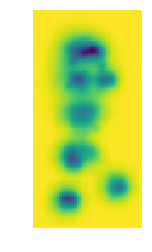

0051


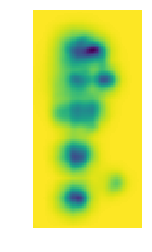

0052


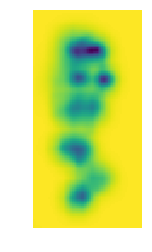

0053


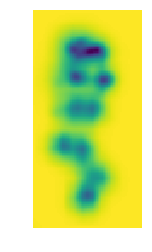

0054


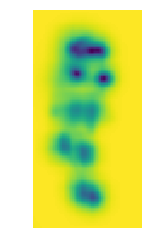

0055


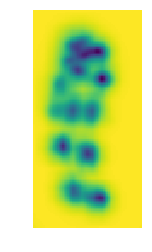

0056


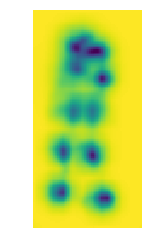

0057


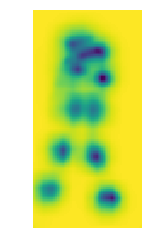

0058


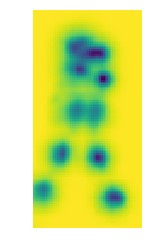

0059


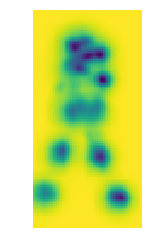

0060


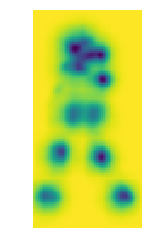

0061


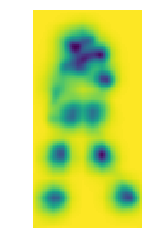

0062


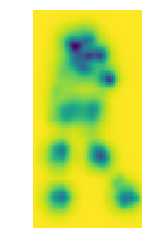

0063


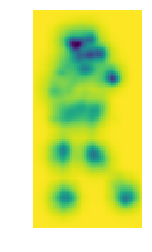

0064


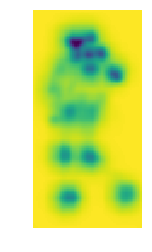

0065


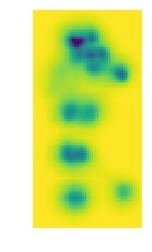

0066


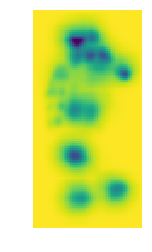

0067


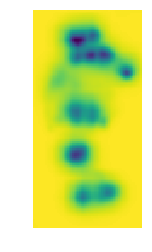

0068


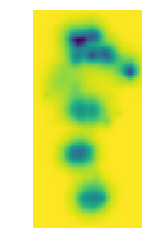

0069


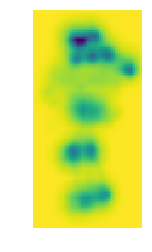

0070


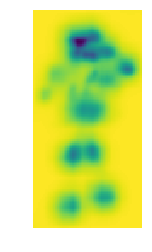

0071


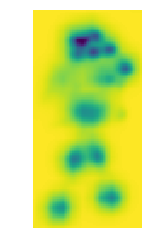

0072


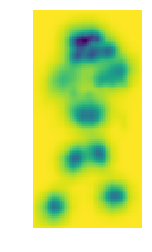

0073


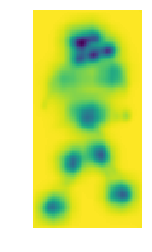

0074


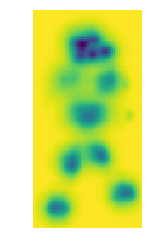

0075


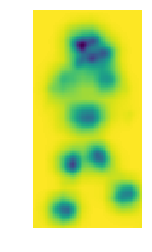

0076


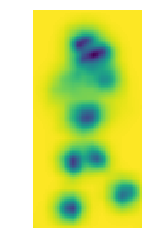

0077


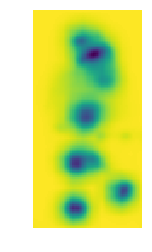

0078


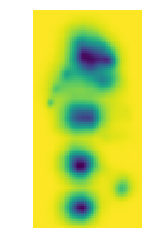

0079


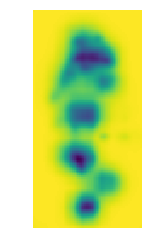

0080


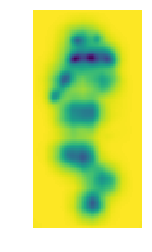

0081


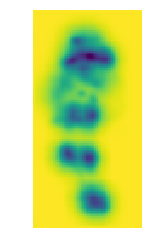

0082


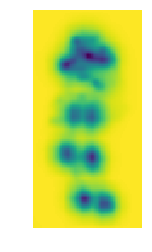

0083


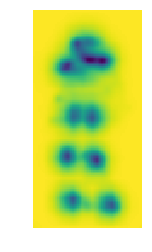

0084


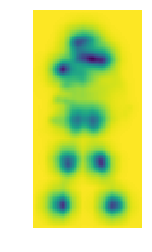

0085


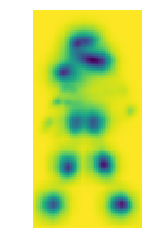

0086


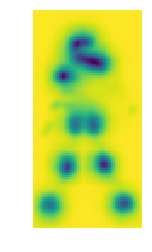

0087


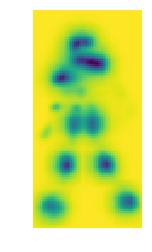

0088


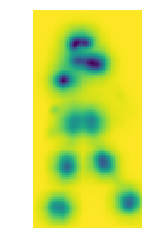

0089


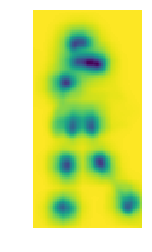

0090


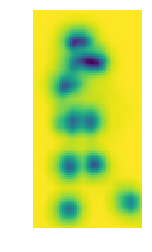

0091


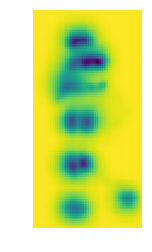

0092


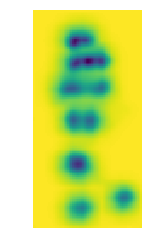

0093


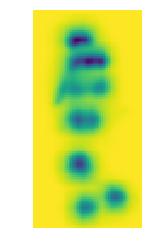

0094


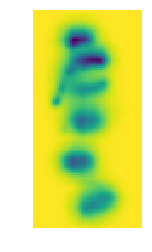

0095


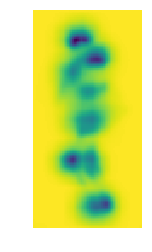

0096


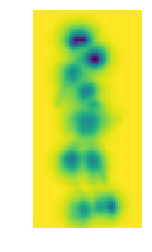

0097


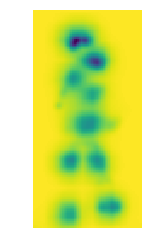

0098


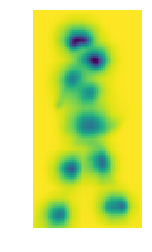

0099


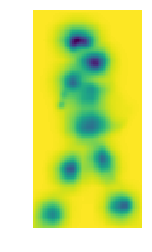

0100


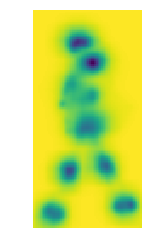

0101


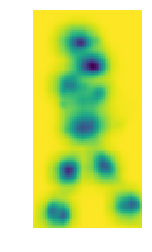

0102


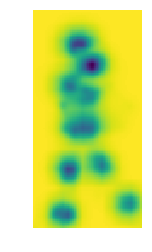

0103


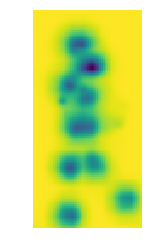

0104


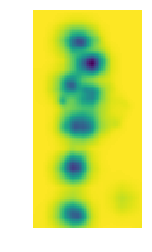

0105


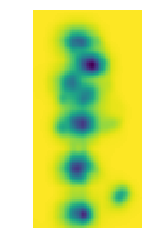

0106


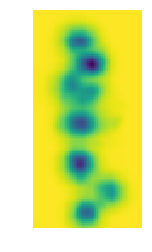

0107


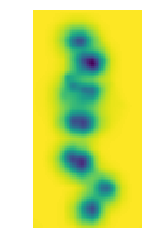

0108


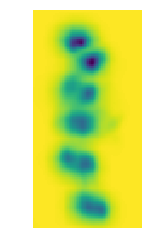

0109


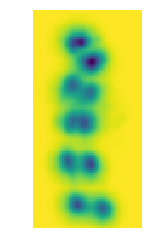

0110


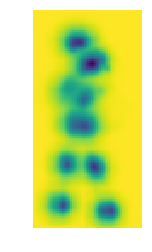

0111


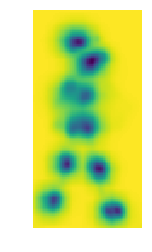

0112


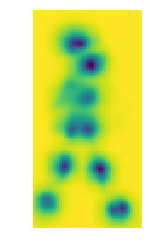

0113


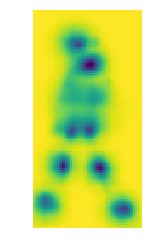

0114


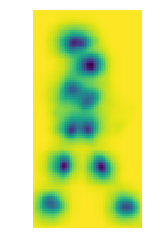

0115


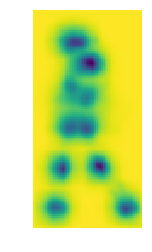

0116


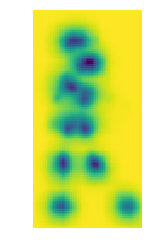

0117


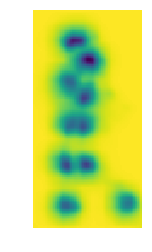

0118


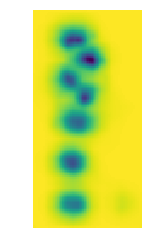

0119


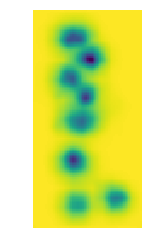

0120


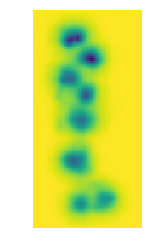

0121


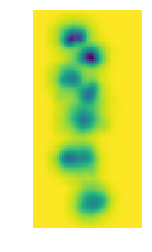

0122


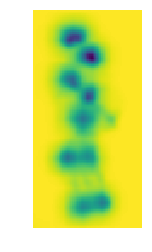

0123


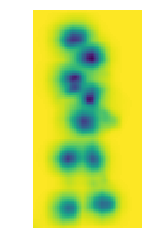

0124


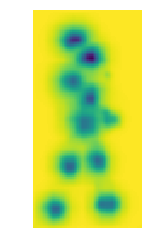

0125


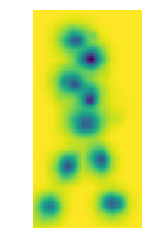

0126


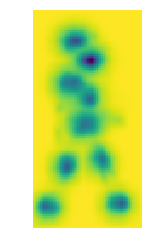

0127


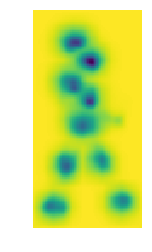

0128


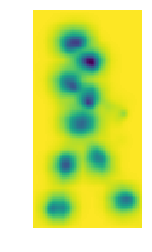

0129


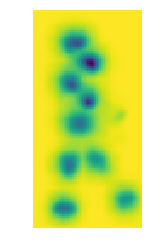

0130


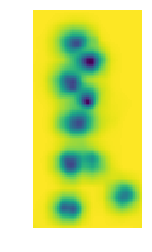

0131


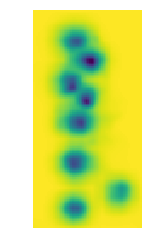

0132


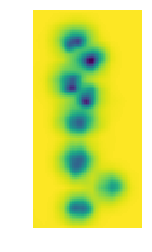

0133


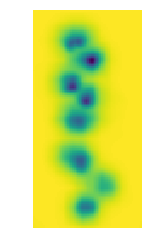

0134


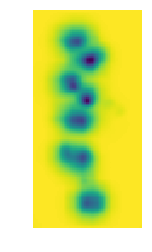

0135


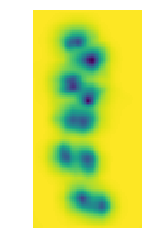

0136


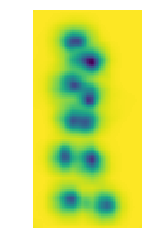

0137


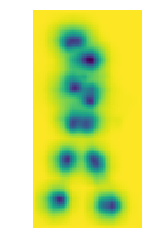

0138


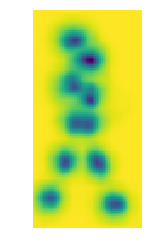

0139


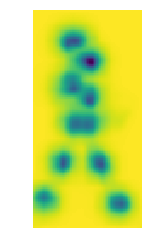

0140


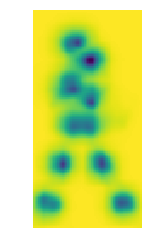

0141


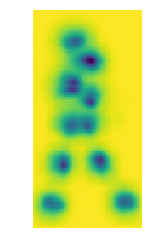

0142


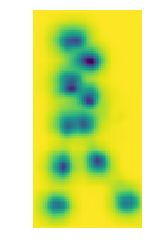

0143


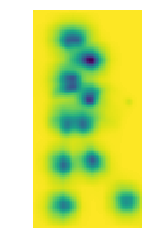

0144


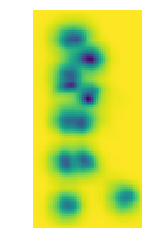

0145


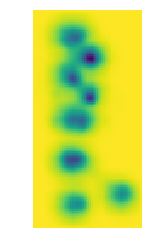

0146


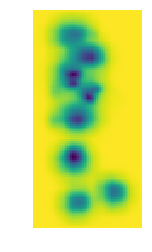

0147


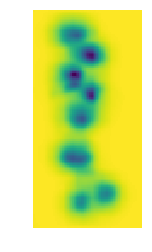

0148


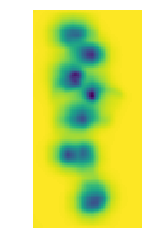

0149


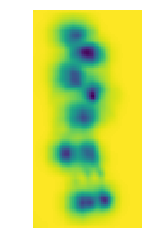

0150


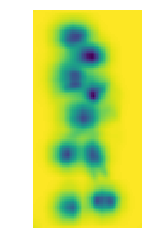

0151


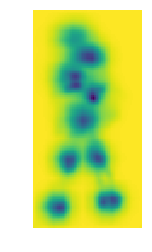

0152


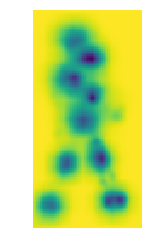

0153


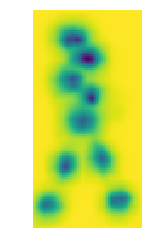

0154


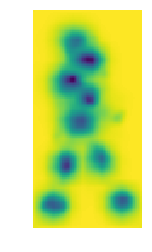

0155


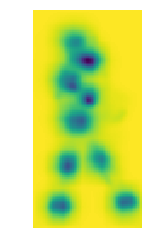

0156


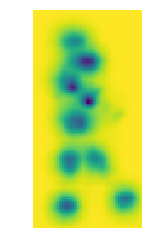

0157


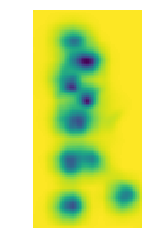

0158


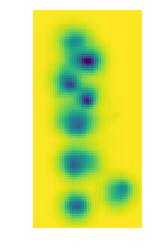

0159


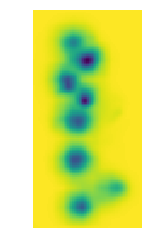

0160


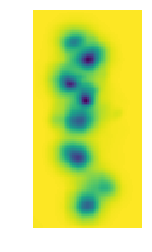

0161


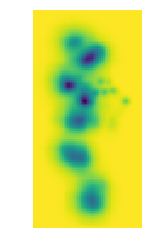

0162


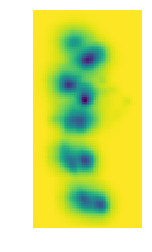

0163


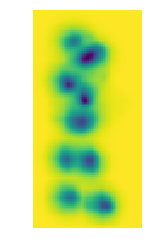

0164


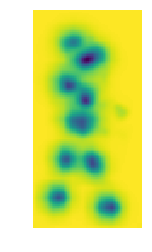

0165


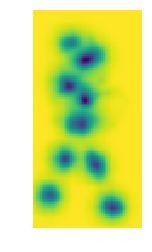

0166


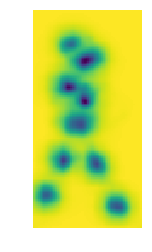

0167


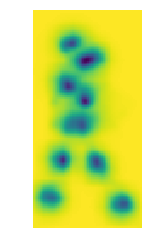

0168


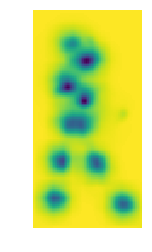

0169


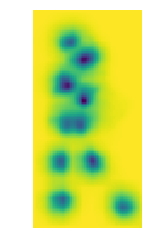

0170


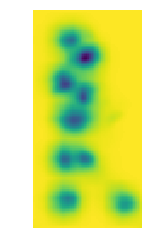

0171


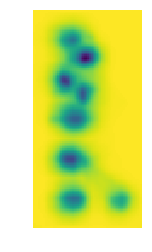

0172


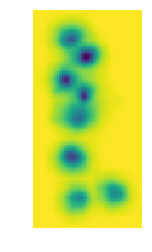

0173


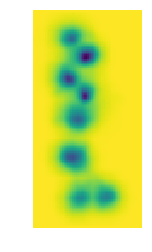

0174


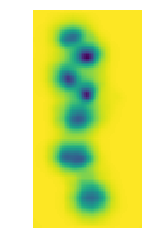

0175


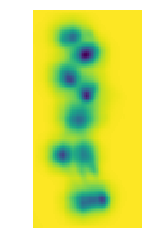

0176


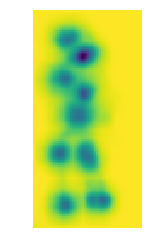

0177


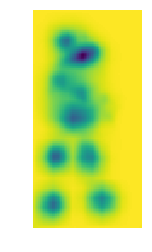

0178


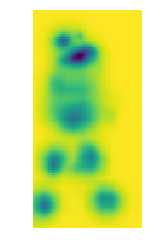

0179


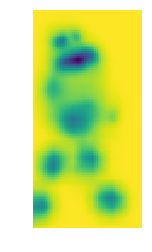

0180


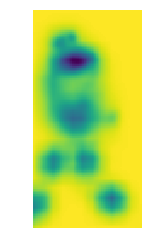

0181


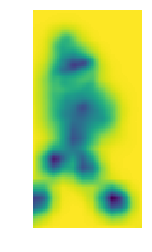

0001


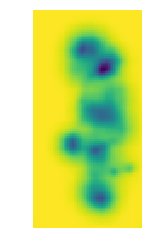

0002


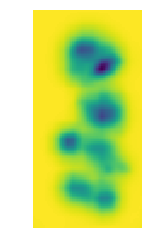

0003


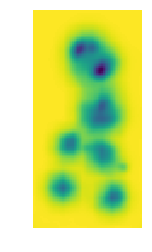

0004


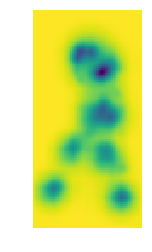

0005


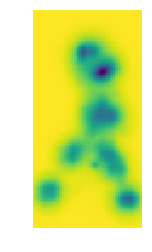

0006


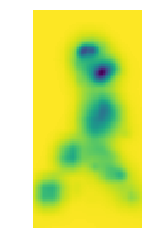

0007


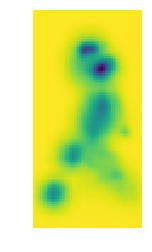

0008


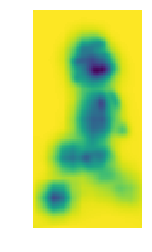

0009


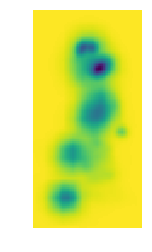

0010


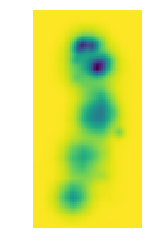

0011


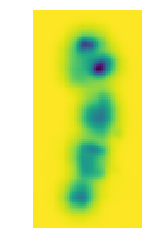

0012


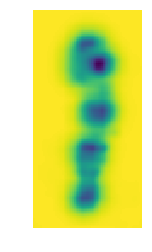

0013


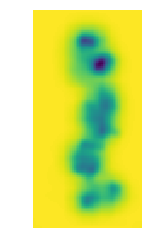

0014


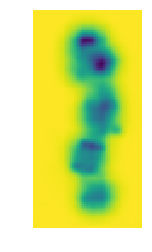

0015


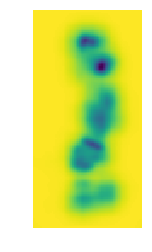

0016


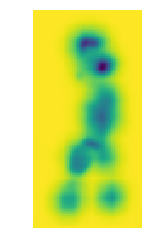

0017


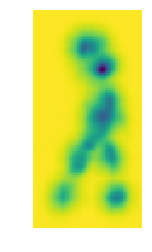

0018


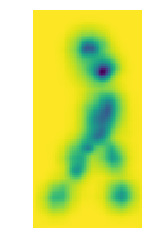

0019


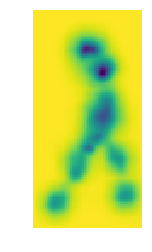

0020


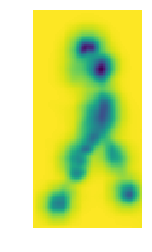

0021


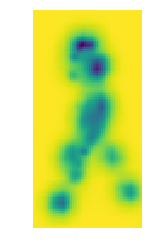

0022


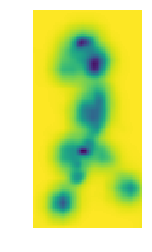

0023


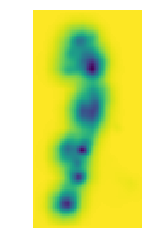

0024


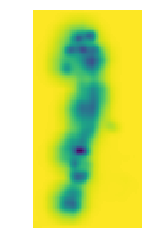

0025


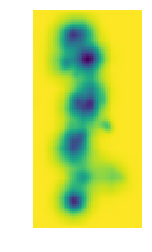

0026


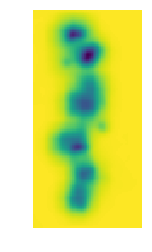

0027


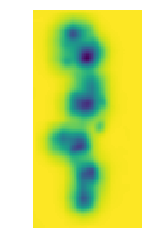

0028


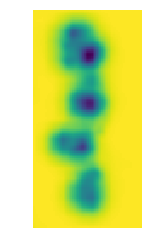

0029


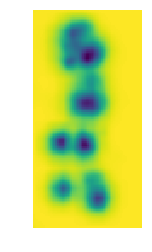

0030


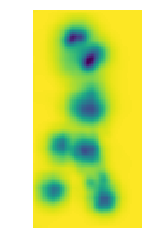

0031


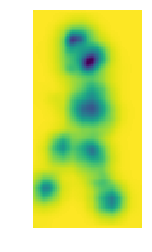

0032


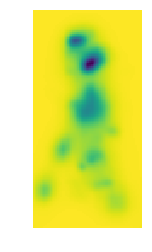

0033


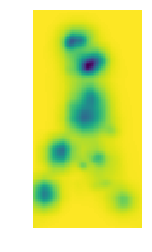

0034


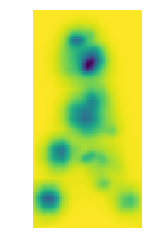

0035


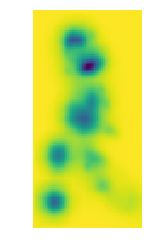

0036


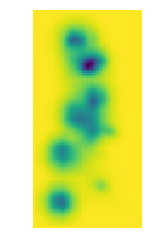

0037


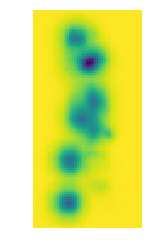

0038


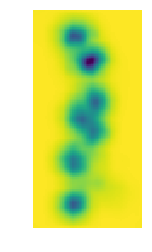

0039


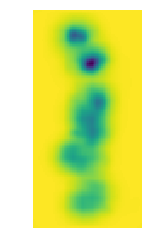

0040


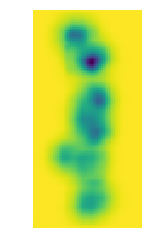

0041


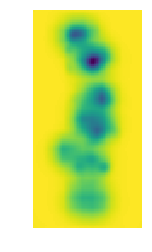

0042


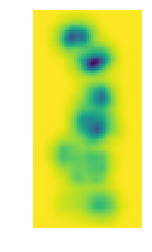

0043


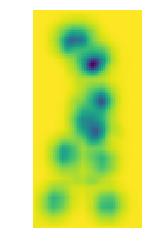

0044


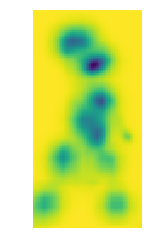

0045


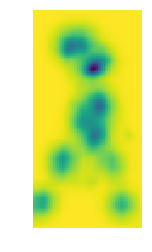

0046


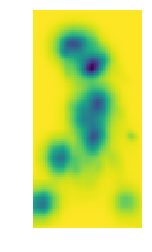

0047


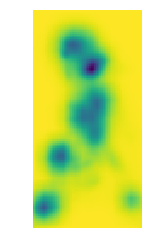

0048


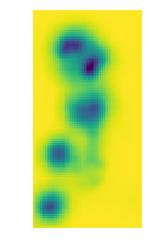

0049


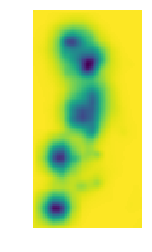

0050


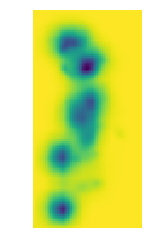

0051


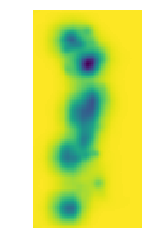

0052


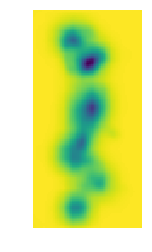

0053


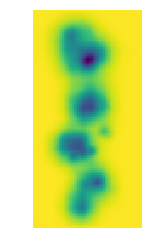

0054


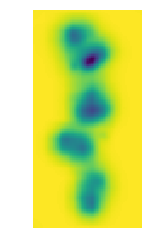

0055


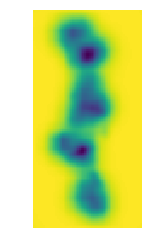

0056


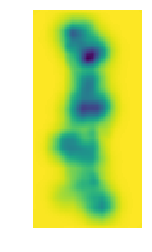

0057


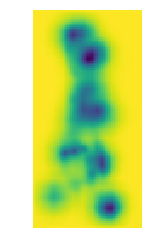

0058


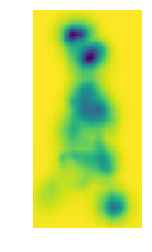

0059


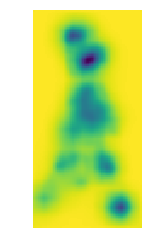

0060


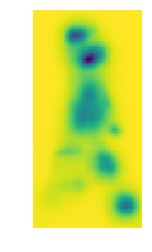

0061


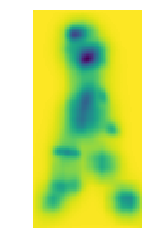

0062


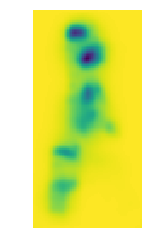

0063


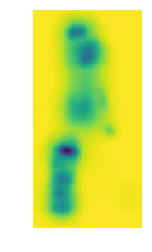

0064


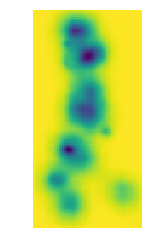

0065


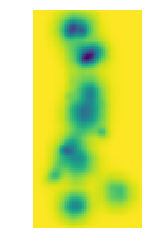

0066


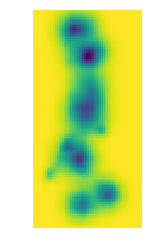

0067


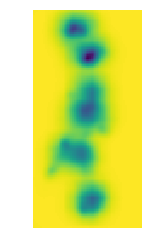

0068


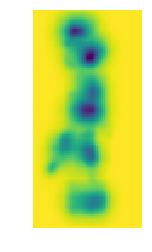

0069


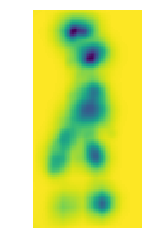

0070


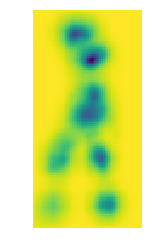

0071


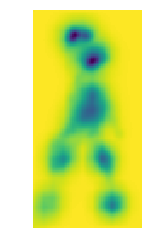

0072


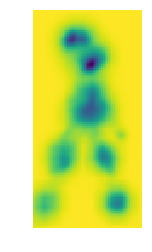

0073


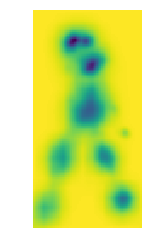

0074


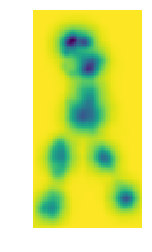

0075


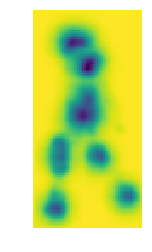

0076


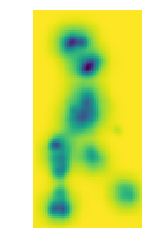

0077


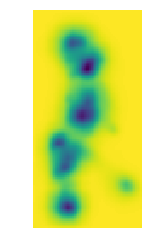

0078


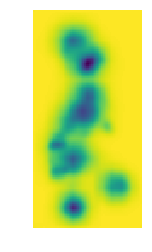

0079


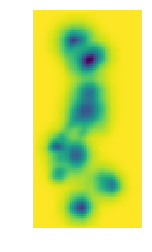

0080


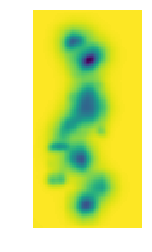

0081


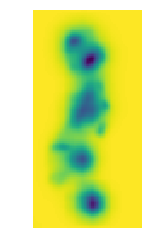

0082


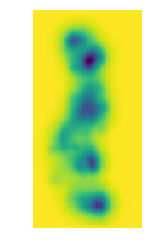

0083


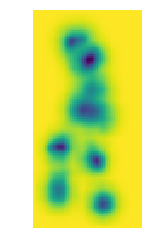

0084


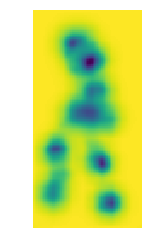

0085


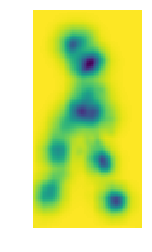

0086


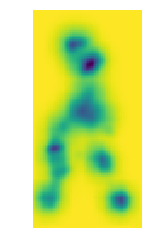

0087


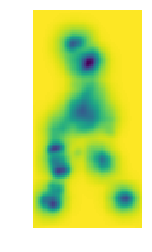

0088


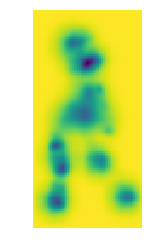

0089


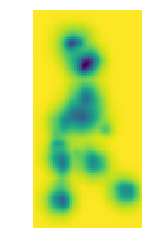

0090


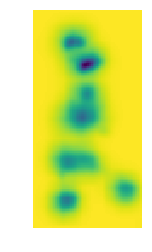

0091


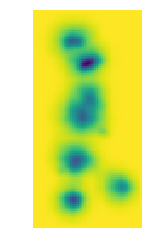

0092


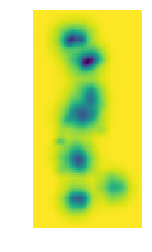

0093


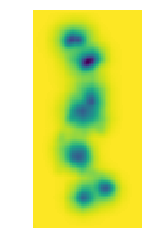

0094


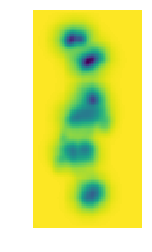

0095


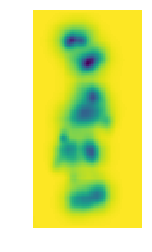

0096


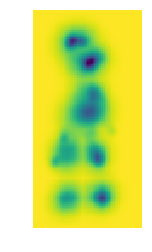

0097


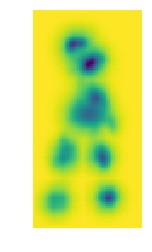

0098


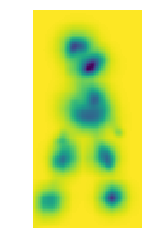

0099


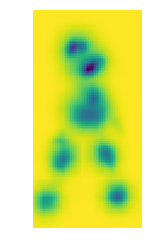

0100


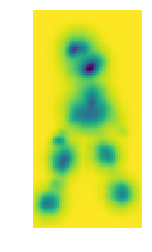

0101


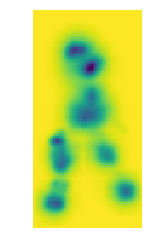

0102


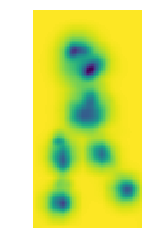

0103


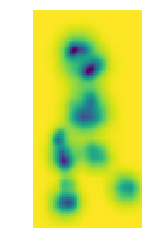

0104


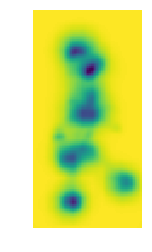

0105


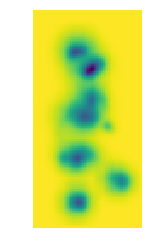

0106


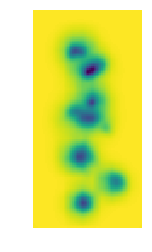

0107


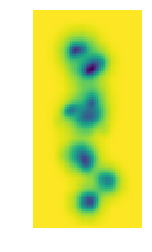

0108


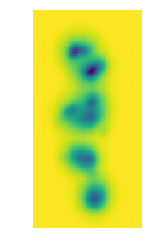

0109


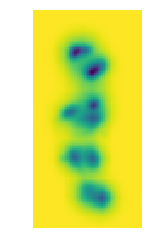

0110


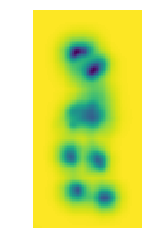

0111


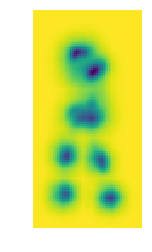

0112


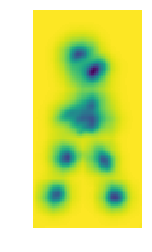

0113


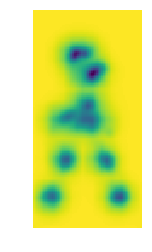

0114


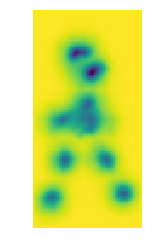

0115


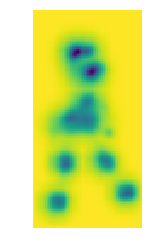

0116


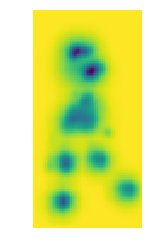

0117


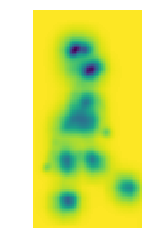

0118


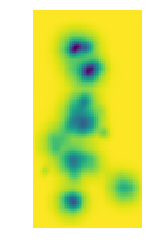

0119


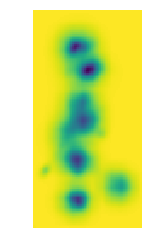

0120


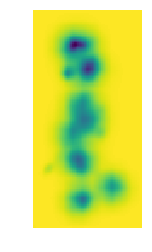

0121


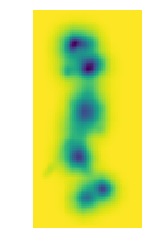

0122


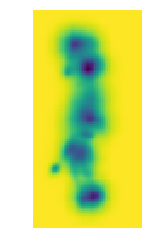

0123


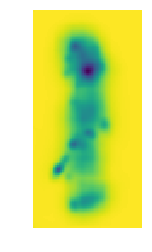

0124


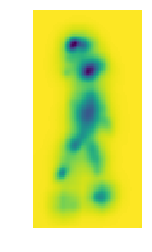

0125


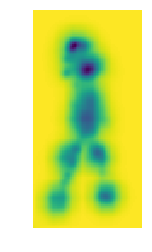

0126


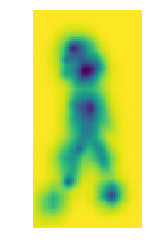

0127


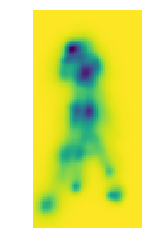

0128


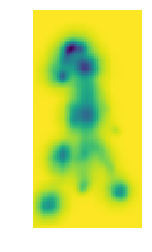

0129


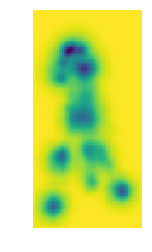

0130


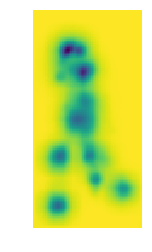

0131


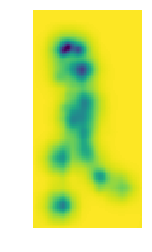

0132


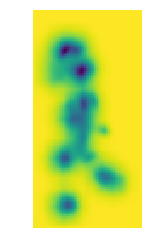

0133


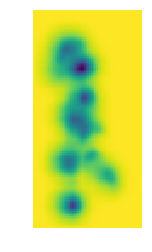

0134


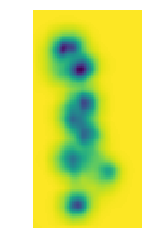

0135


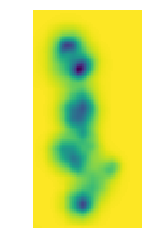

0136


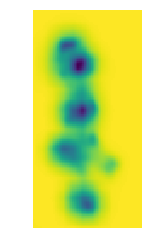

0137


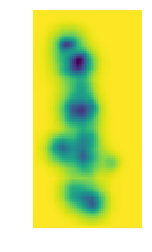

0138


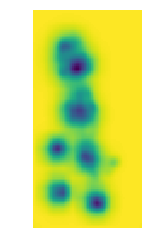

0139


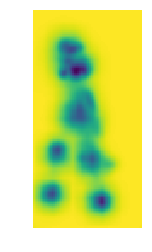

0140


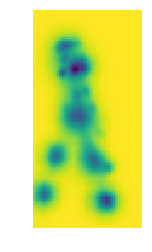

0141


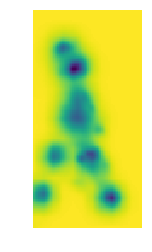

0142


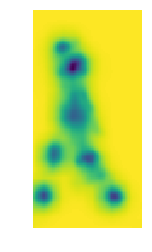

0143


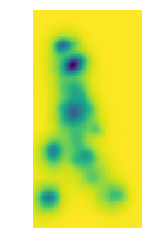

0144


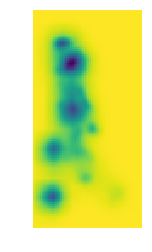

0145


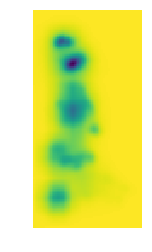

0146


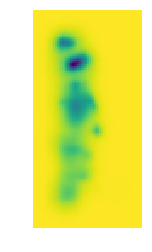

0147


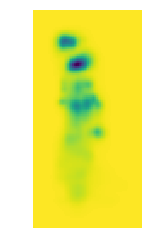

0148


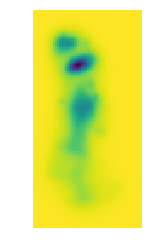

0149


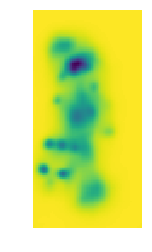

0150


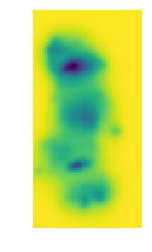

0151


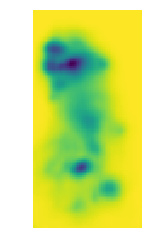

0152


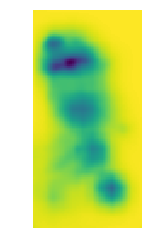

0153


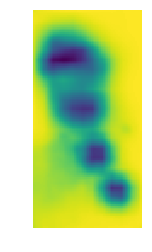

0154


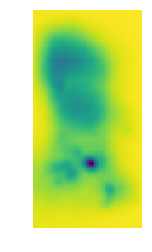

0001


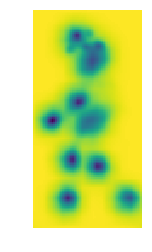

0002


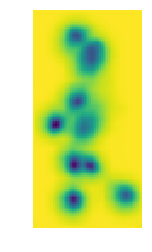

0003


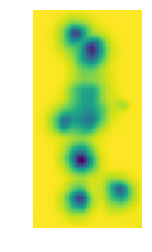

0004


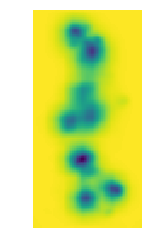

0005


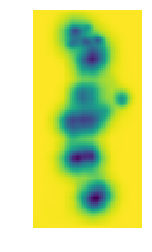

0006


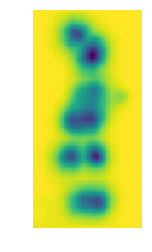

0007


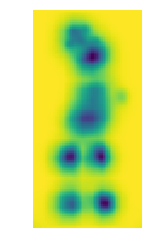

0008


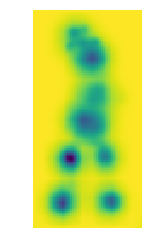

0009


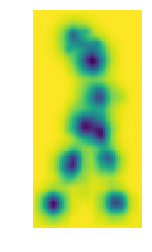

0010


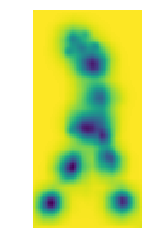

0011


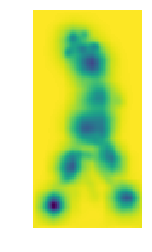

0012


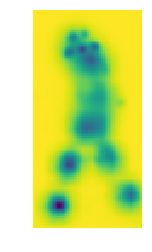

0013


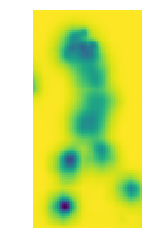

0014


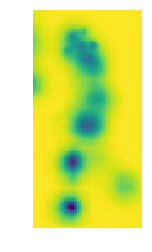

0015


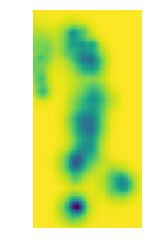

0016


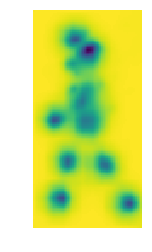

0017


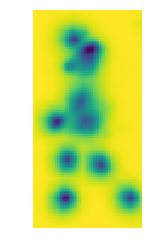

0018


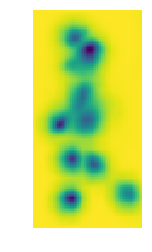

0019


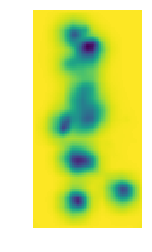

0020


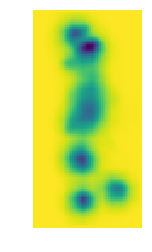

0021


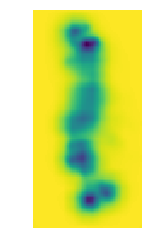

0022


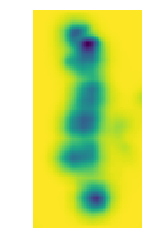

0023


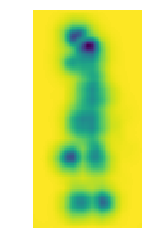

0024


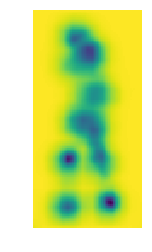

0025


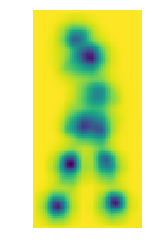

0026


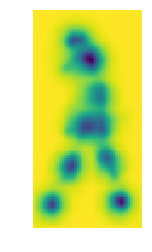

0027


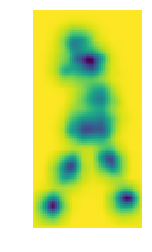

0028


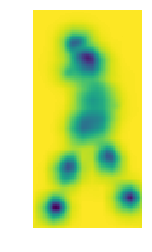

0029


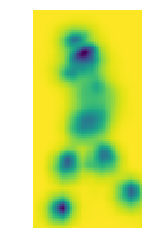

0030


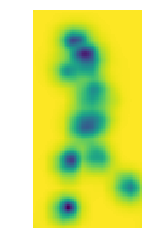

0031


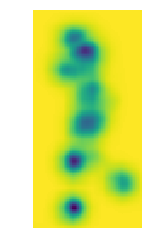

0032


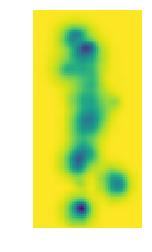

0033


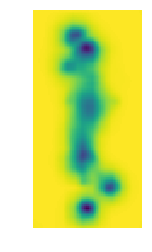

0034


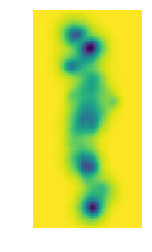

0035


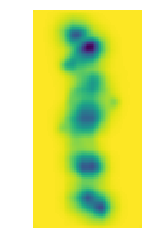

0036


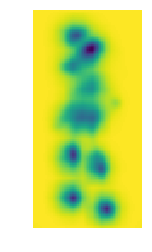

0037


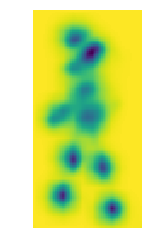

0038


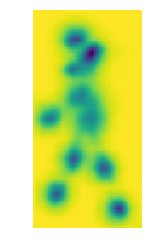

0039


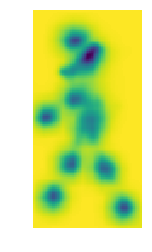

0040


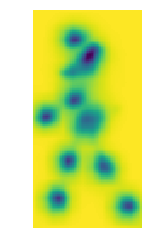

0041


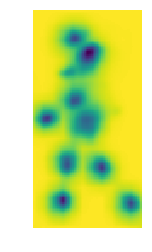

0042


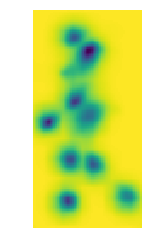

0043


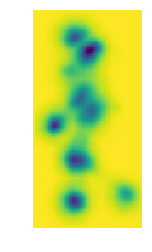

0044


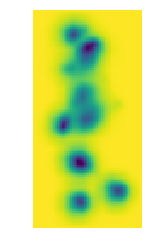

0045


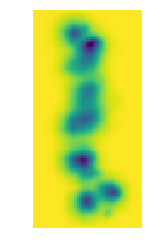

0046


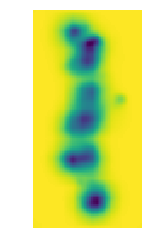

0047


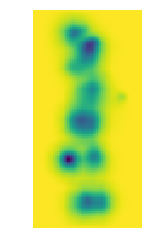

0048


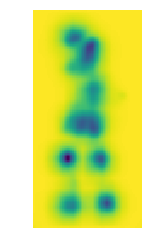

0049


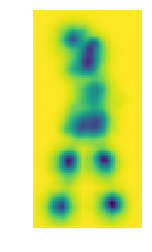

0050


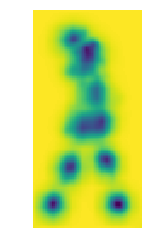

0051


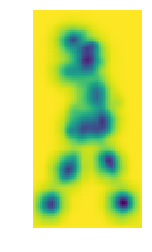

0052


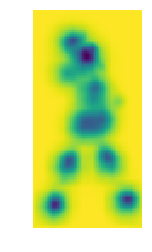

0053


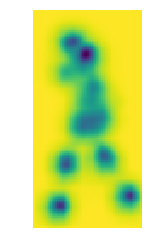

0054


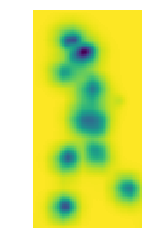

0055


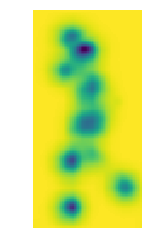

0056


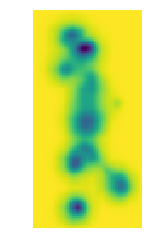

0057


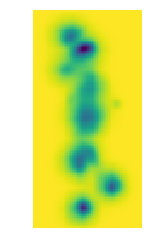

0058


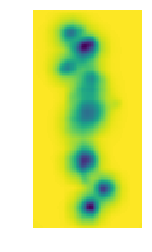

0059


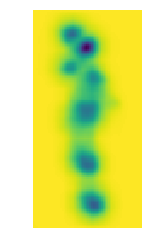

0060


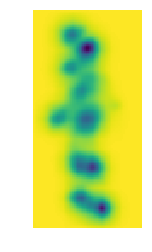

0061


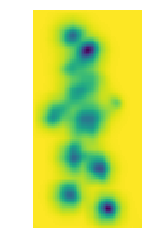

0062


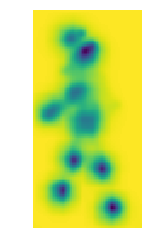

0063


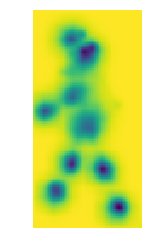

0064


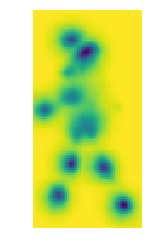

0065


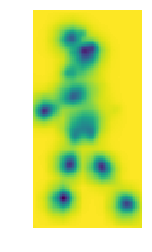

0066


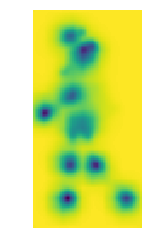

0067


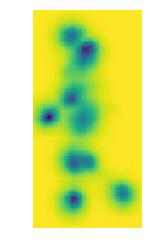

0068


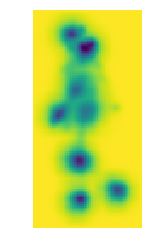

0069


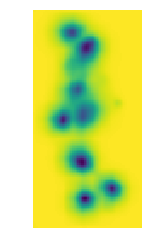

0070


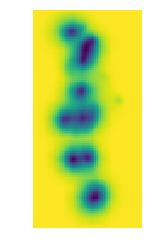

0071


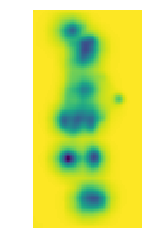

0072


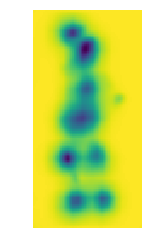

0073


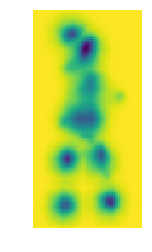

0074


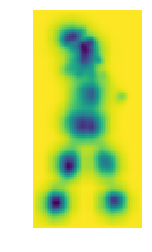

0075


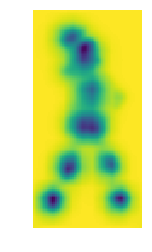

0076


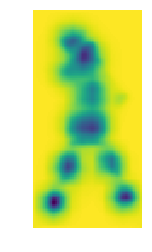

0077


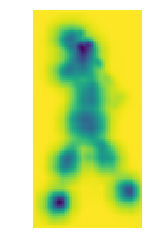

0078


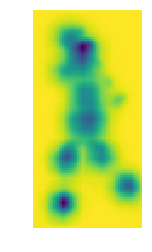

0079


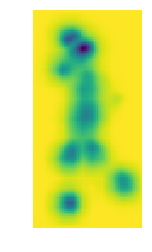

0080


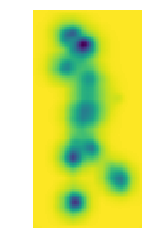

0081


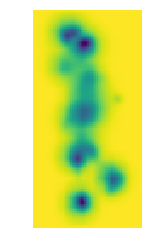

0082


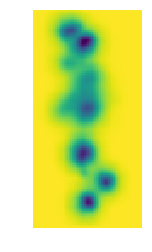

0083


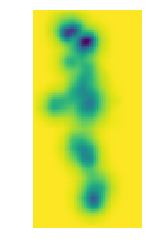

0084


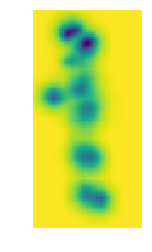

0085


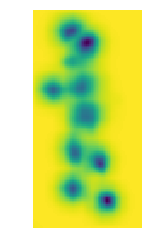

0086


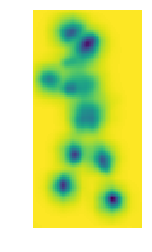

0087


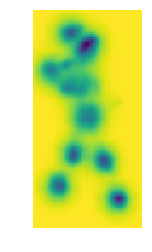

0088


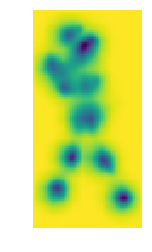

0089


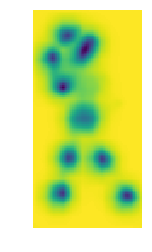

0090


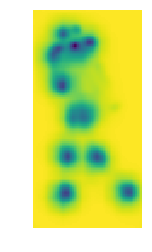

0091


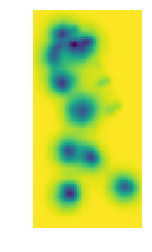

0092


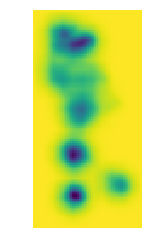

0093


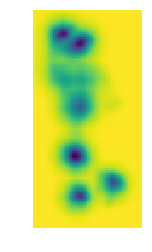

0094


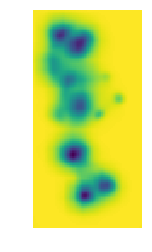

0095


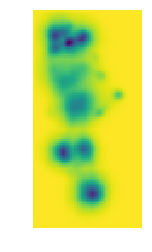

0096


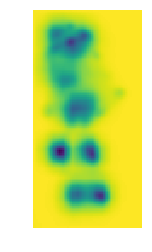

0097


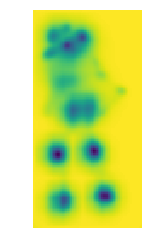

0098


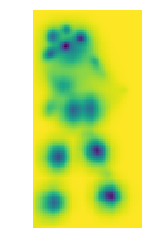

0099


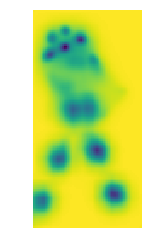

0100


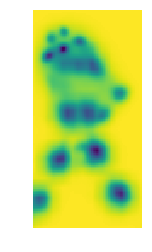

0101


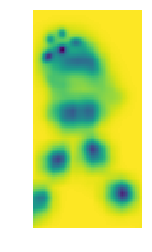

0102


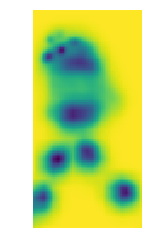

0001


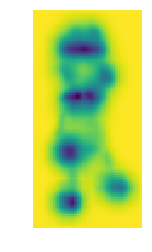

0002


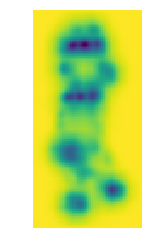

0003


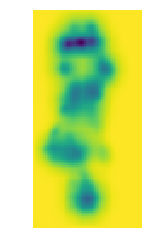

0004


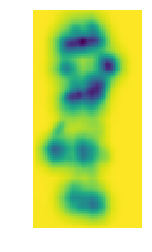

0005


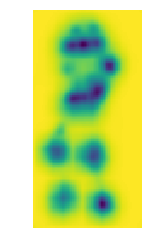

0006


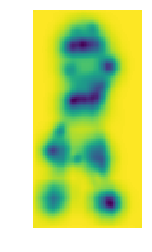

0007


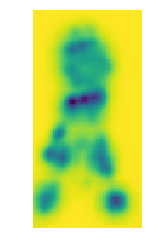

0008


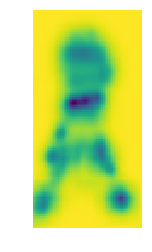

0009


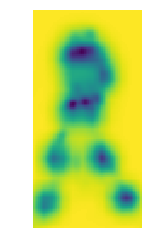

0010


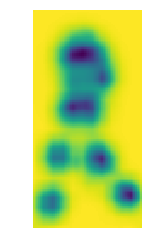

0011


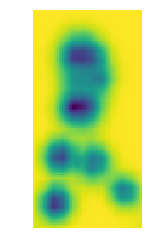

0012


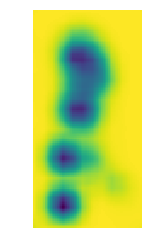

0013


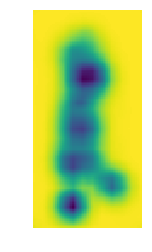

0014


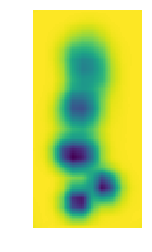

0015


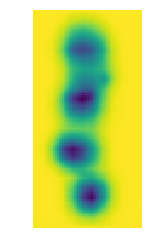

0016


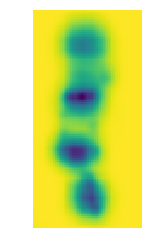

0017


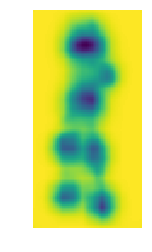

0018


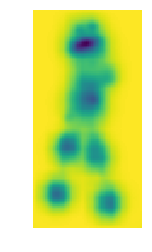

0019


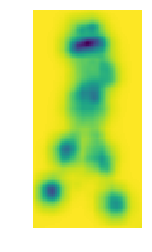

0020


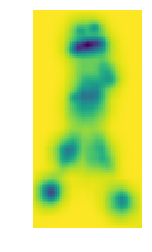

0021


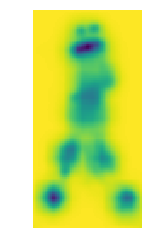

0022


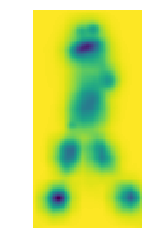

0023


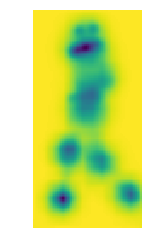

0024


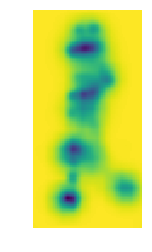

0025


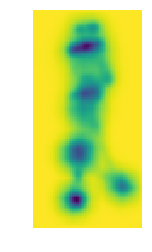

0026


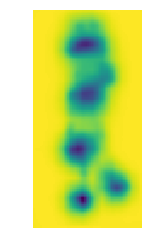

0027


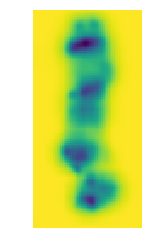

0028


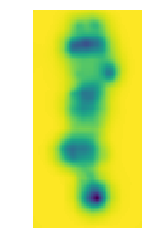

0029


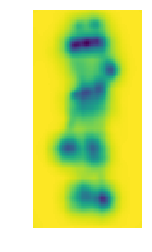

0030


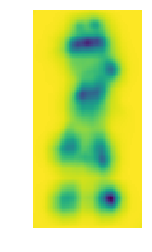

0031


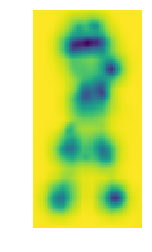

0032


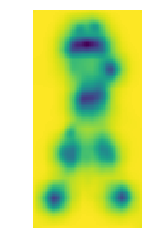

0033


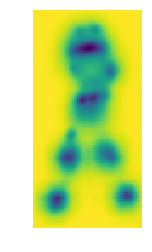

0034


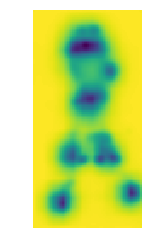

0035


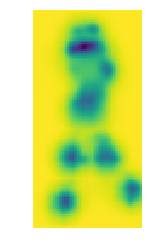

0036


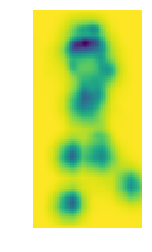

0037


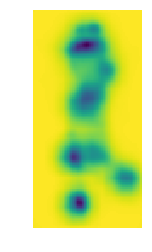

0038


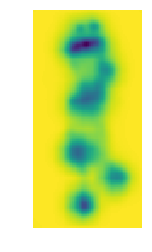

0039


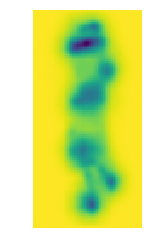

0040


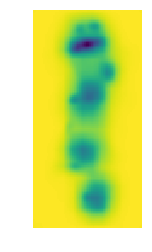

0041


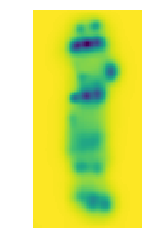

0042


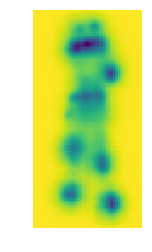

0043


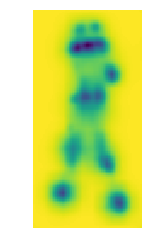

0044


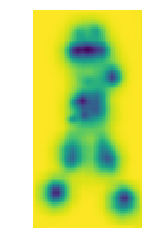

0045


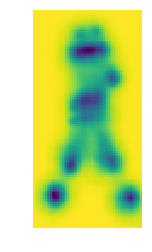

0046


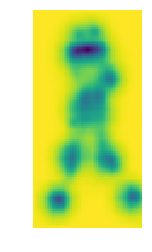

0047


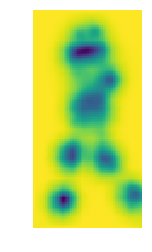

0048


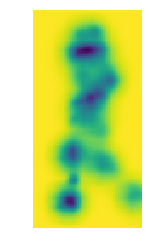

0049


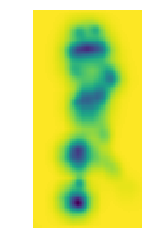

0050


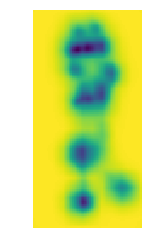

0051


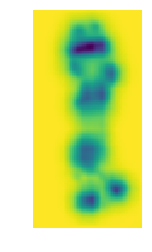

0052


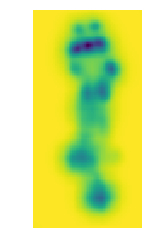

0053


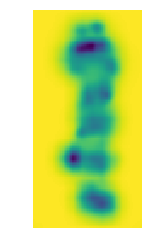

0054


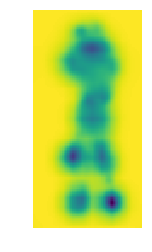

0055


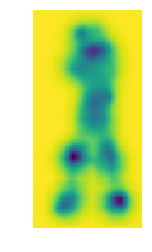

0056


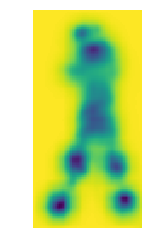

0057


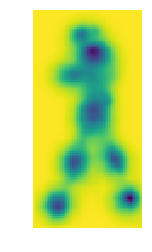

0058


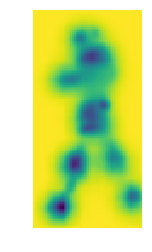

0059


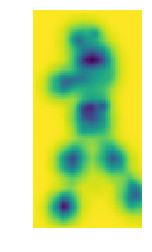

0060


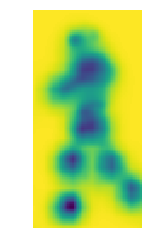

0061


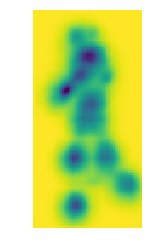

0062


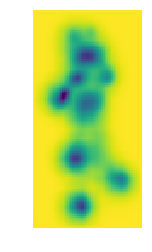

0063


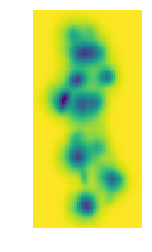

0064


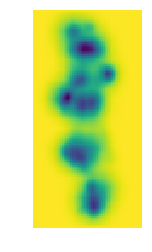

0065


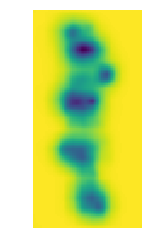

0066


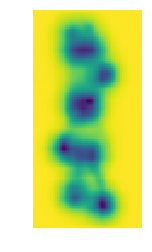

0067


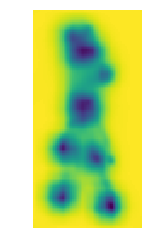

0068


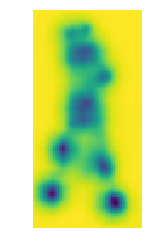

0069


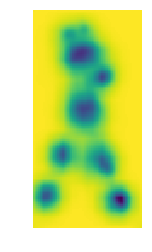

0070


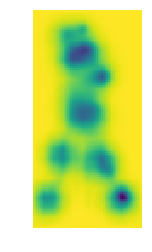

0071


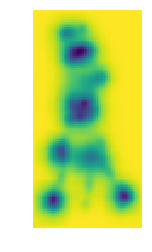

0072


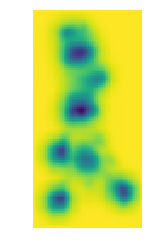

0073


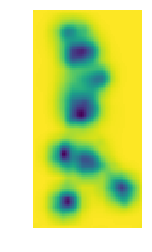

0074


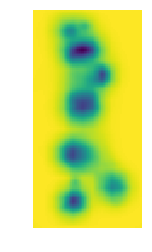

0075


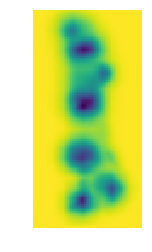

0076


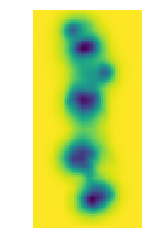

0077


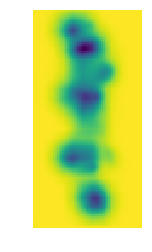

0078


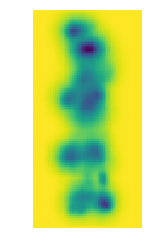

0079


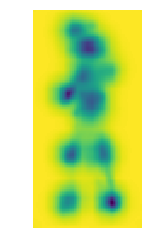

0080


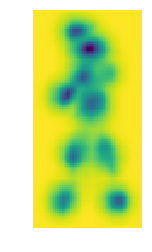

0081


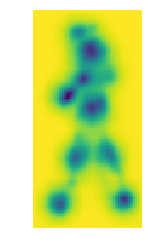

0082


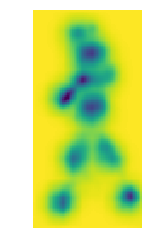

0083


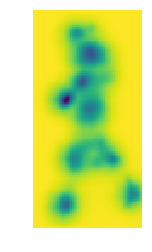

0084


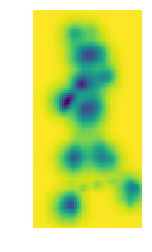

0085


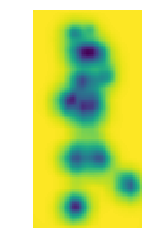

0086


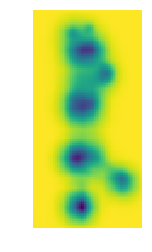

0087


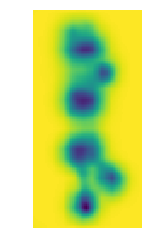

0088


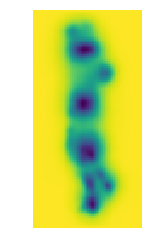

0089


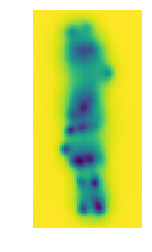

0090


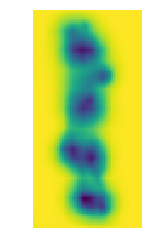

0091


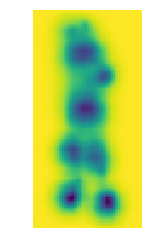

0092


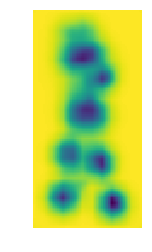

0093


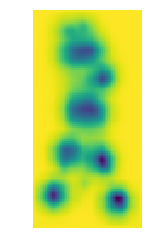

0094


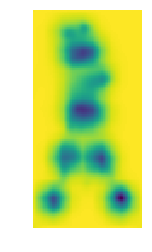

0095


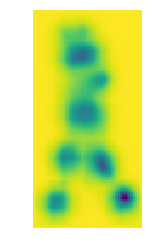

0096


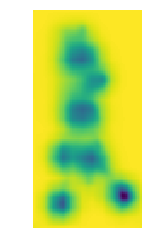

0097


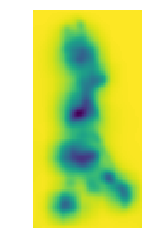

0098


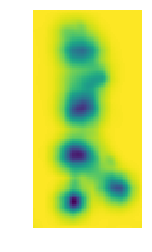

0099


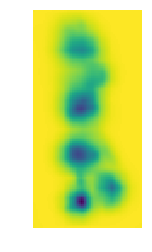

0100


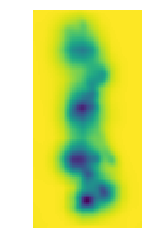

0101


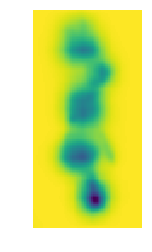

0102


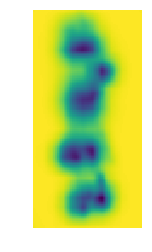

0103


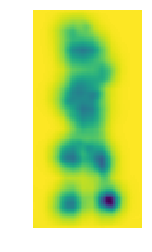

0104


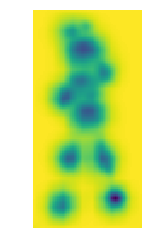

0105


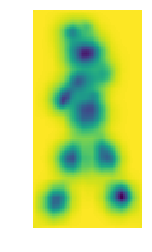

0106


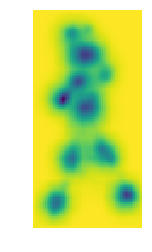

0107


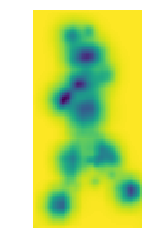

0108


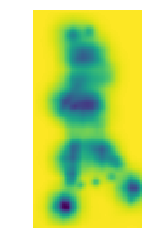

0109


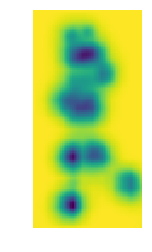

0110


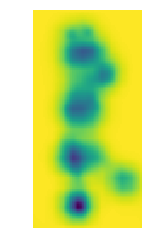

0111


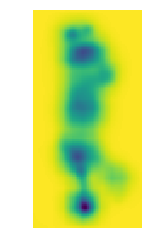

0112


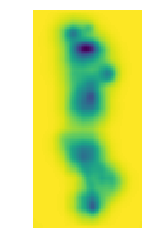

0113


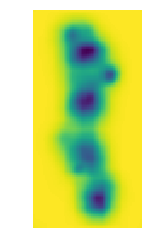

0114


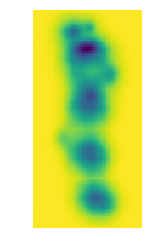

0115


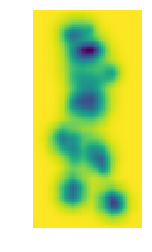

0116


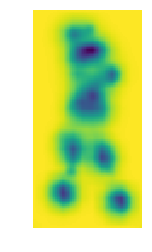

0117


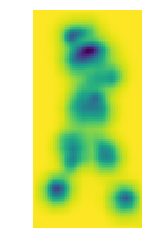

0118


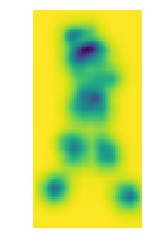

0119


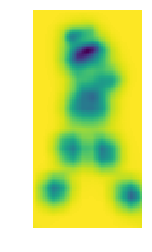

0120


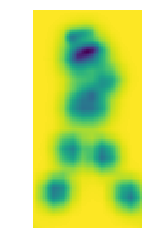

0121


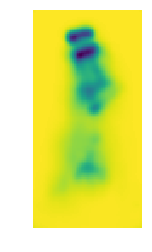

0001


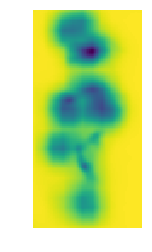

0002


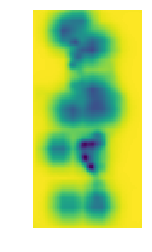

0003


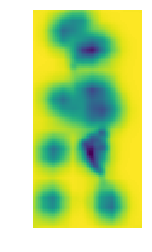

0004


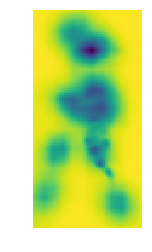

0005


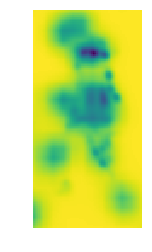

0006


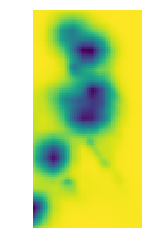

0007


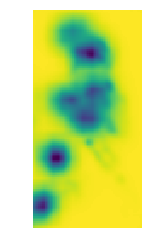

0008


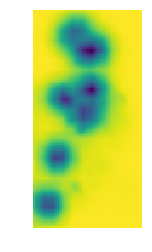

0009


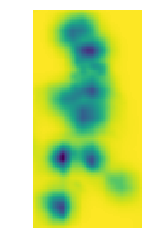

0010


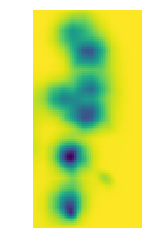

0011


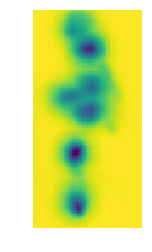

0012


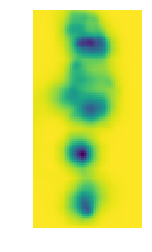

0013


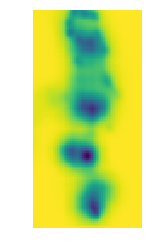

0014


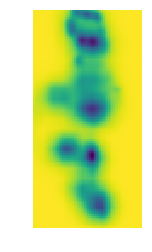

0015


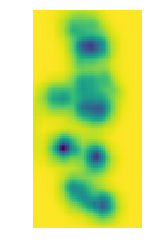

0016


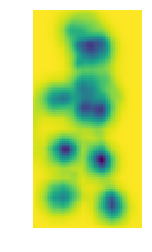

0017


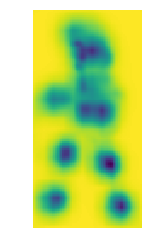

0018


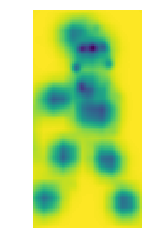

0019


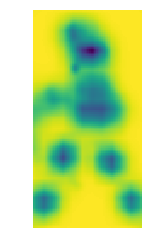

0020


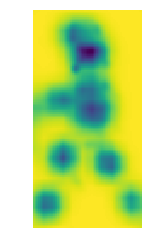

0021


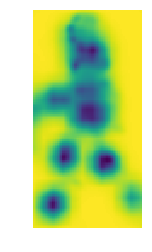

0022


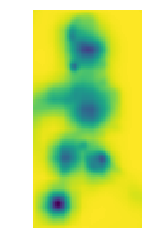

0023


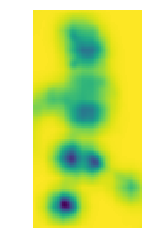

0024


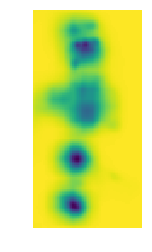

0025


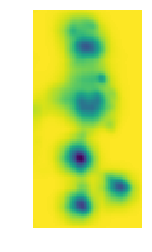

0026


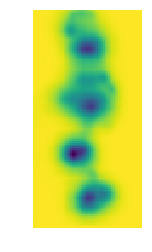

0027


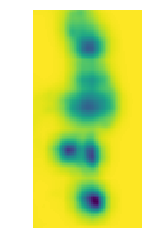

0028


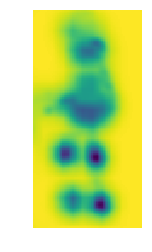

0029


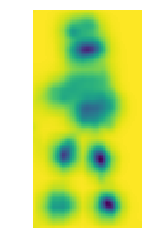

0030


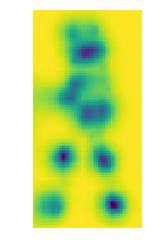

0031


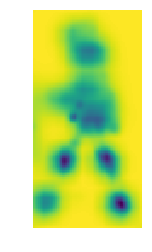

0032


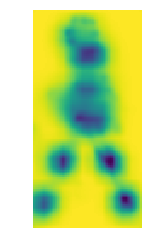

0033


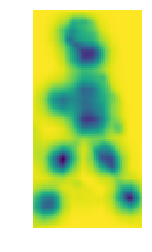

0034


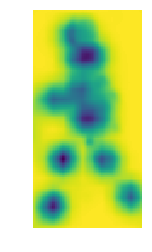

0035


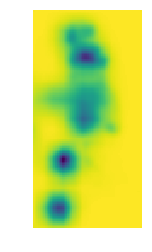

0036


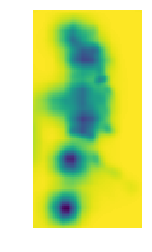

0037


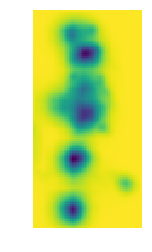

0038


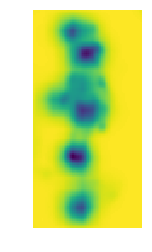

0039


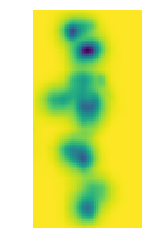

0040


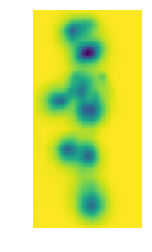

0041


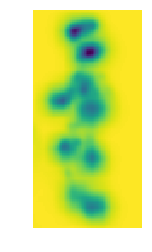

0042


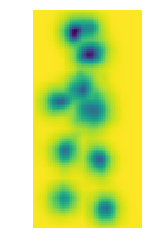

0043


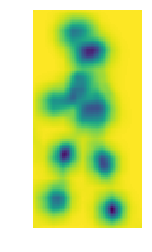

0044


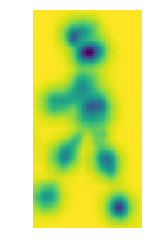

0045


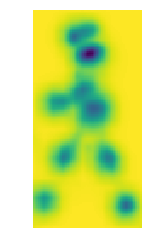

0046


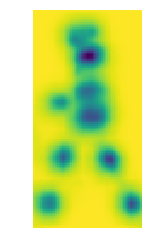

0047


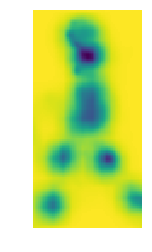

0048


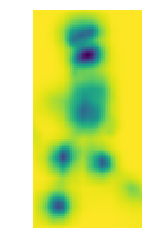

0049


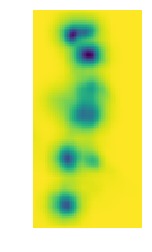

0050


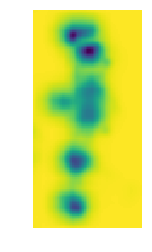

0051


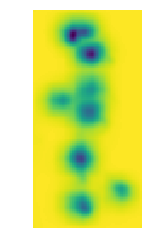

0052


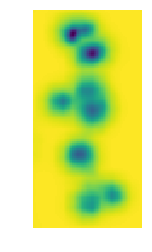

0053


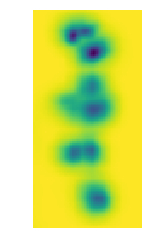

0054


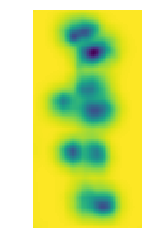

0055


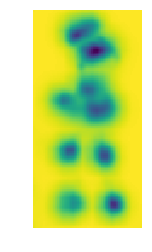

0056


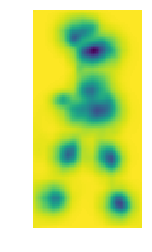

0057


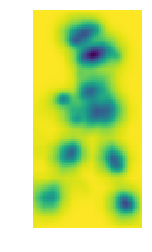

0058


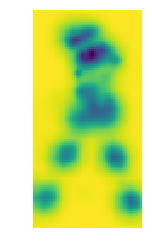

0059


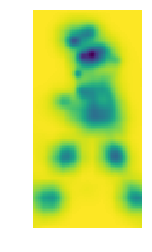

0060


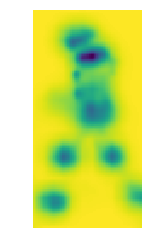

0061


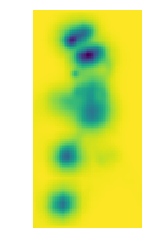

0062


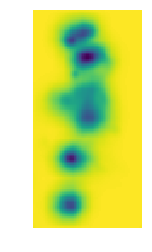

0063


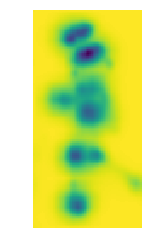

0064


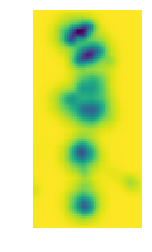

0065


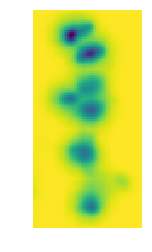

0066


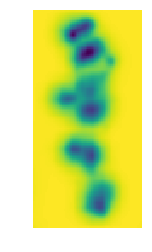

0067


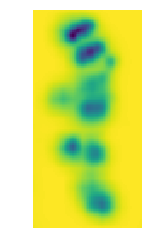

0068


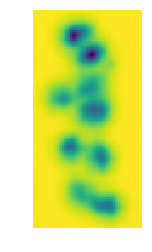

0069


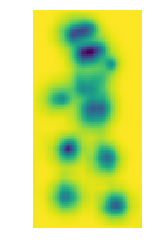

0070


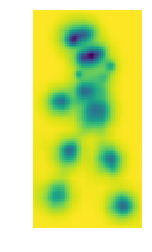

0071


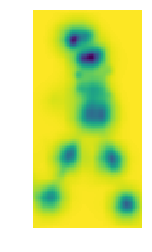

0072


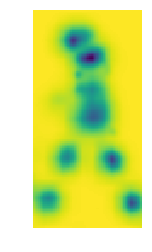

0073


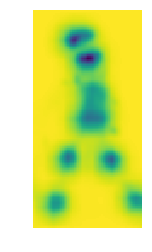

0074


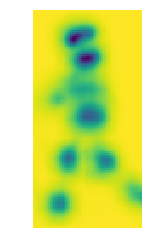

0075


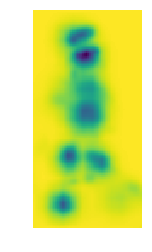

0076


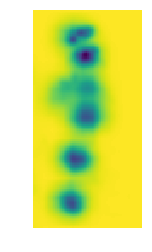

0077


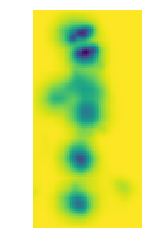

0078


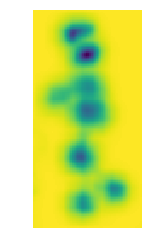

0079


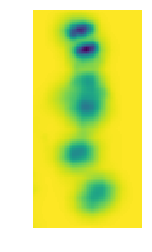

0080


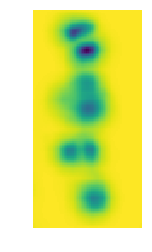

0081


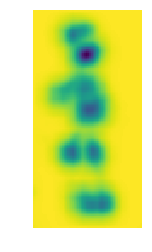

0082


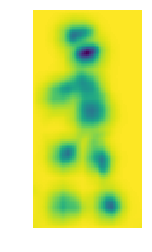

0083


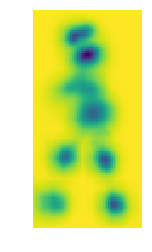

0084


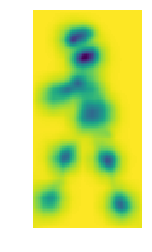

0085


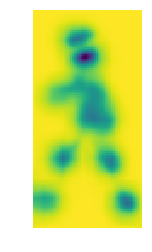

0086


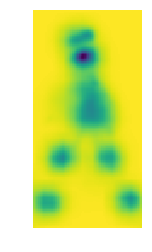

0087


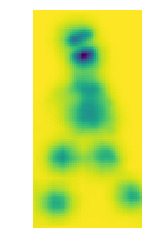

0088


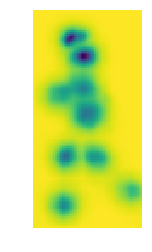

0089


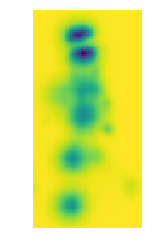

0090


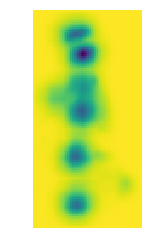

0091


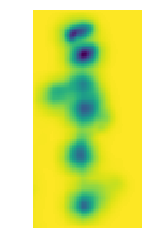

0092


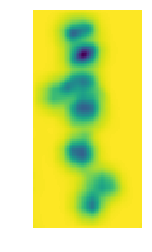

0093


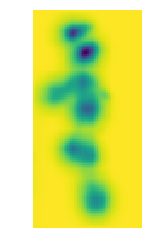

0094


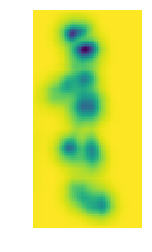

0095


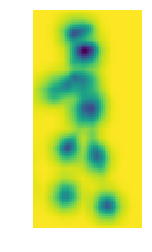

0096


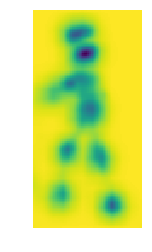

0097


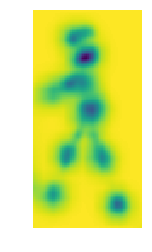

0098


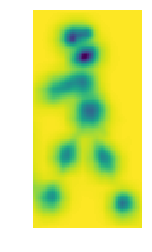

0099


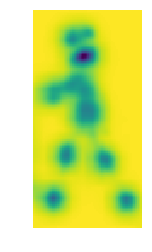

0100


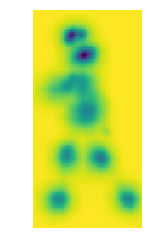

0101


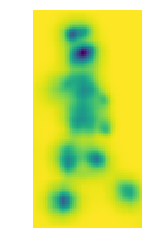

0102


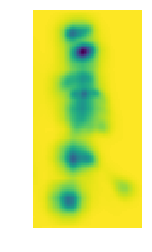

0103


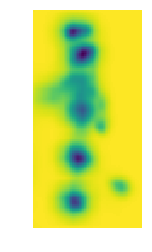

0104


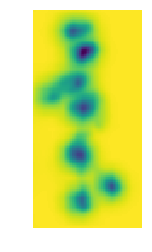

0105


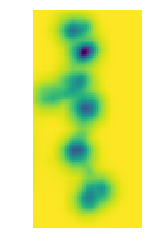

0106


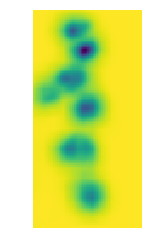

0107


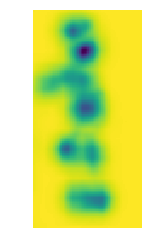

0108


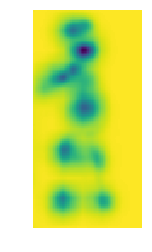

0109


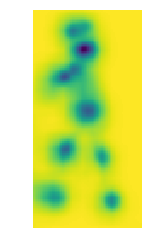

0110


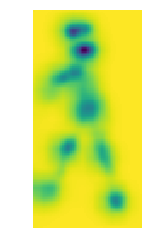

0111


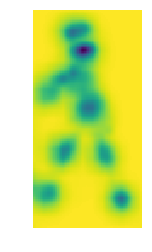

0112


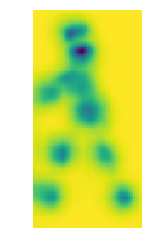

0113


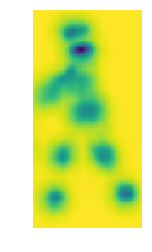

0114


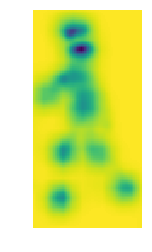

0115


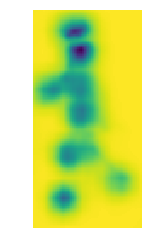

0116


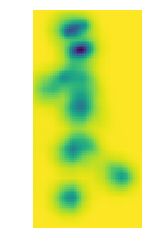

0117


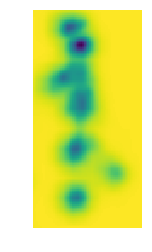

0118


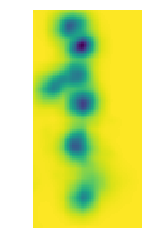

0119


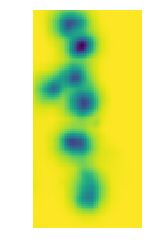

0120


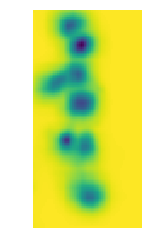

0121


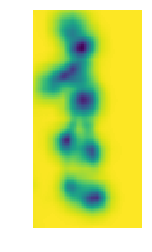

0122


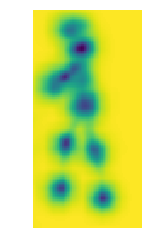

0123


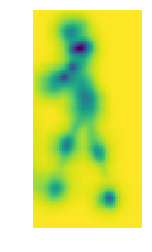

0124


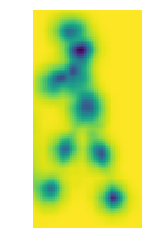

0125


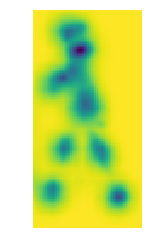

0126


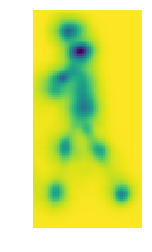

0127


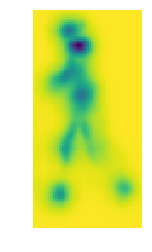

0128


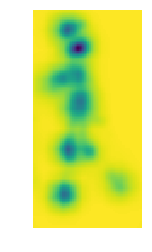

0129


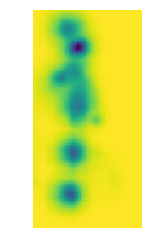

0130


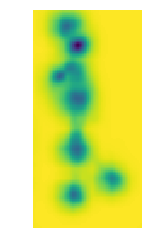

0131


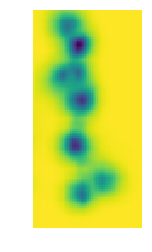

0132


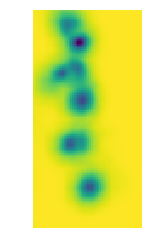

0133


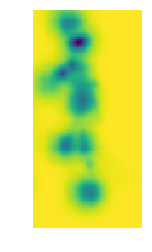

0134


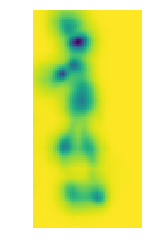

0135


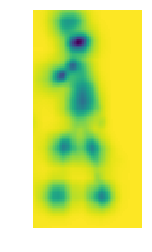

0136


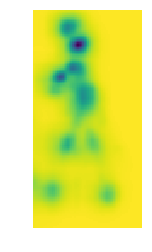

0137


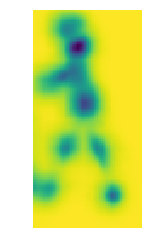

0138


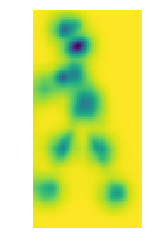

0139


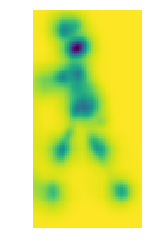

0140


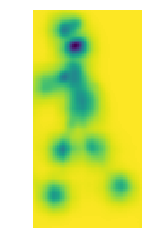

0141


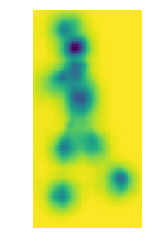

0142


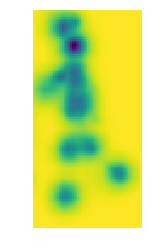

0143


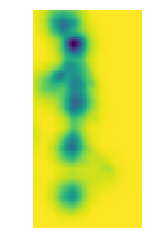

0144


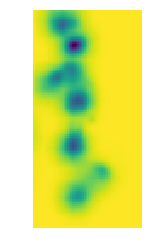

0145


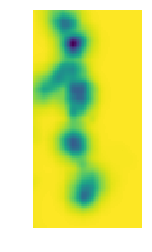

0146


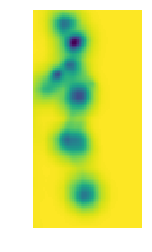

0147


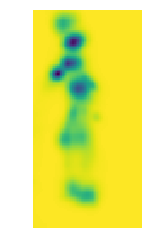

0148


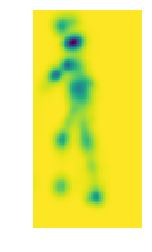

0149


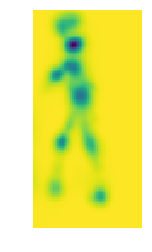

0150


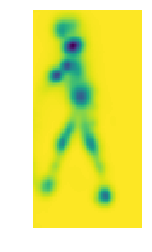

0151


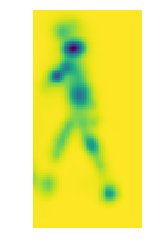

0152


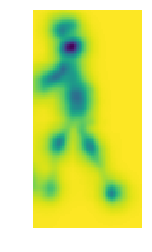

0153


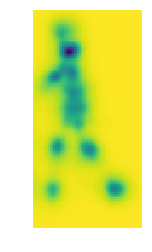

0154


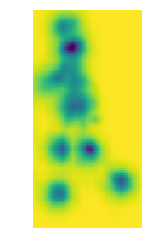

0155


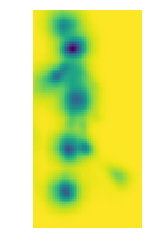

0156


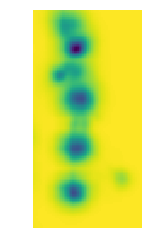

0157


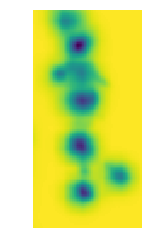

0158


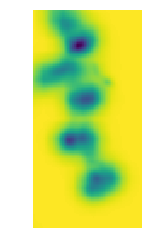

0159


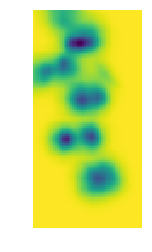

0160


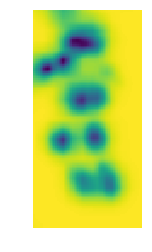

0161


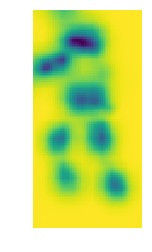

0162


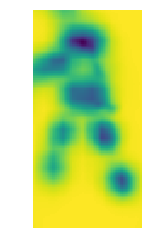

0163


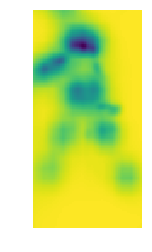

0001


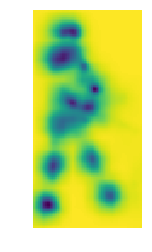

0002


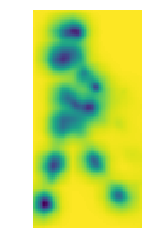

0003


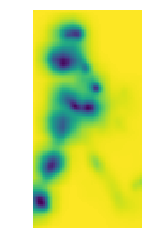

0004


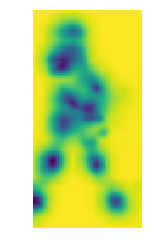

0005


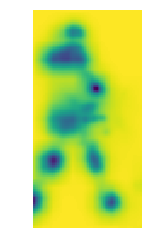

0006


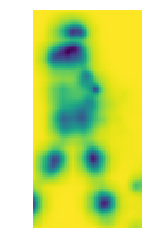

0007


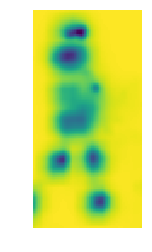

0008


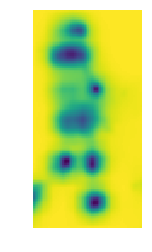

0009


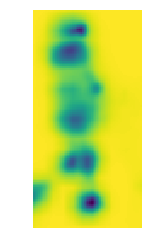

0010


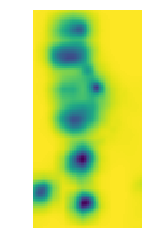

0011


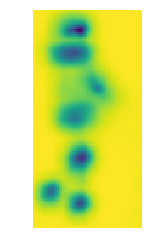

0012


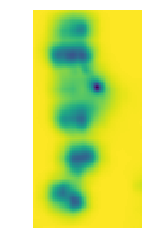

0013


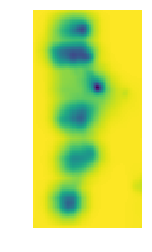

0014


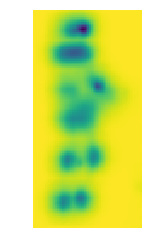

0015


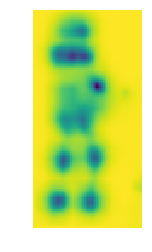

0016


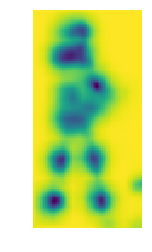

0017


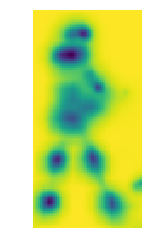

0018


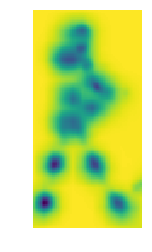

0019


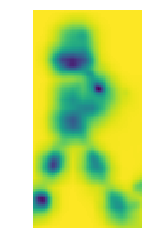

0020


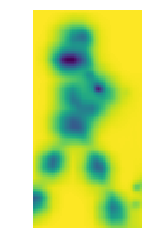

0021


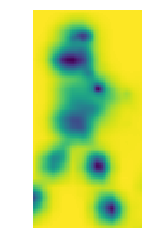

0022


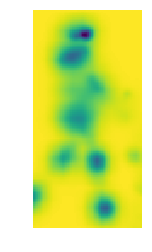

0023


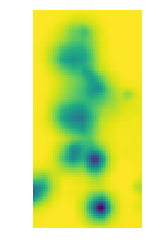

0024


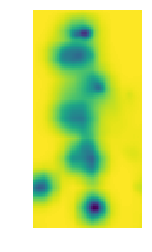

0025


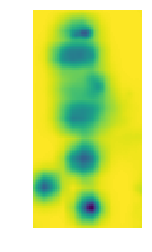

0026


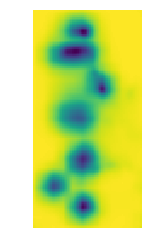

0027


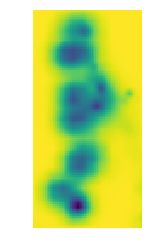

0028


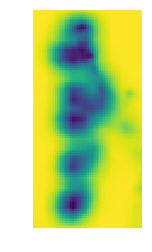

0029


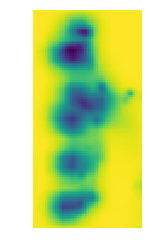

0030


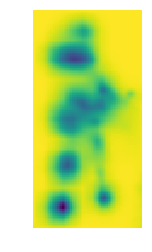

0031


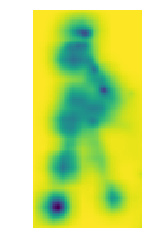

0032


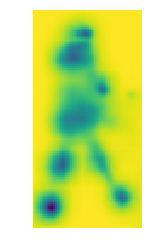

0033


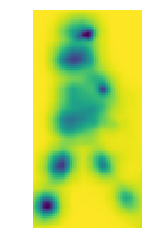

0034


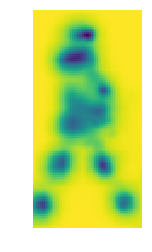

0035


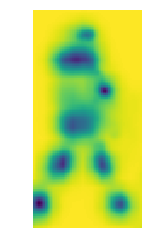

0036


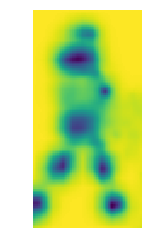

0037


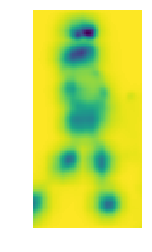

0038


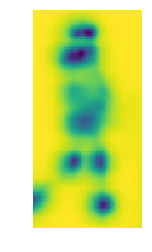

0039


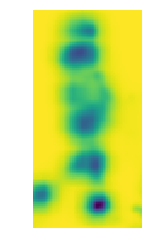

0040


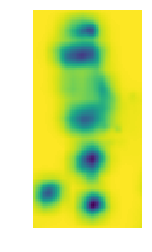

0041


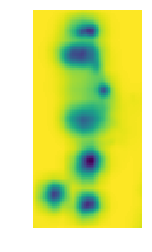

0042


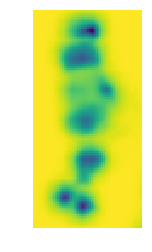

0043


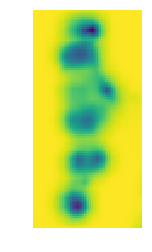

0044


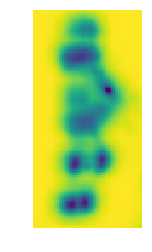

0045


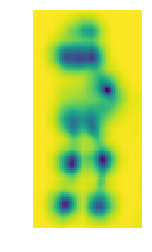

0046


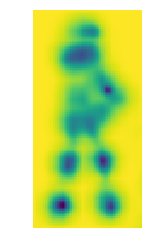

0047


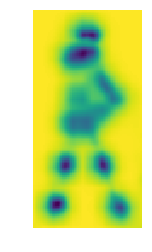

0048


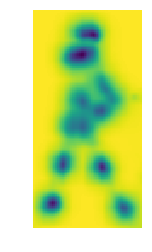

0049


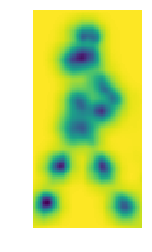

0050


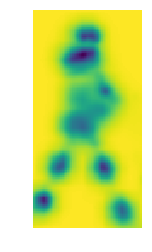

0051


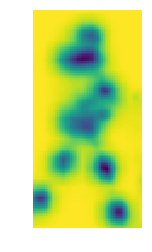

0052


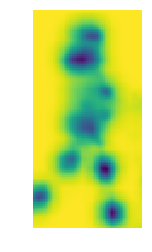

0053


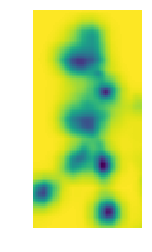

0054


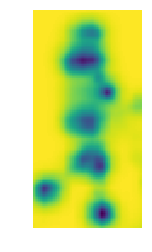

0055


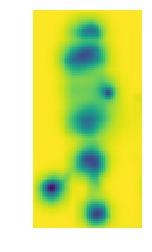

0056


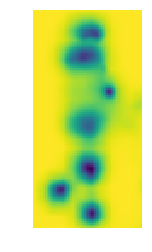

0057


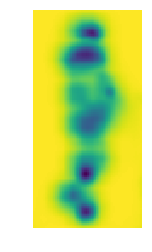

0058


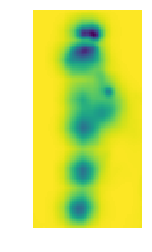

0059


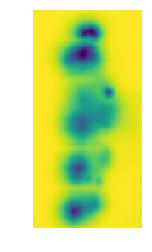

0060


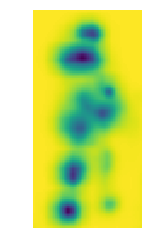

0061


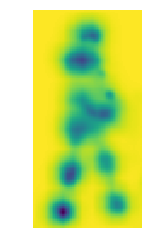

0062


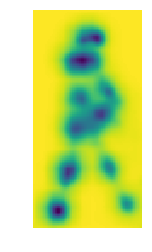

0063


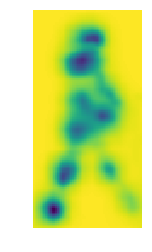

0064


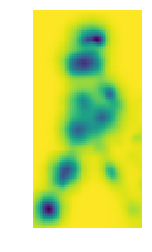

0065


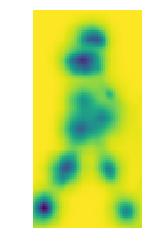

0066


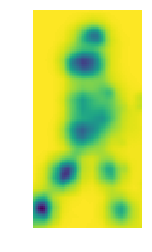

0067


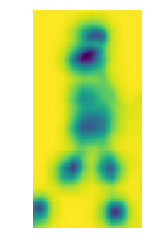

0068


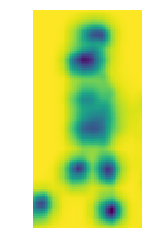

0069


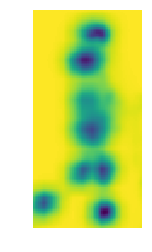

0070


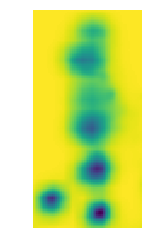

0071


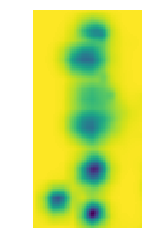

0072


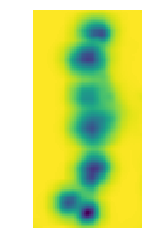

0073


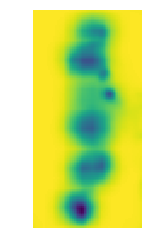

0074


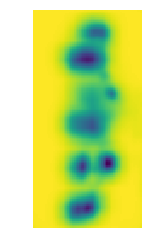

0075


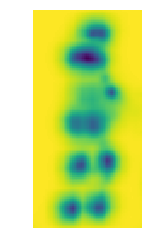

0076


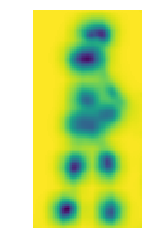

0077


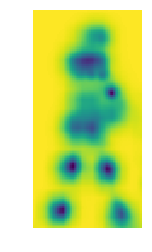

0078


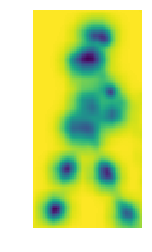

0079


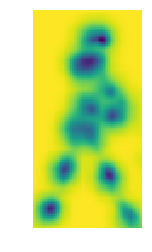

0080


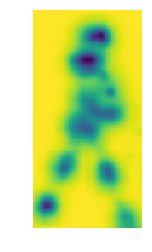

0081


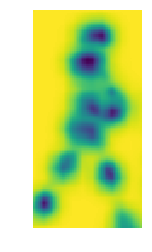

0082


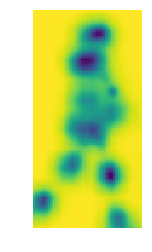

0083


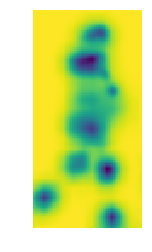

0084


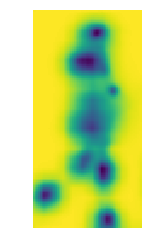

0085


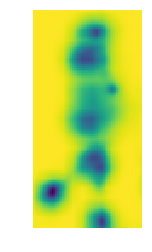

0086


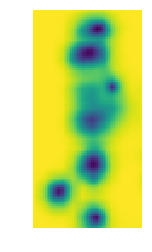

0087


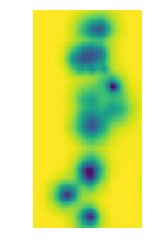

0088


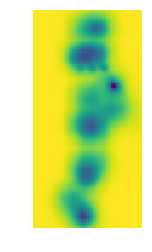

0089


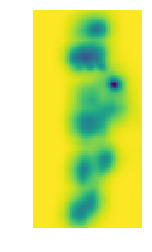

0090


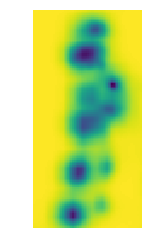

0091


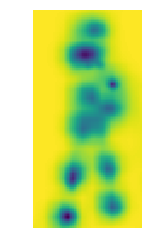

0092


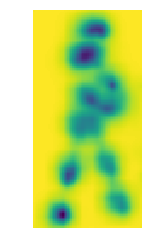

0093


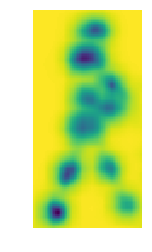

0094


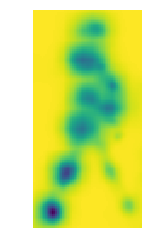

0095


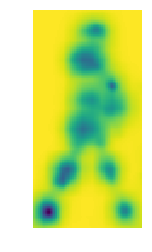

0096


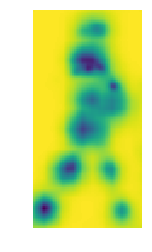

0097


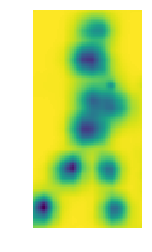

0098


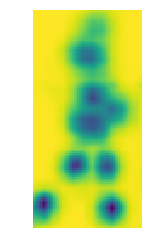

0099


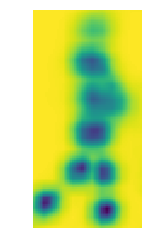

0100


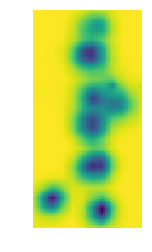

0101


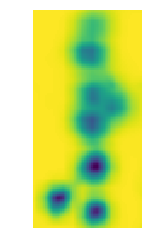

0102


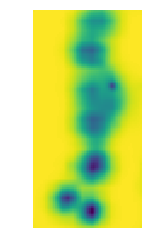

0103


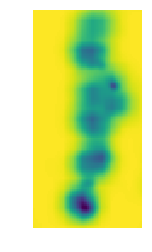

0104


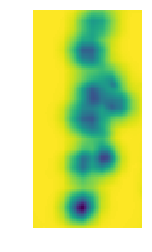

0105


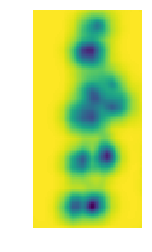

0106


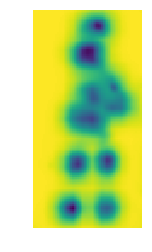

0107


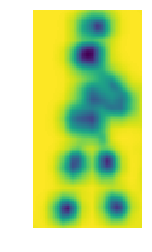

0108


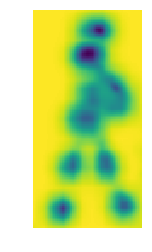

0109


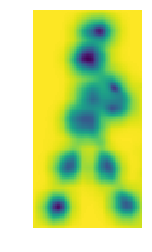

0110


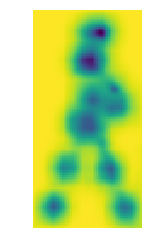

0111


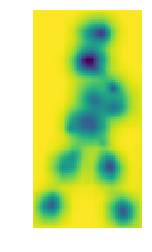

0112


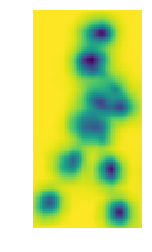

0113


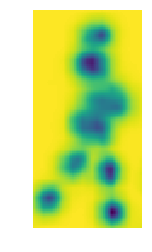

0114


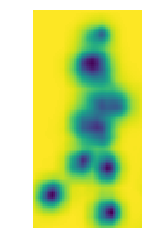

0115


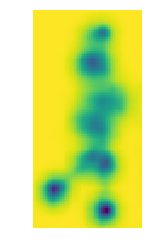

0116


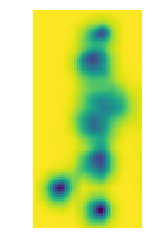

0117


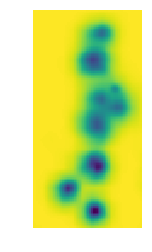

0118


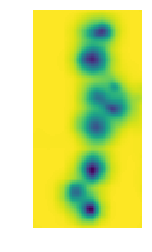

0119


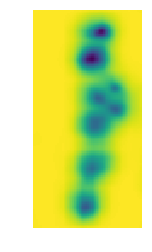

0120


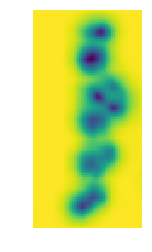

0121


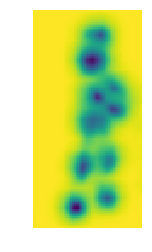

0122


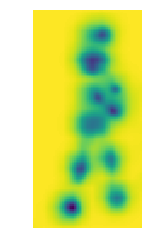

0123


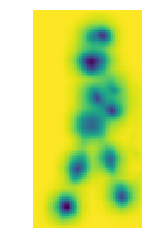

0124


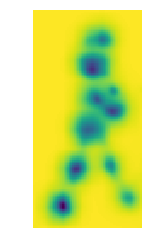

0125


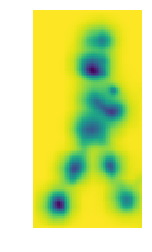

0126


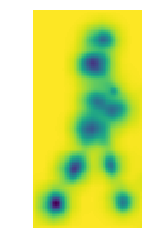

0127


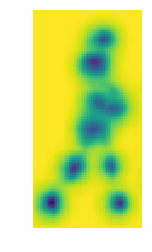

0128


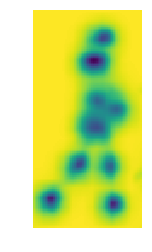

0129


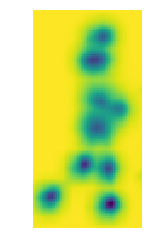

0130


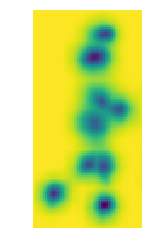

0131


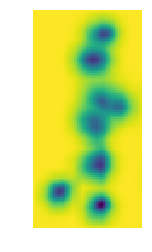

0132


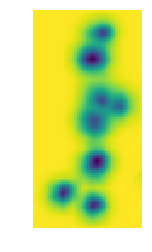

0133


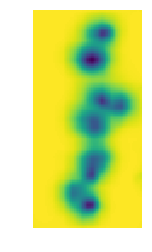

0134


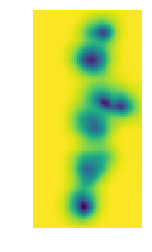

0135


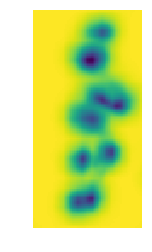

0136


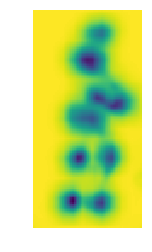

0137


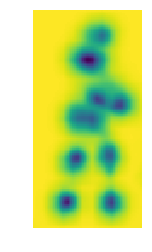

0138


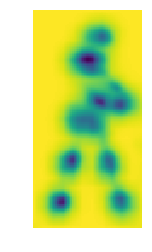

0139


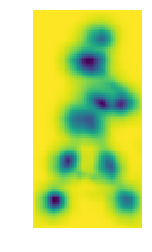

0140


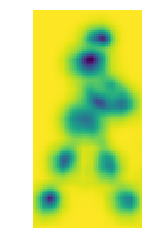

0141


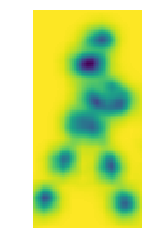

0142


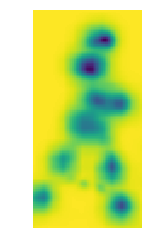

0143


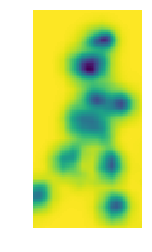

0144


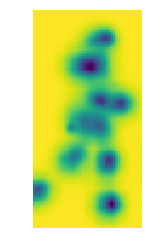

0145


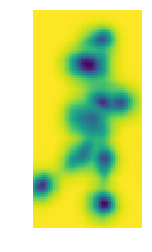

0146


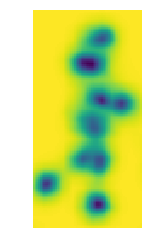

0147


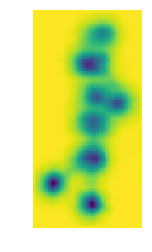

0148


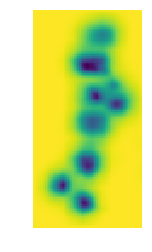

0149


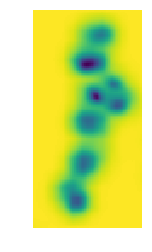

0150


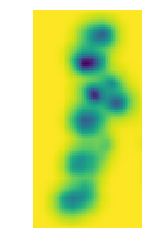

0151


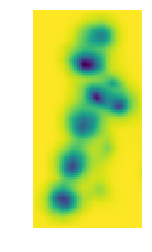

0152


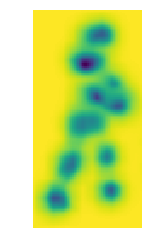

0153


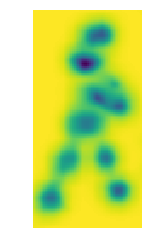

0154


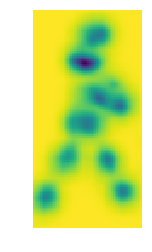

0155


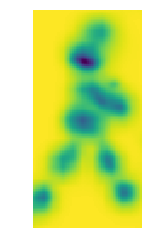

0156


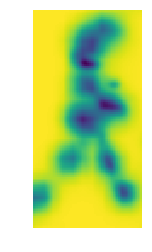

0001


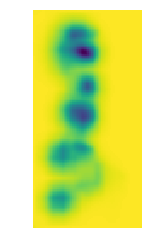

0002


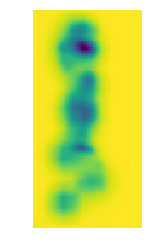

0003


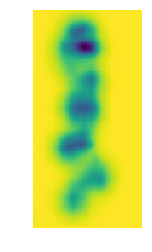

0004


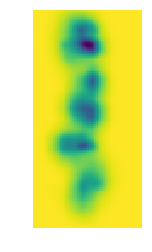

0005


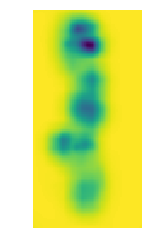

0006


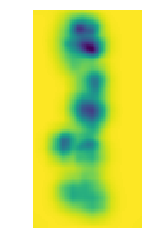

0007


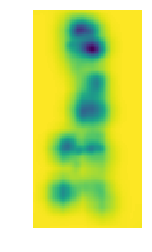

0008


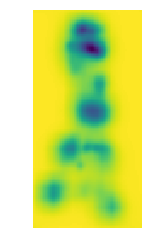

0009


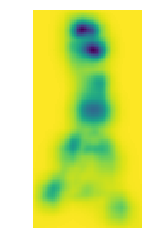

0010


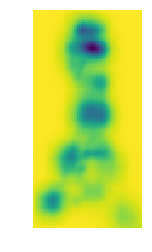

0011


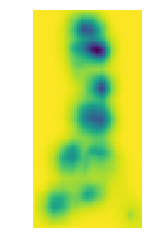

0012


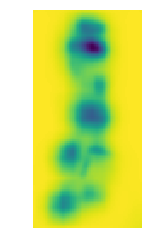

0013


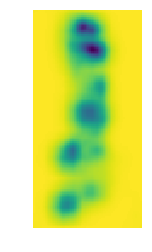

0014


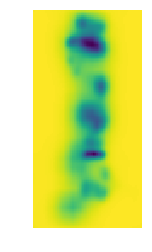

0015


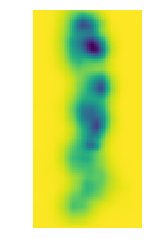

0016


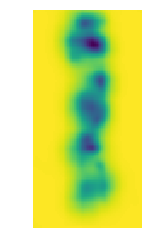

0017


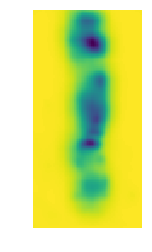

0018


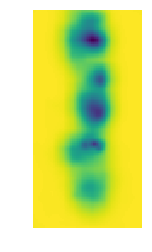

0019


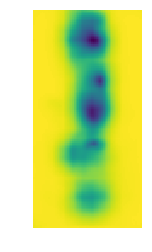

0020


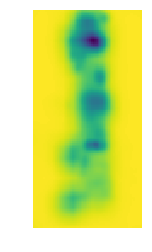

0021


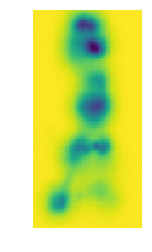

0022


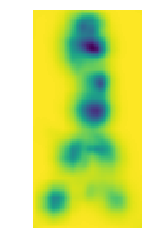

0023


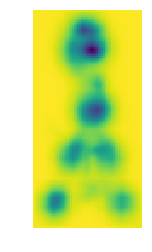

0024


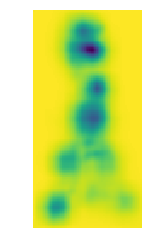

0025


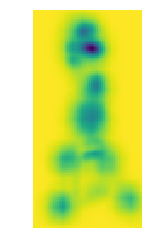

0026


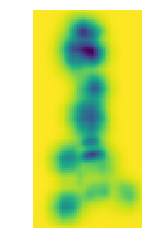

0027


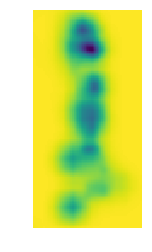

0028


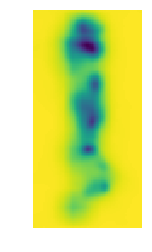

0029


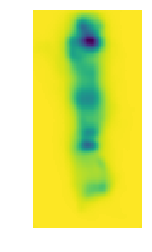

0030


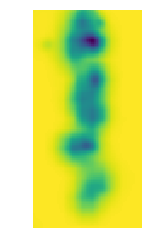

0031


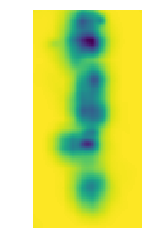

0032


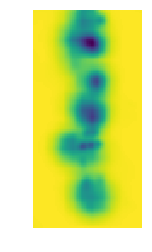

0033


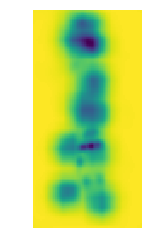

0034


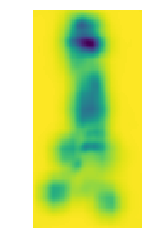

0035


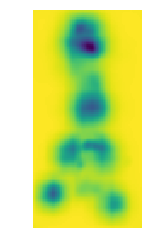

0036


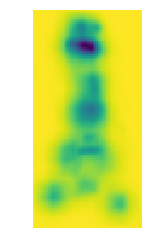

0037


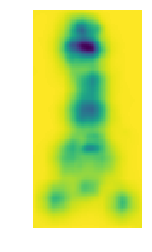

0038


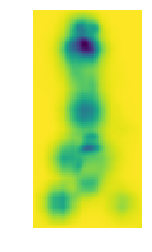

0039


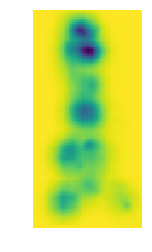

0040


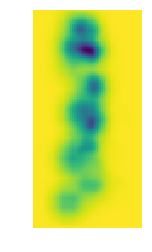

0041


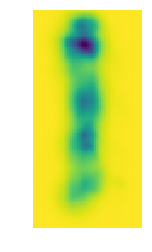

0042


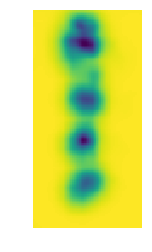

0043


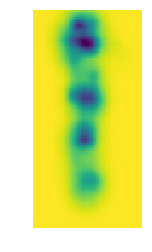

0044


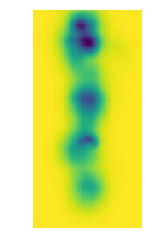

0045


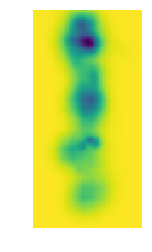

0046


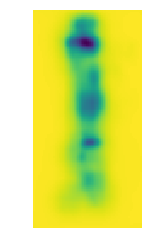

0047


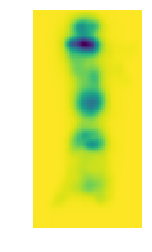

0048


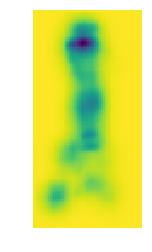

0049


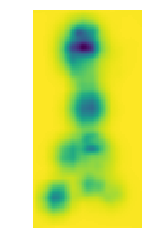

0050


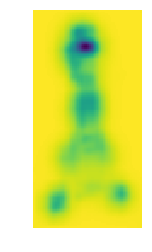

0051


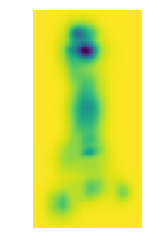

0052


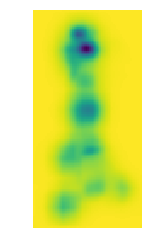

0053


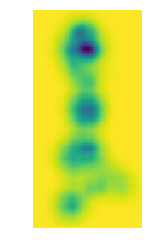

0054


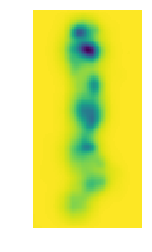

0055


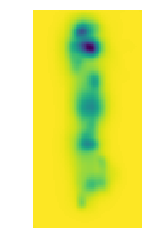

0056


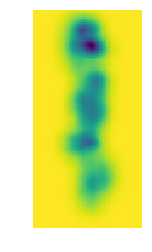

0057


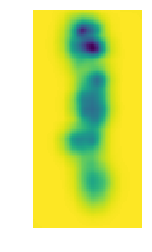

0058


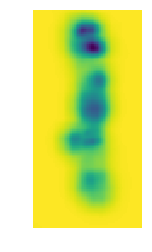

0059


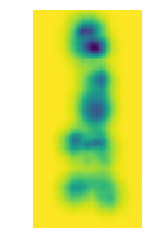

0060


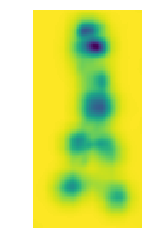

0061


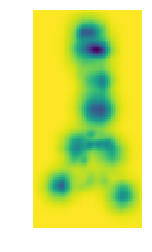

0062


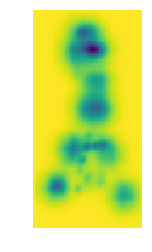

0063


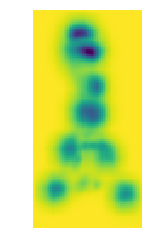

0064


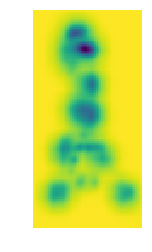

0065


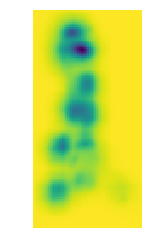

0066


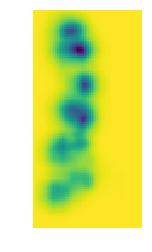

0067


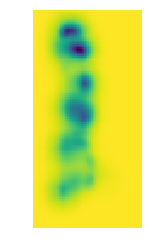

0068


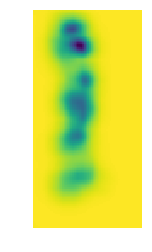

0069


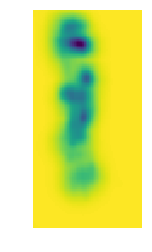

0070


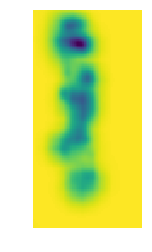

0071


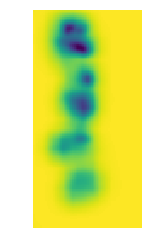

0072


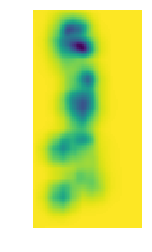

0073


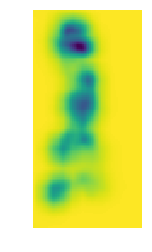

0074


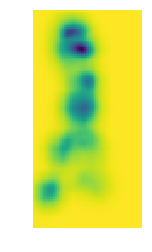

0075


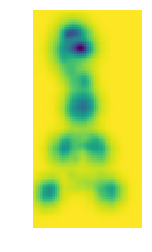

0076


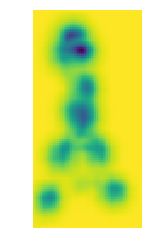

0077


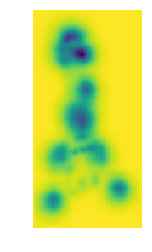

0078


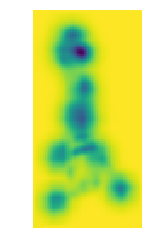

0079


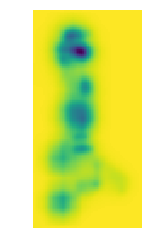

0080


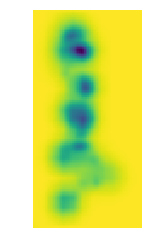

0081


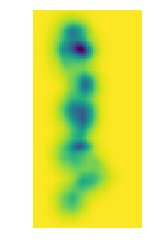

0082


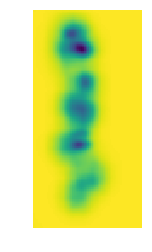

0083


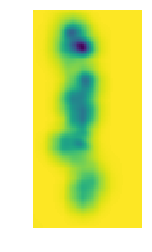

0084


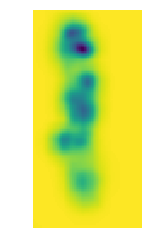

0085


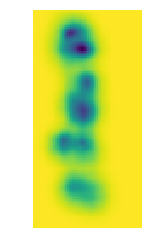

0086


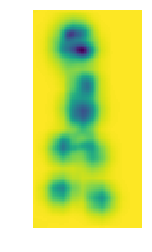

0087


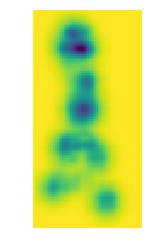

0088


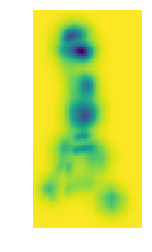

0089


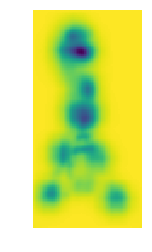

0090


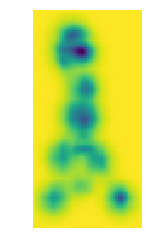

0091


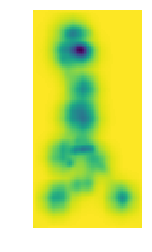

0092


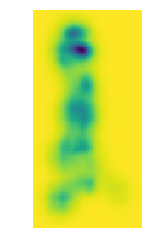

0093


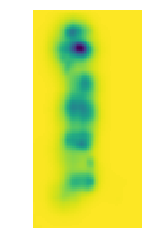

0094


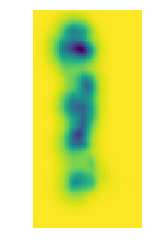

0095


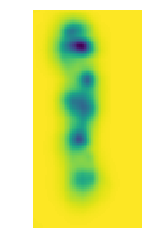

0096


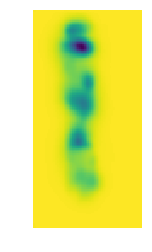

0097


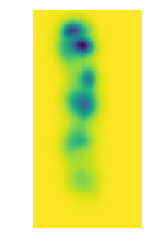

0098


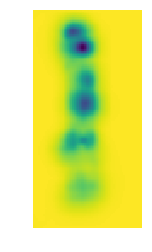

0099


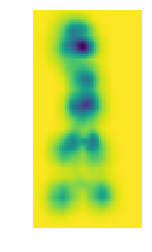

0100


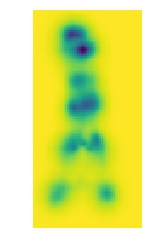

0101


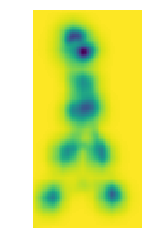

0102


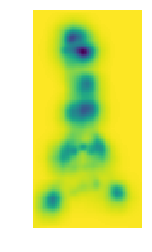

0103


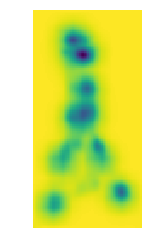

0104


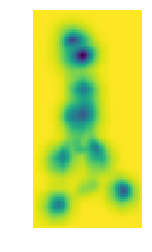

0105


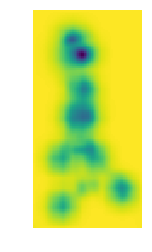

0106


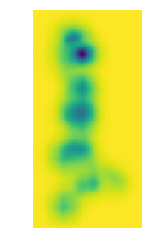

0107


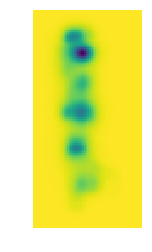

0108


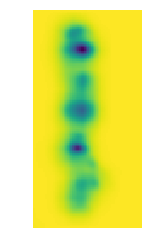

0109


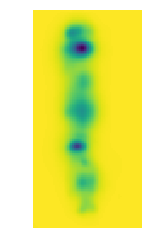

0110


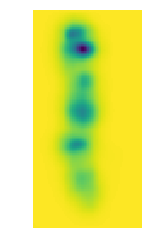

0111


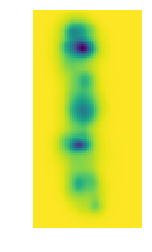

0112


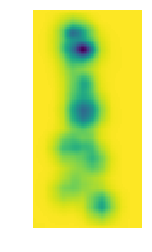

0113


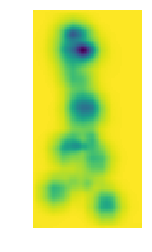

0114


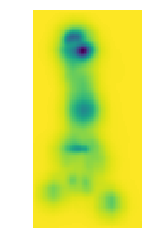

0115


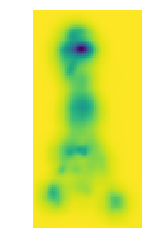

0116


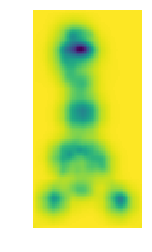

0117


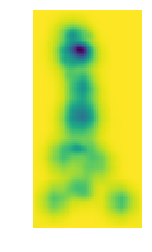

0118


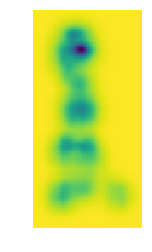

0119


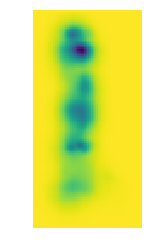

0120


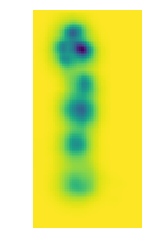

0121


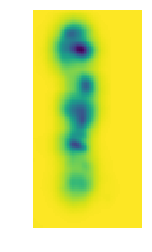

0122


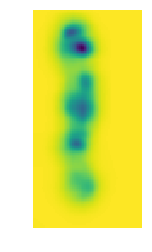

0123


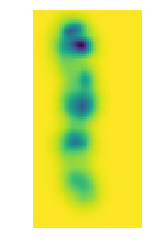

0124


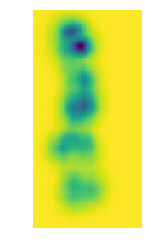

0125


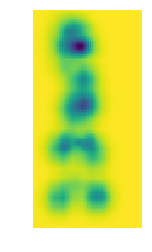

0126


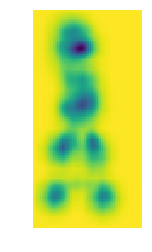

0127


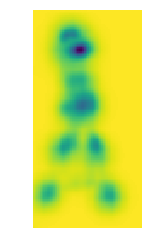

0128


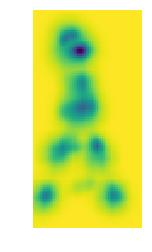

0129


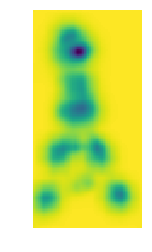

0130


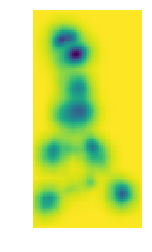

0131


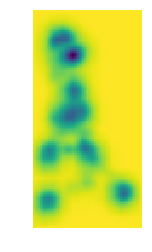

In [ ]:
import scipy.io

flag=2    #flag=1  ilids   flag=2 prid2011  

if flag == 1:
    ImgForder = '/home/liu/Dataset/i-LIDS-VID/sequences/'#/i-LIDS-VID/sequences/cam1/'#/datasets/market/Market-1501-v15.09.15/bounding_box_train/'
    HeatmapForder = './sample_image/train_heatmap/'
    MaskForder = './sample_image/train_mask/'
    DilateForder = './sample_image/train_dialte/'
    saveImgForder='./sample_image/train_save/'
    dotForder = './sample_image/train_dot/'
elif flag == 2:
    ImgForder = '/home/liu/Dataset/PRID2011/multi_shot/'#/i-LIDS-VID/sequences/cam1/'#/datasets/market/Market-1501-v15.09.15/bounding_box_train/'
    HeatmapForder = './sample_image/prid2011/train_heatmap/'
    MaskForder = './sample_image/prid2011/train_mask/'
    DilateForder = './sample_image/prid2011/train_dialte/'
    saveImgForder='./sample_image/prid2011/train_save/'
    dotForder = './sample_image/prid2011/train_dot/'



fileList = sorted(os.listdir(ImgForder))
for camname in fileList:
    campath=os.path.join(ImgForder,camname)
    
    if flag == 1:
        newcamname=campath[-4:]
    elif flag == 2:
        newcamname=campath[-5:]
        
    camHeatmapForder=HeatmapForder+newcamname
        #print(newHeatmapForder)
    camMaskForder=MaskForder+newcamname
    camDilateForder=DilateForder+newcamname
    camsaveImgForder=saveImgForder+newcamname
    camdotForder=dotForder+newcamname
    
    
    if not os.path.isdir(camHeatmapForder):
            os.makedirs(camHeatmapForder)
    if not os.path.isdir(camMaskForder):
            os.makedirs(camMaskForder)
    if not os.path.isdir(camDilateForder):
            os.makedirs(camDilateForder)
    if not os.path.isdir(camsaveImgForder):
            os.makedirs(camsaveImgForder)
    if not os.path.isdir(camdotForder):
            os.makedirs(camdotForder)
    
    documentList = sorted(os.listdir(campath))
    #print(documentList)
    for fname in documentList:#[3787:3789]:
        #print(fname)
        #documentList=documentList+'/'
        path = campath+'/'+fname #os.path.join(documentList+'/',fname)
        #print(path)
        if flag == 1:
            pathname=path[-9:]
        elif flag == 2:
            pathname=path[-11:]
            #print(pathname)

        newHeatmapForder=camHeatmapForder+'/'+pathname
        #print(newHeatmapForder)
        newMaskForder=camMaskForder+'/'+pathname
        newDilateForder=camDilateForder+'/'+pathname
        newsaveImgForder=camsaveImgForder+'/'+pathname
        newdotForder=camdotForder+'/'+pathname

        if not os.path.isdir(newHeatmapForder):
            os.makedirs(newHeatmapForder)
        if not os.path.isdir(newMaskForder):
            os.makedirs(newMaskForder)
        if not os.path.isdir(newDilateForder):
            os.makedirs(newDilateForder)
        if not os.path.isdir(newsaveImgForder):
            os.makedirs(newsaveImgForder)
        if not os.path.isdir(newdotForder):
            os.makedirs(newdotForder)

        picList=sorted(os.listdir(path))
        #print(picList)
        for pname in picList:
            pathpic=os.path.join(path,pname)

            canvas = cv2.imread(pathpic)

            all_peaks,heatMap,subset,candidate = getMaskandHeat(pathpic)
            newpname=pname[:-4]
            print(newpname)
            plt.imshow(heatMap[:,:,18])
            plt.show()
            plt.axis('off')
            plt.savefig(newHeatmapForder+'/'+newpname+'_heat.png')
            #pdb.set_trace()
            background = np.zeros((128,64,1), np.uint8)
            for i in range(18):
                for j in range(len(all_peaks[i])):
                    cv2.circle(background, all_peaks[i][j][0:2], 4, (255,255,255), thickness=-1)
                    cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
            scipy.io.savemat(newHeatmapForder+'/'+newpname+'.mat',{'heatMap':heatMap[:,:,18]})
            #np.save(newHeatmapForder+'/'+newpname+'.npy',heatMap)
            #print(heatMap)

            #cv2.imwrite(newdotForder+'/'+newpname+'.jpg',background) 

            stickwidth = 4
            '''
            for i in range(17):
                for n in range(len(subset)):
                    index = subset[n][np.array(limbSeq[i])-1]
                    if -1 in index:
                        continue
                    cur_canvas = canvas.copy()
                    Y = candidate[index.astype(int), 0]
                    X = candidate[index.astype(int), 1]
                    mX = np.mean(X)
                    mY = np.mean(Y)
                    length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
                    angle = math.degrees(math.atan2(X[0] - X[1], Y[0] - Y[1]))
                    polygon = cv2.ellipse2Poly((int(mY),int(mX)), (int(length/2), stickwidth), int(angle), 0, 360, 1)
                    cv2.fillConvexPoly(cur_canvas, polygon, colors[i])
                    cv2.fillConvexPoly(background, polygon, (255,255,255))
                    canvas = cv2.addWeighted(canvas, 0.4, cur_canvas, 0.6, 0)
            '''


            #cv2.imwrite(newsaveImgForder+'/'+newpname+'.png',canvas)   #fname[:-4]
            
            #cv2.imwrite(newMaskForder+'/'+newpname+'.png',background) 
            #kernel = np.ones((5,5), np.uint8)
            #img_dialte = cv2.dilate(background, kernel, iterations=1)
            #cv2.imwrite(newDilateForder+'/'+newpname+'.png',img_dialte) 

In [ ]:
def rect_merge(new_rect,rectangle,mlist):
    import copy
    Myrect=copy.deepcopy(new_rect)
    left = 999
    up = 999
    right =0
    down =0
    
    mark =0
    
    for i in range( len(mlist) ):
        if len(rectangle[mlist[i]]) ==0:
            continue
        mark =1
        left =  min(left,rectangle[mlist[i]][0])
        up =    min(up,  rectangle[mlist[i]][1])
        right = max(right,rectangle[mlist[i]][2])
        down =  max(down,rectangle[mlist[i]][3])
    if mark==1:
        Myrect[mlist[0]] = [left,up,right,down]
    
    for i in range( len(mlist)-1 ):
        if len(rectangle[mlist[i+1]]) ==0:
            continue
        Myrect.remove(rectangle[mlist[i+1]])
        
    Myrect = [x for x in Myrect if x != []]
    
    return Myrect

def rect_adjust(rect,adX,adY):

    if len(rect) == 0:
        return rect
    left = rect[0]
    up = rect[1]
    right = rect[2]
    down = rect[3]

    temp = left-adX
    left = temp if temp>0 else 0                  


    temp = up-adY
    up = temp if temp>0 else 0

    temp = right+adX
http://localhost:8888/notebooks/ganscode/pytorch_Realtime_Multi-Person_Pose_Estimation-master/KeyPonit.ipynb#    right = temp if temp<64 else 64                  


    temp = down+adY
    down = temp if temp<128 else 128
    
    return [left,up,right,down]

In [ ]:
aaa = [[11, 14, 35, 24], [27, 13, 51, 22], [20, 0, 35, 22], [27, 0, 41, 22], [3, 16, 19, 45], [11, 16, 47, 64], [0, 37, 11, 56], [43, 13, 57, 41], [19, 13, 51, 65], [49, 33, 63, 60], [19, 14, 35, 65], [19, 57, 28, 93], [20, 85, 28, 125], [27, 14, 47, 64], [39, 56, 50, 93], [42, 85, 50, 118], [24, 0, 35, 22]]
print(len(aaa))
print(aaa)
bbb = rect_merge(aaa,aaa,[2,3,16])
print(len(bbb))
bbb

In [ ]:
"""
ImgForder = '/home/dsp411/zhou/datasets/market/Market-1501-v15.09.15/bounding_box_train/'
rectForder = './sample_image/Rect/'
colorForder = './sample_image/colorRect2/'

import random
randList = list(range(12936))
random.shuffle(randList)

limbSeq2 = [[2,3], [2,6],[2,15],[2,18], [3,4],[3,12], [4,5], [6,7],[6,9] ,[7,8], [2,9], [9,10], \
           [10,11], [2,12], [12,13], [13,14], [2,1], [1,15], [15,17], \
           [1,16], [16,18], [3,17], [6,18]]


fileList = sorted(os.listdir(ImgForder))
for ii in randList[:10]:
    fname = fileList[ii]
    print(fname)
    path = os.path.join(ImgForder, fname)
    canvas = cv2.imread(path)
    all_peaks,heatMap,subset,candidate = getMaskandHeat(path)


    
    
    rectangle =[]
    tempList = 0
    for i in range(17):
        tempList = 0
        for n in range(len(subset)):
            index = subset[n][np.array(limbSeq2[i])-1]
            if -1 in index:
                continue
                
            tempList = 1
            cur_canvas = canvas.copy()
            Y = candidate[index.astype(int), 0]
            X = candidate[index.astype(int), 1]
            if X[0] > X[1]:

                x1 = X[0]

                x0 = X[1]          
            else:

                x0 = X[0]                

                x1 = X[1]
                


            if Y[0] > Y[1]:

                y1 = Y[0]        

                y0 = Y[1] 
                

            else:

                y0 = Y[0]                

                y1 = Y[1]

            rectangle.append([int(y0),int(x0),int(y1),int(x1)])

            
        if tempList ==0:
            rectangle.append([])
    
    
    
    #pdb.set_trace()
    #print(rectangle)
    #head
    for pp in [2,3,16]:
        rectangle[pp] = rect_adjust(rectangle[pp],7,7)
    #body
    for pp in [0,1,5,8,10,13]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
    #arm
    for pp in [4,6,7,9]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
    #leg
    for pp in [11,12,14,15]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
        
    newRect = rect_merge(rectangle,rectangle,[2,3,16])
    newRect = rect_merge(newRect,rectangle,[0,1,5,8,10,13])
    

    
    np.save(rectForder+fname[:-4]+'_rect.npy',np.array(newRect) )
    print(newRect)
    for i in range(len(newRect)):
        cv2.rectangle(canvas,(newRect[i][0],newRect[i][1]),(newRect[i][2],newRect[i][3]),(colors[i]),1)
    cv2.imwrite(colorForder+fname[:-4]+'_rect.png',canvas) 
"""

In [ ]:

ImgForder = '/home/dsp411/zhou/datasets/market/Market-1501-v15.09.15/bounding_box_train/'
rectForder = './sample_image/Rect/'
colorForder = './sample_image/colorRect2/'



limbSeq2 = [[2,3], [2,6],[2,15],[2,18], [3,4],[3,12], [4,5], [6,7],[6,9] ,[7,8], [2,9], [9,10], \
           [10,11], [2,12], [12,13], [13,14], [2,1], [1,15], [15,17], \
           [1,16], [16,18], [3,17], [6,18]]


fileList = sorted(os.listdir(ImgForder))
for ii in range(12936):
    fname = fileList[ii]
    print(fname)

    path = os.path.join(ImgForder, fname)
    canvas = cv2.imread(path)

    all_peaks,heatMap,subset,candidate = getMaskandHeat(path)

    new_peaks =[]
    peaks=np.zeros((18,2))
    """
    for i in range(18):
        for j in range(len(all_peaks[i])):
            cv2.circle(background, all_peaks[i][j][0:2], 4, (255,255,255), thickness=-1)
            cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
    np.save(HeatmapForder+fname[:-4]+'_heat.npy',heatMap)            
    cv2.imwrite(dotForder+fname[:-4]+'_back.jpg',background) 
    """

    for i in range(18):
        map = gaussian_filter(heatMap[:,:,i], sigma=3)
        x = ( np.unravel_index(map.argmax(), map.shape))
        new_peaks.append(x[::-1])
        #%debug
        peaks[i,0] = x[::-1][0]
        peaks[i,1] = x[::-1][1]


    
    
    rectangle =[]
    tempList = 0
    New_peaks = np.array(new_peaks)
    for i in range(17):
        tempList = 0
        for n in range(1):
            index = np.array(limbSeq2[i])-1
                
            tempList = 1
            cur_canvas = canvas.copy()

            Y = peaks[index.astype(int), 0]
            X = peaks[index.astype(int), 1]
            if X[0] > X[1]:

                x1 = X[0]

                x0 = X[1]          
            else:

                x0 = X[0]                

                x1 = X[1]
                


            if Y[0] > Y[1]:

                y1 = Y[0]        

                y0 = Y[1] 
                

            else:

                y0 = Y[0]                

                y1 = Y[1]

            rectangle.append([int(y0),int(x0),int(y1),int(x1)])

            
        if tempList ==0:
            rectangle.append([])
    
    
    
    #pdb.set_trace()
    #print(rectangle)
    #head
    for pp in [2,3,16]:
        rectangle[pp] = rect_adjust(rectangle[pp],7,7)
    #body
    for pp in [0,1,5,8,10,13]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
    #arm
    for pp in [4,6,7,9]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
    #leg
    for pp in [11,12,14,15]:
        rectangle[pp] = rect_adjust(rectangle[pp],10,10)
        
    newRect = rect_merge(rectangle,rectangle,[2,3,16])
    newRect = rect_merge(newRect,rectangle,[0,1,5,8,10,13])
    

    
    np.save(rectForder+fname[:-4]+'_rect.npy',np.array(newRect) )
    print(newRect)
    for i in range(len(newRect)):
        cv2.rectangle(canvas,(newRect[i][0],newRect[i][1]),(newRect[i][2],newRect[i][3]),(colors[i]),1)
    cv2.imwrite(colorForder+fname[:-4]+'_rect.png',canvas) 


In [ ]:
for i in range(18):
    for j in range(len(all_peaks[i])):
        cv2.circle(background, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
        cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
    cv2.imwrite('background'+str(i)+'.png',background) 

stickwidth = 7
cv2.imwrite('result2.png',canvas)
#cv2.imwrite('background2.png',background) 
#%debug
for i in range(17):
    for n in range(len(subset)):
        index = subset[n][np.array(limbSeq[i])-1]
        if -1 in index:
            continue
        cur_canvas = canvas.copy()
        #pdb.set_trace()
        Y = candidate[index.astype(int), 0]
        X = candidate[index.astype(int), 1]

        
        mX = np.mean(X)
        mY = np.mean(Y)
        length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
        angle = math.degrees(math.atan2(X[0] - X[1], Y[0] - Y[1]))
        polygon = cv2.ellipse2Poly((int(mY),int(mX)), (int(length/2), stickwidth), int(angle), 0, 360, 1)

        if X[0] > X[1]:
            x1 = X[0]+3
            x0 = X[1]-3           
        else:
            x0 = X[0]-3
            x1 = X[1]+3
            
        if Y[0] > Y[1]:
            y1 = Y[0]+3           
            y0 = Y[1]-3
        else:
            y0 = Y[0]-3
            y1 = Y[1]+3
        #pdb.set_trace()
        cv2.rectangle(background,(int(y0),int(x0)),(int(y1),int(x1)),(colors[i]),1)
        cv2.imwrite('Rectangle'+str(i)+'.png',background) 
        rectangle.append([int(y0),int(x0),int(y1),int(x1)])
        cv2.fillConvexPoly(cur_canvas, polygon, colors[i])
        #cv2.fillConvexPoly(background, polygon, (255,255,255))
        canvas = cv2.addWeighted(canvas, 0.4, cur_canvas, 0.6, 0)

#Parallel(n_jobs=1)(delayed(handle_one)(i) for i in range(18))

np.save('rectangle.npy',np.array(rectangle) )
cv2.imwrite('result3.png',canvas)   
cv2.imwrite('background33.png',background) 